In [24]:
URL='https://raw.githubusercontent.com/jephianlin/mr_JG/py2/'

In [25]:
files=['Zq_c.pyx','Zq.py','zero_forcing_64.pyx','zero_forcing_wavefront.pyx','minrank.py', 'inertia.py']

In [4]:
for f in files:
    print("Loading %s..."%f);
    load(URL+f)

Loading Zq_c.pyx...


Compiling /home/john/.sage/temp/john-1878/10010/tmp_naO1UI.pyx...


Loading Zq.py...


Compiling /home/john/.sage/temp/john-1878/10010/tmp_ojwekb.pyx...


Loading zero_forcing_64.pyx...
Loading zero_forcing_wavefront.pyx...


Compiling /home/john/.sage/temp/john-1878/10010/tmp_ZjWWeY.pyx...


Loading minrank.py...
Loading inertia.py...


In [5]:
# F-2 additional function for zero forcing number using brute_force
def Z(g):
    z=len(zero_forcing_set_bruteforce(g))
    return z

In [6]:
# F-3 main function cell zero forcing number loop graphs
# skew forcing uses no loops
# written by Jephian Lin
def gzerosgame(g,F=[],B=[]):
	"""
	Return the derived set for a given graph g with set of banned edges B and a initial set of vertices. The derived set is given by doing generalized zero forcing process. That is, if y is the only white neighbor of x and xy is not banned, then x could force y into black.

	Input:
		g: a simple graph
		F: a list of vertices of g
		B: a list of tuples representing banned edges of g

	Output:
		A set of black vertices when zero forcing process stops.

	Examples:
		sage: gzerosgame(graphs.PathGraph(5),[0])
		set([0, 1, 2, 3, 4])
		sage: gzerosgame(graphs.PathGraph(5),[0],[(1,2)])
		set([0, 1])
	"""
	S=set(F) # suspicuous vertices
	Black_vertices=set(F) # current black vertices
	again=1 # iterate again or not
	while again==1:
		again=0
		for x in S:
			N=set(g.neighbors(x))
			D=N.difference(Black_vertices) # set of white neighbors
			if len(D)==1:
				for v in D:
					y=v # the only white neighbor
				if (((x,y) in B)==False) and (((y,x) in B)==False):
					again=1
					S.remove(x)
					S.add(y)
					Black_vertices.add(y)
				break
	return(Black_vertices)

def gZ_leq(graph, support=[], bannedset=[],i=None):
	"""
	For a given graph with support and banned set, if there is a zero forcing set of size i then return it; otherwise return False.

	Input:
		graph: a simple graph
		support: a list of vertices of g
		bannedset: a list of tuples representing banned edges of graph
		i: an integer, the function check gZ <= i or not

	Output:
		if F is a zero forcing set of size i and support is a subset of F, then return F
		False otherwise

	Examples:
		sage: gZ_leq(graphs.PathGraph(5),[],[],1)
		set([0])
		sage: gZ_leq(graphs.PathGraph(5),[],[(0,1)],1) 
		False
	"""
	if i < len(support):
#		print 'i cannot less than the cardinality of support'
		return False
	j=i-len(support) # additional number of black vertices
	VX=graph.vertices()
	order=graph.order()
	for y in support:
		VX.remove(y)
	# VX is the vertices outside support now
	for subset in Subsets(VX,j):
		test_set=set(support).union(subset) # the set is tested to be a zero forcing set
		outcome=gzerosgame(graph, test_set, bannedset)
		if len(outcome)==order:
			return test_set
	return False

def find_gzfs(graph, support=[], bannedset=[], upper_bound=None, lower_bound=None):
	"""
	For a given graph with support and banned set, return the an optimal generalized zero forcing set. If upper_bound is less than the generalized zero forcing number then return ['wrong']. If lower_bound is greater than the generalized zero forcing number then the return value will not be correct

	Input:
		graph: a simple graph
		support: a list of vertices of g
		bannedset: a list of tuples representing banned edges of graph
		upper_bound: an integer supposed to be an upper bound of gZ. 
		lower_bound: an integer supposed to be a lower bound of gZ. The two bounds may shorten the computation time. But one may leave it as default value if one is not sure.

	Output:
		if F is an optimal zero forcing set of size i then return F. If upper_bound is less than the general zero forcing number then return ['wrong'].

	Examples:
		sage: find_gzfs(graphs.PathGraph(5))
		set([0])
		sage: find_gzfs(graphs.PathGraph(5),[1],[(3,2)])
		set([0, 1, 3])
	"""

	VX=graph.vertices()
	order=graph.order()
	s=len(support)
	for y in support:
		VX.remove(y)
	# VX is the vertices outside support now
	if upper_bound==None:
		upper_bound=order # the default upper bound
	if lower_bound==None:
		lower_bound=len(VX) # temporary lower bound
		for v in VX:
			N=set(graph.neighbors(v))
			D=N.difference(support)
			lower_bound=min([lower_bound,len(D)])
		for v in support:
			N=set(graph.neighbors(v))
			D=N.difference(support)
			lower_bound=min([lower_bound,len(D)-1])
		lower_bound=lower_bound+s # the default lower bound
	i=upper_bound
	find=1 # does sage find a zero forcing set of size i
	outcome=['wrong'] # default outcome
	while i>=lower_bound and find==1:
		find=0
		leq=gZ_leq(graph, support, bannedset,i) # check gZ <= i or not
		if leq!=False:
			outcome=leq
			find=1
			i=i-1
	return outcome

def find_gZ(graph, support=[], bannedset=[], upper_bound=None, lower_bound=None):
	"""
	For a given graph with support and banned set, return the zero. upper_bound and lower_bound could be left as default value if one is not sure.

	Input:
		graph: a simple graph
		support: a list of vertices of g
		bannedset: a list of tuples representing banned edges of graph
		upper_bound: an integer supposed to be an upper bound of gZ. 
		lower_bound: an integer supposed to be a lower bound of gZ. The two bounds may shorten the computation time. But one may leave it as default value if one is not sure.

	Output:
		the generalized zero forcing number

	Examples:
		sage: find_gZ(graphs.PathGraph(5))            
		1
		sage: find_gZ(graphs.PathGraph(5),[1],[(3,2)])
		3
	"""
	return len(find_gzfs(graph, support, bannedset, upper_bound, lower_bound))

def X(g):
	"""
	For a given graph g, return the verices set X of a part of the bipartite used to compute the exhaustive zero forcing number.

	Input:
		g: a simple graph

	Output:
		a list of tuples ('a',i) for all vertices i of g

	Examples:
		sage: X(graphs.PathGraph(5))
		[('a', 0), ('a', 1), ('a', 2), ('a', 3), ('a', 4)]
	"""
	return [('a',i) for i in g.vertices()]

def Y(g):
	"""
	For a given graph g, return the verices set Y of the other part of the bipartite used to compute the exhaustive zero forcing number.

	Input:
		g: a simple graph

	Output:
		a list of tuples ('b',i) for all vertices i of g

	Examples:
		sage: Y(graphs.PathGraph(5))
		[('b', 0), ('b', 1), ('b', 2), ('b', 3), ('b', 4)]
	"""
	return [('b',i) for i in g.vertices()]

def tilde_bipartite(g,I=[]):
	"""
	For a given graph g and an index set I, return the bipartite graph \widetilde{G}_I used to compute the exhaustive zero forcing number.

	Input:
		g: a simple graph
		I: a list of vertices of g

	Output:
		the bipartite graph \widetilde{G}_I

	Examples:
		sage: h=tilde_bipartite(graphs.PathGraph(5),[1])
		sage: h.vertices()
		[('a', 0), ('a', 1), ('a', 2), ('a', 3), ('a', 4), ('b', 0), ('b', 1), ('b', 2), ('b', 3), ('b', 4)]
		sage: h.edges()
		[(('a', 0), ('b', 1), None), (('a', 1), ('b', 0), None), (('a', 1), ('b', 1), None), (('a', 1), ('b', 2), None), (('a', 2), ('b', 1), None), (('a', 2), ('b', 3), None), (('a', 3), ('b', 2), None), (('a', 3), ('b', 4), None), (('a', 4), ('b', 3), None)]
	"""
	E0=[(('a',i), ('b',i)) for i in I] # edges given by I
	E1=[] # invariant edges
	for i in g.vertices():
		for j in g.neighbors(i):
			E1.append((('a',i),('b',j)))
	h=Graph()
	h.add_vertices(X(g))
	h.add_vertices(Y(g)) 
	h.add_edges(E0)
	h.add_edges(E1) # h=(X union Y, E0 union E1)
	return h

def find_EZ(g,bound=None):
	"""
	For a given graph g, return the exhaustive zero forcing number of g. A given bound may shorten the computation.

	Input:
		g: a simple graph
		bound: a integer as an upper bound. It could be left as default value if one is not sure.

	Output:
		the exhaustive zero forcing number (EZ) of g

	Examples:
		sage: find_EZ(graphs.PathGraph(5))
		1
		sage: h=graphs.CycleGraph(5)
		sage: h.add_vertices([5,6,7,8,9])
		sage: h.add_edges([(0,5),(1,6),(2,7),(3,8),(4,9)])
		sage: find_EZ(h) # the EZ of a 5-sun
		2
	"""
	order=g.order()
	Z=find_gZ(g) # without support and banned set, the value is the original zero forcing number
	if bound==None:
		bound=Z # default upper bound
	gZ_bound=bound+order 
	V=set(g.vertices())
	e=-1 # temporary output
	for I in Subsets(V):
		leq=gZ_leq(tilde_bipartite(g,I),Y(g),[],e) # this avoid abundant computation
		if leq==False:
			e=find_gZ(tilde_bipartite(g,I),Y(g),[],gZ_bound,e+1)
			# in this case, we already know e+1-order<=gZ-order<=bound and so e+1<=gZ<=gZ_bound
		if e==gZ_bound:
			break
	return e-order # EZ=max-order

def find_loopedZ(g,I):
    """
    For a given graph g and the index of the vertices with loops, return the zero forcing number of this looped graph.
    
    Input:
        g: a simple graph, the underlying graph of the looped graph.
        I: the index of the vertices with loops.
    
    Output:
        the zero forcing number of this looped graph.
        
    Examples:
        sage: g = Graph({0:[1],1:[0]});
        sage: I=[0,1];
        sage: find_loopedZ(g,I)
        1
        sage: g = Graph({0:[1],1:[0]});
        sage: I=[0];
        sage: find_loopedZ(g,I)
        0    
    """
    return find_gZ(tilde_bipartite(g,I),Y(g),[])-g.order()

def Zskew(g):    # report Z_-(g)
    return find_loopedZ(g,[])

In [7]:
# F-10 Function for skew propagation time of a set
# written by Steve Butler
def prop_time_unlooped(G,S):
    """
    Determine the propagation time of S in G assuming
    all the vertices are unlooped.
    """
    V=set(G.vertices())
    count = 0
    done = False
    active = set(S)
    filled = set(S)
    for v in V:
        N=set(G.neighbors(v))
        if v in active and N.issubset(filled):
            active.remove(v)
        if (v not in active) and (len(N.intersection(filled)) == G.degree(v)-1):
            active.add(v)
    
    while not done:
        done = True
        new_active = copy(active)
        new_filled = copy(filled)

        for v in active:
            N=set(G.neighbors(v))
            if len(N.intersection(filled)) == G.degree(v)-1:
                if done:
                    done = False
                    count += 1
                N.symmetric_difference_update(N.intersection(filled))
                u=N.pop()
                new_active.remove(v)
                new_active.add(u)
                new_filled.add(u)

        active = copy(new_active)
        filled = copy(new_filled)
        for v in V:
            N=set(G.neighbors(v))
            if v in active and N.issubset(filled):
                active.remove(v)
            if (v not in active) and (len(N.intersection(filled)) == G.degree(v)-1):
                active.add(v)
    if len(filled)==len(V):
        return count
    return -1

In [8]:
def ptsk(G,k):
    ord=G.order()
    V = G.vertices()
    S = subsets(V,k)
    ptm = -1
    for s in S:
        
        ptms=prop_time_unlooped(G,s)
        if (ptms > -1):
            print s

    return ptm

In [9]:
def ptsk_TEgraph(G,k):
    ord=G.order()
    V = G.vertices()
    S = subsets(V,k)
    TEV = []
    TEE = []
    ptm = -1
    for s in S:
        
        ptms=prop_time_unlooped(G,s)
        if (ptms > -1):
            TEV.append(s)
            
            
    N = len(TEV)
                  
    for i in range(N):
            
        for j in range(i+1,N):
            L = len(list(set(TEV[i]) & set(TEV[j])))
                
            if L == k-1:
                TEE.append((TEV[i],TEV[j]))
    
    
    TEG = Graph([TEV,TEE])
                
    #print len(TEV)   
    #print
    #print N
    #print
    #print TEV 
    #print
    #print len(TEE)
    return TEG

    


In [10]:
def ptsk_TSgraph(G,k):
    ord=G.order()
    V = G.vertices()
    S = subsets(V,k)
    TSV = []
    TSE = []
    ptm = -1
    for s in S:
        
        ptms=prop_time_unlooped(G,s)
        if (ptms > -1):
            TSV.append(s)
            
            
    N = len(TSV)
                  
    for i in range(N):
            
        for j in range(i+1,N):
            L = len(list(set(TSV[i]) & set(TSV[j])))
                
            #if L == k-1:
              #  TSN = set(TSV[j]) - (set(TSV[i]) & set(TSV[j]))
               # for m in TSN:
                 #   for q in TSV[i]:
                       # if m in G.neighbors(q):
                          #  TSE.append((TSV[i],TSV[j]))
            if L == k-1:
                TSN = set(TSV[j]) - (set(TSV[i]) & set(TSV[j]))
                for m in TSN:
                    for q in list(set(TSV[i]) - (set(TSV[i]) & set(TSV[j]))):
                        if m in G.neighbors(q):
                            TSE.append((TSV[i],TSV[j]))
    
    
    TSG = Graph([TSV,TSE])
                
    #print len(TSV)   
    #print
    #print N
    #print
    #print TSV 
    #print
    #print len(TSE)
    return TSG

    


In [11]:
# gives graph for each step in the skew zero forcing of a graph given and initial set
# based on code written by Steve Butler
def ptuz_graphs(G,S):
    """
    Determine the propagation time of S in G assuming
    all the vertices are unlooped.
    """
    V=set(G.vertices())
    count = 0
    done = False
    active = set(S)
    filled = set(S)
    #G.show(partition=[list(set(G.vertices()).difference(set(S))),S])
    G.graphplot(vertex_colors={'#FFFFFF': list(set(G.vertices()).difference(set(S))), '#4466CD': S}).show()
    for v in V:
        N=set(G.neighbors(v))
        if v in active and N.issubset(filled):
            active.remove(v)
        if (v not in active) and (len(N.intersection(filled)) == G.degree(v)-1):
            active.add(v)
    
    while not done:
        done = True
        new_active = copy(active)
        new_filled = copy(filled)

        for v in active:
            N=set(G.neighbors(v))
            if len(N.intersection(filled)) == G.degree(v)-1:
                if done:
                    done = False
                    count += 1
                N.symmetric_difference_update(N.intersection(filled))
                u=N.pop()
                new_active.remove(v)
                new_active.add(u)
                new_filled.add(u)

        active = copy(new_active)
        filled = copy(new_filled)
        unfilled=set(G.vertices()).difference(set(filled))
        
        
        if len(filled) != len(V):
            #P=[list(unfilled),list(filled)]
            #G.show(partition=P)
            G.graphplot(vertex_colors={'#FFFFFF': unfilled, '#4466CD': filled}).show()
        
        for v in V:
            N=set(G.neighbors(v))
            if v in active and N.issubset(filled):
                active.remove(v)
            if (v not in active) and (len(N.intersection(filled)) == G.degree(v)-1):
                active.add(v)
    if len(filled)==len(V):
        #G.show(partition=[[],V])
        G.graphplot(vertex_colors={'#FFFFFF': [], '#4466CD': V}).show()
        return count
    
    
    return -1
   

In [12]:
from sage.graphs.connectivity import connected_components
from sage.graphs.connectivity import connected_components_sizes

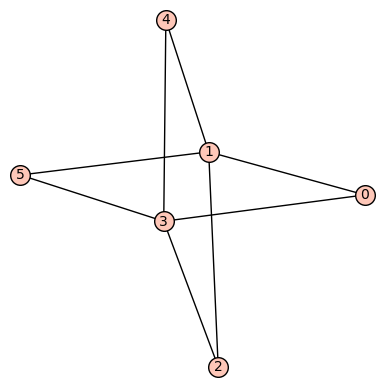

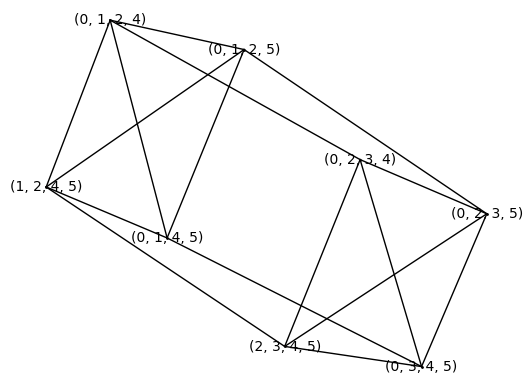

In [26]:
G=Graph({0:[1,3],1:[2,4,5],2:[3],3:[4,5]})
G.show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

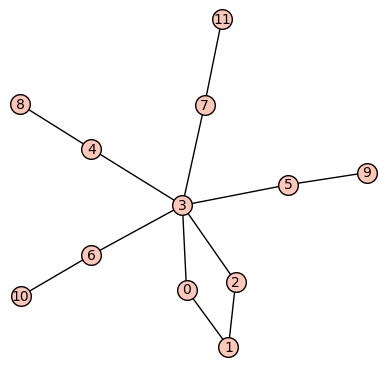

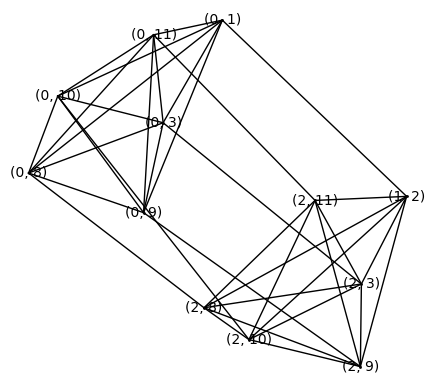

In [19]:
G=Graph({0:[1,3],1:[2],2:[3],3:[4,5,6,7],4:[8],5:[9],6:[10],7:[11]})
G.show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

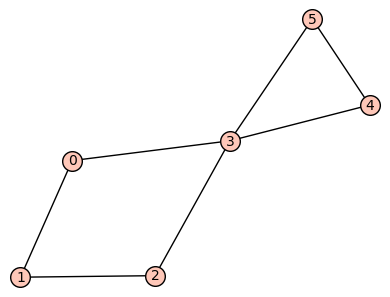

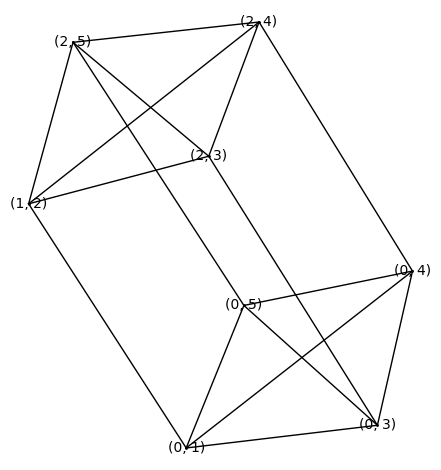

In [13]:
G=Graph({0:[1,3],1:[2],2:[3],3:[4,5],4:[5]})
G.show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

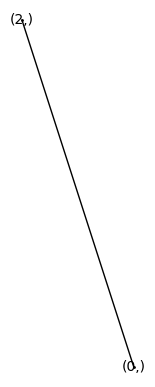

In [13]:
G=graphs.PathGraph(3)
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

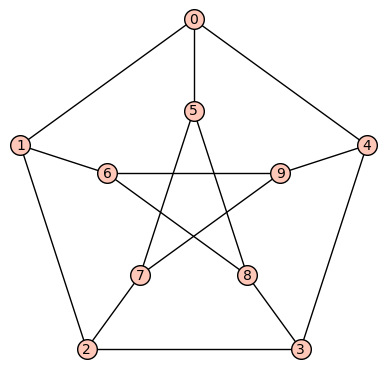

[(0, 1, 2, 4), (0, 1, 2, 5), (1, 2, 3, 4), (0, 1, 2, 7), (1, 2, 3, 5), (0, 1, 2, 8), (0, 2, 3, 4), (1, 2, 3, 6), (0, 1, 2, 9), (0, 2, 3, 7), (1, 2, 3, 8), (0, 1, 3, 4), (0, 2, 3, 8), (1, 2, 3, 9), (0, 1, 3, 5), (0, 1, 3, 6)]


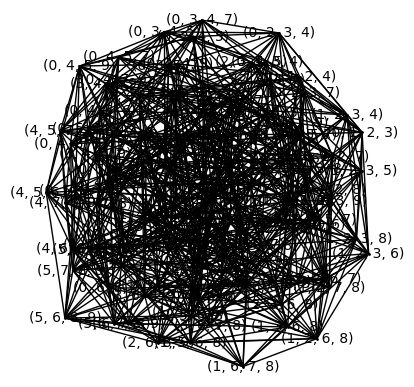

In [17]:
G=graphs.GeneralizedPetersenGraph(5,2)
G.show()
print ptsk_TEgraph(G,Zskew(G)).neighbors((0,1,2,3))
#print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

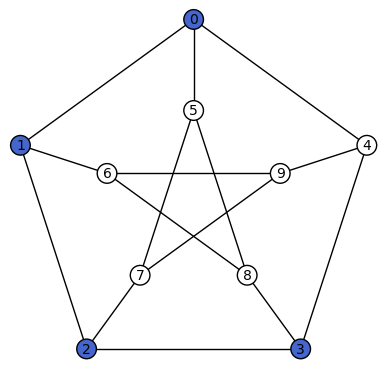

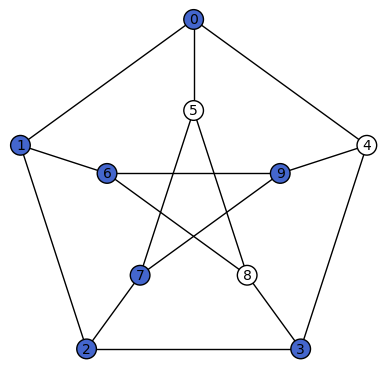

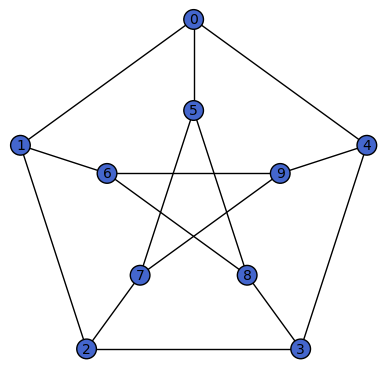

2

In [15]:
G=graphs.GeneralizedPetersenGraph(5,2)
ptuz_graphs(G,(0,1,2,3))

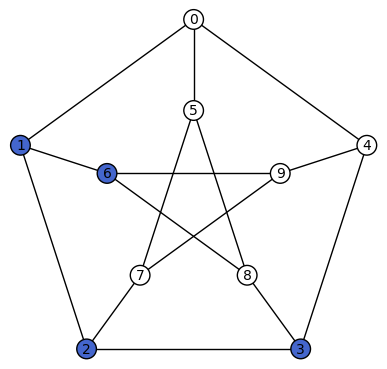

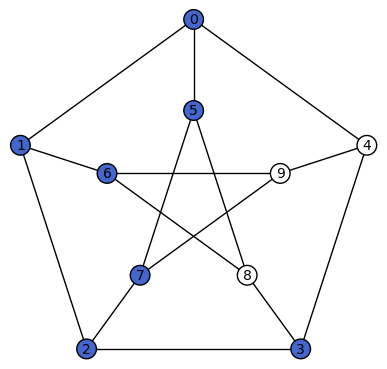

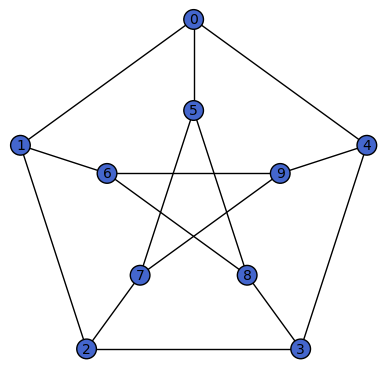

2

In [19]:
G=graphs.GeneralizedPetersenGraph(5,2)
ptuz_graphs(G,(1,2,3,6))

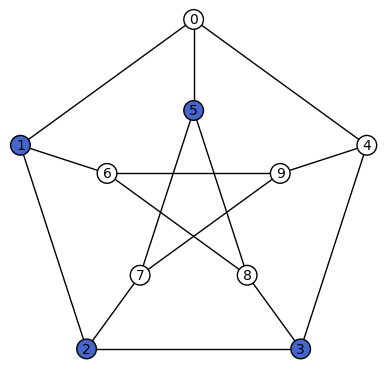

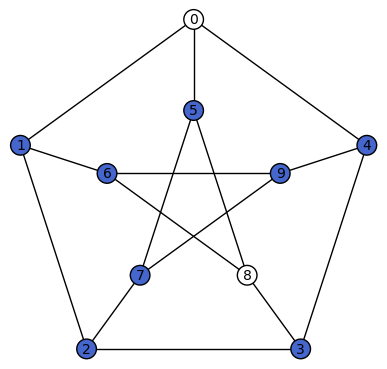

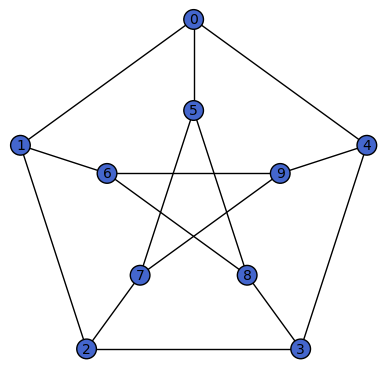

2

In [20]:
G=graphs.GeneralizedPetersenGraph(5,2)
ptuz_graphs(G,(1,2,3,5))

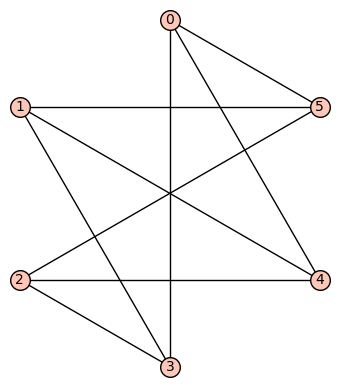

[(0, 1, 3, 4), (0, 1, 3, 5), (0, 1, 4, 5), (0, 2, 3, 4), (0, 2, 3, 5), (0, 2, 4, 5), (1, 2, 3, 4), (1, 2, 3, 5), (1, 2, 4, 5)]


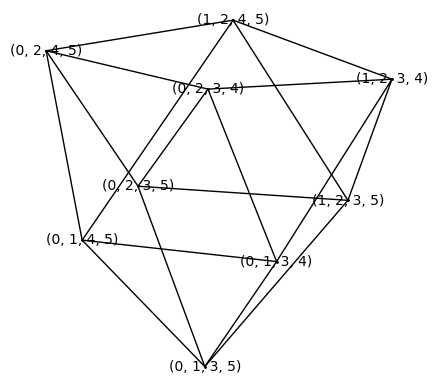

In [29]:
G=graphs.TuranGraph(6,2)
G.plot(layout='circular').show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

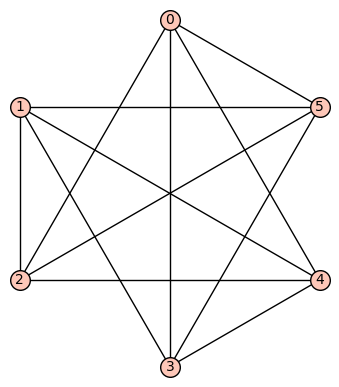

[(0, 1, 2, 4), (0, 1, 2, 5), (0, 1, 3, 4), (0, 1, 3, 5), (0, 2, 3, 4), (0, 2, 3, 5), (0, 2, 4, 5), (0, 3, 4, 5), (1, 2, 3, 4), (1, 2, 3, 5), (1, 2, 4, 5), (1, 3, 4, 5)]


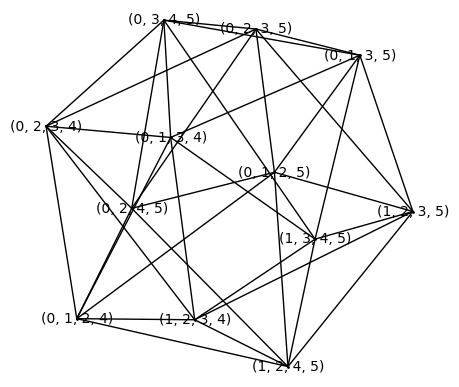

In [30]:
G=graphs.TuranGraph(6,3)
G.plot(layout='circular').show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,edge_thickness=1).show()

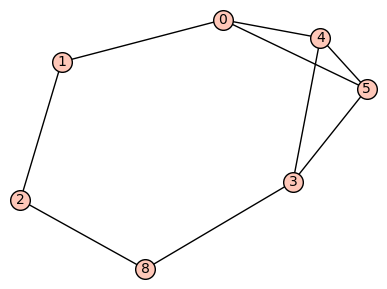

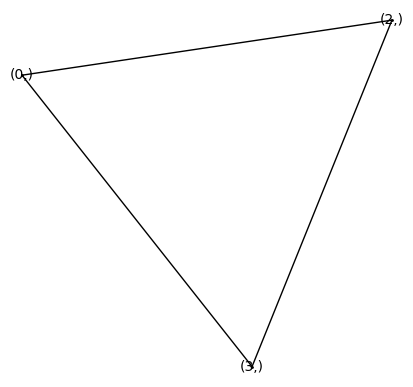

In [15]:
G=Graph({0:[1,4,5],1:[2],2:[8],3:[4,5,8],4:[5]})
G.show()
ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()

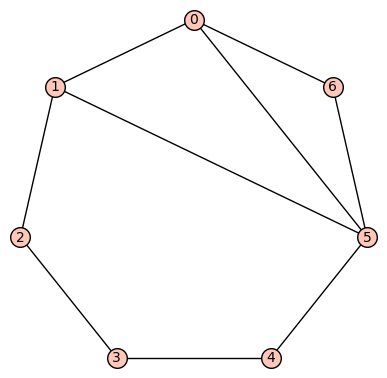

[(0,), (1,), (3,), (5,)]


In [14]:
G=graphs.CycleGraph(7)
G.add_edges([(5,0),(5,1)])
G.show()
print ptsk_TEgraph(G,Zskew(G)).vertices()

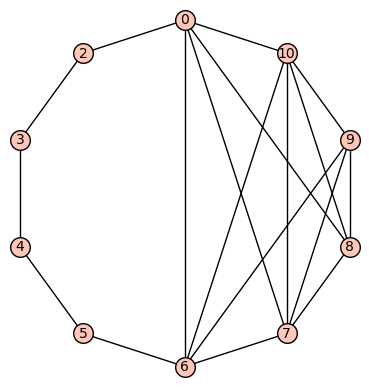

4
[(0, 2, 7, 8), (0, 2, 7, 9), (0, 2, 7, 10), (0, 2, 8, 9), (0, 2, 8, 10), (0, 2, 9, 10), (0, 4, 7, 8), (0, 4, 7, 9), (0, 4, 7, 10), (0, 4, 8, 9), (0, 4, 8, 10), (0, 4, 9, 10), (0, 6, 7, 8), (0, 6, 7, 9), (0, 6, 7, 10), (0, 6, 8, 9), (0, 6, 8, 10), (0, 6, 9, 10), (0, 7, 8, 9), (0, 7, 8, 10), (0, 8, 9, 10), (2, 3, 7, 8), (2, 3, 7, 9), (2, 3, 7, 10), (2, 3, 8, 9), (2, 3, 8, 10), (2, 3, 9, 10), (2, 5, 7, 8), (2, 5, 7, 9), (2, 5, 7, 10), (2, 5, 8, 9), (2, 5, 8, 10), (2, 5, 9, 10), (2, 7, 8, 9), (2, 7, 9, 10), (2, 8, 9, 10), (3, 4, 7, 8), (3, 4, 7, 9), (3, 4, 7, 10), (3, 4, 8, 9), (3, 4, 8, 10), (3, 4, 9, 10), (3, 6, 7, 8), (3, 6, 7, 9), (3, 6, 7, 10), (3, 6, 8, 9), (3, 6, 8, 10), (3, 6, 9, 10), (3, 7, 8, 9), (3, 7, 8, 10), (3, 8, 9, 10), (4, 5, 7, 8), (4, 5, 7, 9), (4, 5, 7, 10), (4, 5, 8, 9), (4, 5, 8, 10), (4, 5, 9, 10), (4, 7, 8, 9), (4, 7, 9, 10), (4, 8, 9, 10), (5, 6, 7, 8), (5, 6, 7, 9), (5, 6, 7, 10), (5, 6, 8, 9), (5, 6, 8, 10), (5, 6, 9, 10), (5, 7, 8, 9), (5, 7, 8, 10), (5, 8, 9,

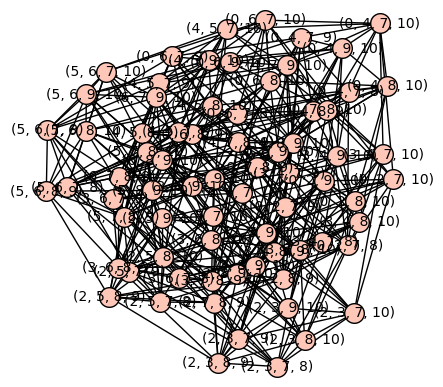

In [32]:
G=Graph({0:[10],2:[0,3],3:[4],4:[5],5:[6],6:[0,7,9,10],7:[0,8,9,10],8:[0,9,10],9:[10]})
G.plot(layout='circular').show()
print Zskew(G)
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot().show()

In [ ]:
G=graphs.ShrikhandeGraph()
G.show()
print Zskew(G)
print ptsk_TEgraph(G,Zskew(G)).vertices()
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

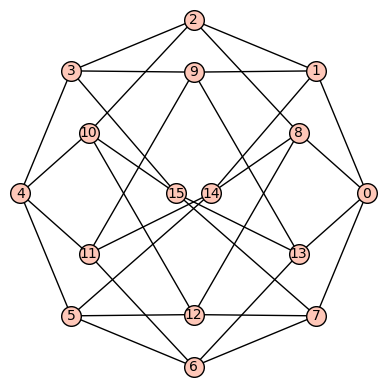

8
[(0, 1, 2, 3, 4, 5, 8, 9), (0, 1, 2, 3, 4, 5, 8, 12), (0, 1, 2, 3, 4, 5, 8, 14), (0, 1, 2, 3, 4, 5, 8, 15), (0, 1, 2, 3, 4, 5, 9, 10), (0, 1, 2, 3, 4, 5, 9, 11), (0, 1, 2, 3, 4, 5, 9, 13), (0, 1, 2, 3, 4, 5, 10, 12), (0, 1, 2, 3, 4, 5, 10, 14), (0, 1, 2, 3, 4, 5, 10, 15), (0, 1, 2, 3, 4, 5, 11, 12), (0, 1, 2, 3, 4, 5, 11, 14), (0, 1, 2, 3, 4, 5, 11, 15), (0, 1, 2, 3, 4, 5, 12, 13), (0, 1, 2, 3, 4, 5, 13, 14), (0, 1, 2, 3, 4, 5, 13, 15), (0, 1, 2, 3, 4, 7, 8, 9), (0, 1, 2, 3, 4, 7, 8, 12), (0, 1, 2, 3, 4, 7, 8, 14), (0, 1, 2, 3, 4, 7, 8, 15), (0, 1, 2, 3, 4, 7, 9, 10), (0, 1, 2, 3, 4, 7, 9, 11), (0, 1, 2, 3, 4, 7, 9, 13), (0, 1, 2, 3, 4, 7, 10, 12), (0, 1, 2, 3, 4, 7, 10, 14), (0, 1, 2, 3, 4, 7, 10, 15), (0, 1, 2, 3, 4, 7, 11, 12), (0, 1, 2, 3, 4, 7, 11, 14), (0, 1, 2, 3, 4, 7, 11, 15), (0, 1, 2, 3, 4, 7, 12, 13), (0, 1, 2, 3, 4, 7, 13, 14), (0, 1, 2, 3, 4, 7, 13, 15), (0, 1, 2, 3, 4, 8, 9, 11), (0, 1, 2, 3, 4, 8, 9, 13), (0, 1, 2, 3, 4, 8, 11, 12), (0, 1, 2, 3, 4, 8, 11, 14), (0, 1, 

In [25]:
G=graphs.HoffmanGraph()
G.show()
print Zskew(G)
print ptsk_TEgraph(G,Zskew(G)).vertices()
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
#ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

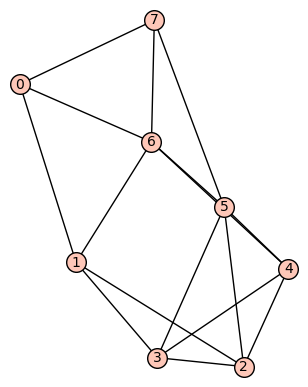

3
[(0, 1, 5), (0, 1, 6), (0, 1, 7), (0, 5, 7), (0, 6, 7), (1, 2, 4), (1, 2, 5), (1, 3, 4), (1, 3, 5), (1, 4, 5), (1, 5, 6), (1, 5, 7), (2, 4, 5), (3, 4, 5), (5, 6, 7)]


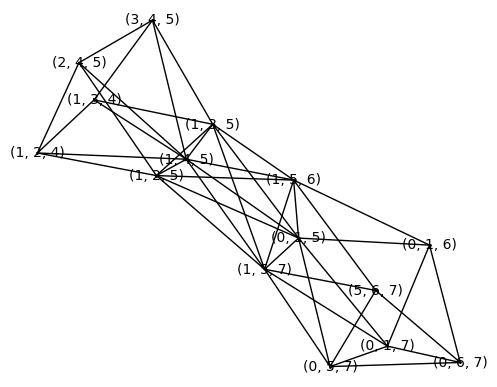

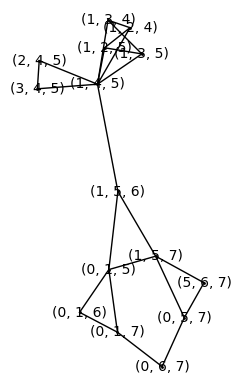

In [17]:
G=Graph({0:[1,6,7],1:[2,3,6],2:[3,4,5],3:[4,5],4:[5,6],5:[6,7],6:[7]})
G.show()
print Zskew(G)
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=True,layout='spring').show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=True,layout='spring').show()

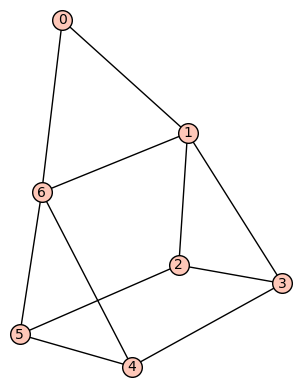

3
[(0, 1, 2), (0, 1, 3), (0, 1, 4), (0, 1, 5), (0, 2, 3), (0, 2, 4), (0, 2, 6), (0, 3, 5), (0, 3, 6), (0, 4, 5), (0, 4, 6), (0, 5, 6), (1, 2, 3), (1, 2, 5), (1, 3, 4), (1, 4, 5), (2, 3, 4), (2, 3, 5), (2, 3, 6), (2, 4, 5), (2, 5, 6), (3, 4, 5), (3, 4, 6), (4, 5, 6)]


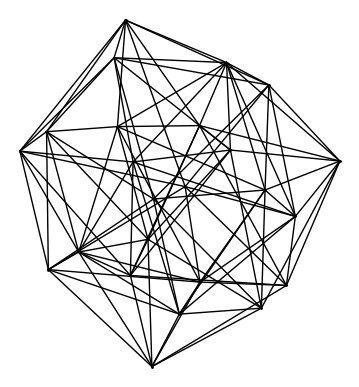

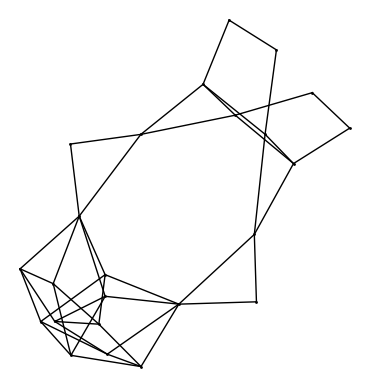

In [22]:
G=Graph({0:[1,6],1:[2,3,6],2:[3,5],3:[4],4:[5,6],5:[6]})
G.show()
print Zskew(G)
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

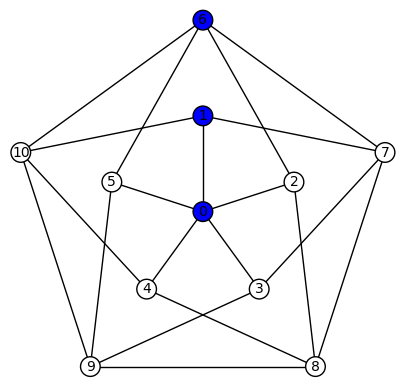

[(0, 1, 6), (0, 1, 7), (0, 1, 8), (0, 1, 9), (0, 1, 10), (0, 2, 6), (0, 2, 7), (0, 2, 8), (0, 2, 9), (0, 2, 10), (0, 3, 6), (0, 3, 7), (0, 3, 8), (0, 3, 9), (0, 3, 10), (0, 4, 6), (0, 4, 7), (0, 4, 8), (0, 4, 9), (0, 4, 10), (0, 5, 6), (0, 5, 7), (0, 5, 8), (0, 5, 9), (0, 5, 10), (1, 3, 6), (1, 3, 8), (1, 4, 6), (1, 4, 9), (1, 6, 8), (1, 6, 9), (1, 7, 9), (1, 7, 10), (1, 8, 10), (2, 4, 7), (2, 4, 9), (2, 5, 7), (2, 5, 10), (2, 6, 8), (2, 6, 9), (2, 7, 9), (2, 7, 10), (2, 8, 10), (3, 5, 8), (3, 5, 10), (3, 6, 8), (3, 6, 9), (3, 7, 9), (3, 7, 10), (3, 8, 10), (4, 6, 8), (4, 6, 9), (4, 7, 9), (4, 7, 10), (4, 8, 10), (5, 6, 8), (5, 6, 9), (5, 7, 9), (5, 7, 10), (5, 8, 10)]


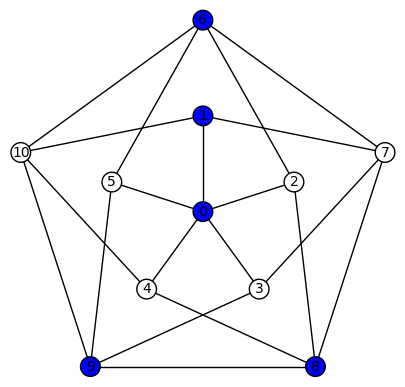

[(0, 1, 6), (0, 1, 7), (0, 1, 8), (0, 1, 9), (0, 1, 10), (0, 2, 6), (0, 2, 7), (0, 2, 8), (0, 2, 9), (0, 2, 10), (0, 3, 6), (0, 3, 7), (0, 3, 8), (0, 3, 9), (0, 3, 10), (0, 4, 6), (0, 4, 7), (0, 4, 8), (0, 4, 9), (0, 4, 10), (0, 5, 6), (0, 5, 7), (0, 5, 8), (0, 5, 9), (0, 5, 10), (1, 3, 6), (1, 3, 8), (1, 4, 6), (1, 4, 9), (1, 6, 8), (1, 6, 9), (1, 7, 9), (1, 7, 10), (1, 8, 10), (2, 4, 7), (2, 4, 9), (2, 5, 7), (2, 5, 10), (2, 6, 8), (2, 6, 9), (2, 7, 9), (2, 7, 10), (2, 8, 10), (3, 5, 8), (3, 5, 10), (3, 6, 8), (3, 6, 9), (3, 7, 9), (3, 7, 10), (3, 8, 10), (4, 6, 8), (4, 6, 9), (4, 7, 9), (4, 7, 10), (4, 8, 10), (5, 6, 8), (5, 6, 9), (5, 7, 9), (5, 7, 10), (5, 8, 10)]


In [25]:
G=graphs.GrotzschGraph()
G.plot(vertex_colors={'white':[2,3,4,5,7,8,9,10],'blue':[0,1,6]}).show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
G.plot(vertex_colors={'white':[2,3,4,5,7,10],'blue':[0,1,6,8,9]}).show()
print ptsk_TEgraph(G,Zskew(G)).vertices()

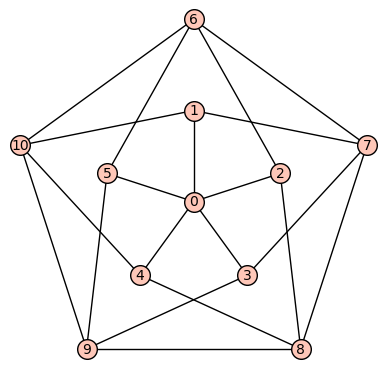

[(0, 1, 6), (0, 1, 7), (0, 1, 8), (0, 1, 9), (0, 1, 10), (0, 2, 6), (0, 2, 7), (0, 2, 8), (0, 2, 9), (0, 2, 10), (0, 3, 6), (0, 3, 7), (0, 3, 8), (0, 3, 9), (0, 3, 10), (0, 4, 6), (0, 4, 7), (0, 4, 8), (0, 4, 9), (0, 4, 10), (0, 5, 6), (0, 5, 7), (0, 5, 8), (0, 5, 9), (0, 5, 10), (1, 3, 6), (1, 3, 8), (1, 4, 6), (1, 4, 9), (1, 6, 8), (1, 6, 9), (1, 7, 9), (1, 7, 10), (1, 8, 10), (2, 4, 7), (2, 4, 9), (2, 5, 7), (2, 5, 10), (2, 6, 8), (2, 6, 9), (2, 7, 9), (2, 7, 10), (2, 8, 10), (3, 5, 8), (3, 5, 10), (3, 6, 8), (3, 6, 9), (3, 7, 9), (3, 7, 10), (3, 8, 10), (4, 6, 8), (4, 6, 9), (4, 7, 9), (4, 7, 10), (4, 8, 10), (5, 6, 8), (5, 6, 9), (5, 7, 9), (5, 7, 10), (5, 8, 10)]


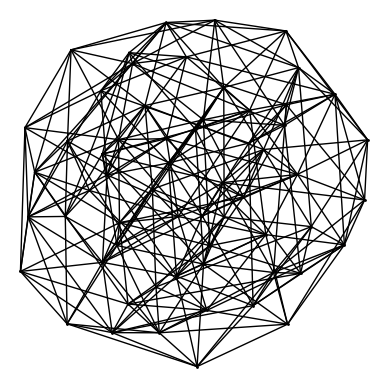

In [20]:
G=graphs.GrotzschGraph()
G.show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

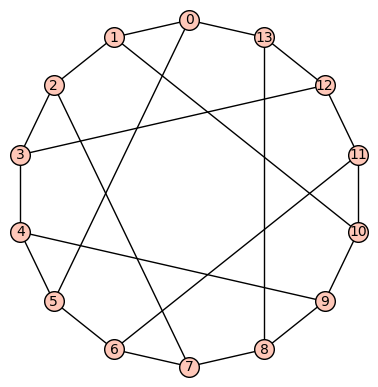

[(0, 1, 2, 3, 4, 5), (0, 1, 2, 3, 4, 9), (0, 1, 2, 3, 4, 11), (0, 1, 2, 3, 4, 13), (0, 1, 2, 3, 5, 6), (0, 1, 2, 3, 5, 8), (0, 1, 2, 3, 5, 12), (0, 1, 2, 3, 6, 9), (0, 1, 2, 3, 6, 11), (0, 1, 2, 3, 6, 13), (0, 1, 2, 3, 8, 9), (0, 1, 2, 3, 8, 11), (0, 1, 2, 3, 8, 13), (0, 1, 2, 3, 9, 12), (0, 1, 2, 3, 11, 12), (0, 1, 2, 3, 12, 13), (0, 1, 2, 4, 5, 7), (0, 1, 2, 4, 5, 9), (0, 1, 2, 4, 5, 11), (0, 1, 2, 4, 7, 9), (0, 1, 2, 4, 7, 11), (0, 1, 2, 4, 7, 13), (0, 1, 2, 4, 9, 13), (0, 1, 2, 4, 11, 13), (0, 1, 2, 5, 6, 7), (0, 1, 2, 5, 6, 9), (0, 1, 2, 5, 6, 11), (0, 1, 2, 5, 7, 8), (0, 1, 2, 5, 7, 12), (0, 1, 2, 5, 8, 9), (0, 1, 2, 5, 8, 11), (0, 1, 2, 5, 9, 12), (0, 1, 2, 5, 11, 12), (0, 1, 2, 6, 7, 9), (0, 1, 2, 6, 7, 11), (0, 1, 2, 6, 7, 13), (0, 1, 2, 6, 9, 13), (0, 1, 2, 6, 11, 13), (0, 1, 2, 7, 8, 9), (0, 1, 2, 7, 8, 11), (0, 1, 2, 7, 8, 13), (0, 1, 2, 7, 9, 12), (0, 1, 2, 7, 11, 12), (0, 1, 2, 7, 12, 13), (0, 1, 2, 8, 9, 13), (0, 1, 2, 8, 11, 13), (0, 1, 2, 9, 12, 13), (0, 1, 2, 11, 12, 

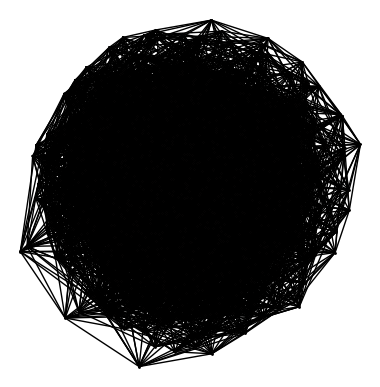

In [19]:

G=graphs.HeawoodGraph()
G.show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

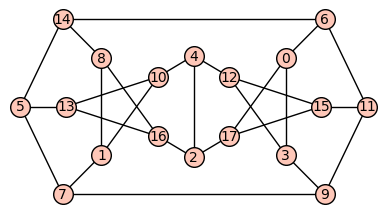

[(0, 1, 2, 5), (0, 1, 2, 6), (0, 1, 2, 9), (0, 1, 2, 10), (0, 1, 2, 12), (0, 1, 3, 7), (0, 1, 3, 11), (0, 1, 3, 14), (0, 1, 3, 16), (0, 1, 4, 7), (0, 1, 4, 11), (0, 1, 4, 14), (0, 1, 4, 16), (0, 1, 4, 17), (0, 1, 5, 6), (0, 1, 5, 8), (0, 1, 5, 10), (0, 1, 5, 11), (0, 1, 5, 14), (0, 1, 5, 15), (0, 1, 5, 16), (0, 1, 5, 17), (0, 1, 6, 8), (0, 1, 6, 9), (0, 1, 6, 12), (0, 1, 6, 15), (0, 1, 7, 11), (0, 1, 7, 13), (0, 1, 7, 14), (0, 1, 7, 16), (0, 1, 8, 9), (0, 1, 8, 12), (0, 1, 9, 10), (0, 1, 9, 11), (0, 1, 9, 14), (0, 1, 9, 15), (0, 1, 9, 16), (0, 1, 9, 17), (0, 1, 10, 11), (0, 1, 10, 12), (0, 1, 10, 14), (0, 1, 10, 15), (0, 1, 10, 16), (0, 1, 11, 12), (0, 1, 11, 13), (0, 1, 11, 17), (0, 1, 12, 14), (0, 1, 12, 15), (0, 1, 12, 16), (0, 1, 12, 17), (0, 1, 13, 14), (0, 1, 13, 16), (0, 1, 13, 17), (0, 1, 14, 17), (0, 1, 16, 17), (0, 2, 3, 6), (0, 2, 3, 7), (0, 2, 3, 9), (0, 2, 3, 10), (0, 2, 3, 11), (0, 2, 3, 12), (0, 2, 3, 14), (0, 2, 3, 16), (0, 2, 3, 17), (0, 2, 4, 6), (0, 2, 4, 7), (0, 2, 

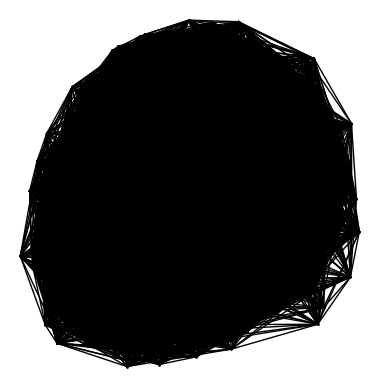

In [18]:
G=graphs.BlanusaSecondSnarkGraph()
G.show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

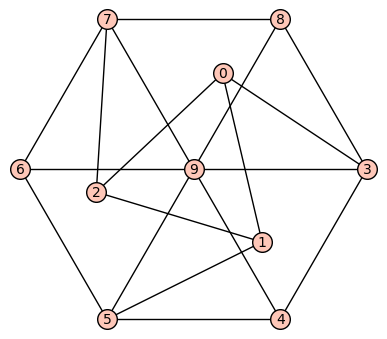

[(0, 1, 2, 4), (0, 1, 2, 6), (0, 1, 2, 8), (0, 1, 3, 4), (0, 1, 3, 6), (0, 1, 3, 8), (0, 1, 4, 5), (0, 1, 4, 6), (0, 1, 4, 8), (0, 1, 4, 9), (0, 1, 5, 6), (0, 1, 5, 8), (0, 1, 6, 9), (0, 1, 8, 9), (0, 2, 3, 4), (0, 2, 3, 6), (0, 2, 3, 8), (0, 2, 4, 7), (0, 2, 4, 8), (0, 2, 4, 9), (0, 2, 6, 7), (0, 2, 6, 8), (0, 2, 6, 9), (0, 2, 7, 8), (0, 2, 8, 9), (0, 3, 4, 5), (0, 3, 4, 7), (0, 3, 4, 8), (0, 3, 4, 9), (0, 3, 5, 6), (0, 3, 5, 8), (0, 3, 6, 7), (0, 3, 6, 9), (0, 3, 7, 8), (0, 3, 8, 9), (0, 4, 5, 7), (0, 4, 5, 8), (0, 4, 5, 9), (0, 4, 6, 7), (0, 4, 6, 8), (0, 4, 6, 9), (0, 4, 7, 8), (0, 4, 7, 9), (0, 5, 6, 7), (0, 5, 6, 8), (0, 5, 6, 9), (0, 5, 7, 8), (0, 5, 8, 9), (0, 6, 7, 9), (0, 6, 8, 9), (0, 7, 8, 9), (1, 2, 4, 5), (1, 2, 4, 6), (1, 2, 4, 7), (1, 2, 4, 9), (1, 2, 5, 6), (1, 2, 5, 8), (1, 2, 6, 7), (1, 2, 6, 8), (1, 2, 6, 9), (1, 2, 7, 8), (1, 2, 8, 9), (1, 3, 4, 5), (1, 3, 4, 6), (1, 3, 4, 7), (1, 3, 4, 9), (1, 3, 5, 6), (1, 3, 5, 8), (1, 3, 6, 7), (1, 3, 6, 8), (1, 3, 6, 9), (1, 3

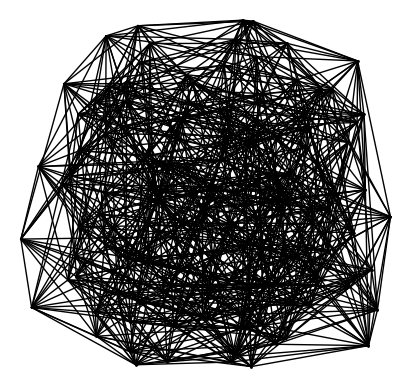

In [16]:
G=graphs.GolombGraph()
G.show()
print ptsk_TEgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()


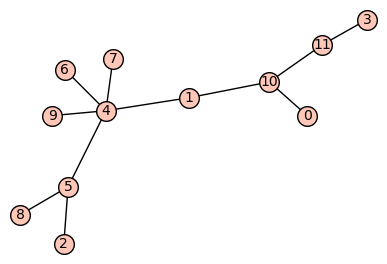

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11]
[(0, 10, None), (1, 4, None), (1, 10, None), (2, 5, None), (3, 11, None), (4, 5, None), (4, 6, None), (4, 7, None), (4, 9, None), (5, 8, None), (10, 11, None)]


In [47]:
T=graphs.RandomTree(12)
T.show()
print T.vertices()
print T.edges()

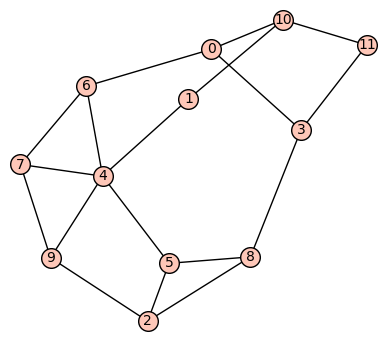

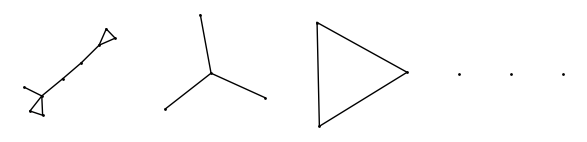

[4, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 0, 0, 0]


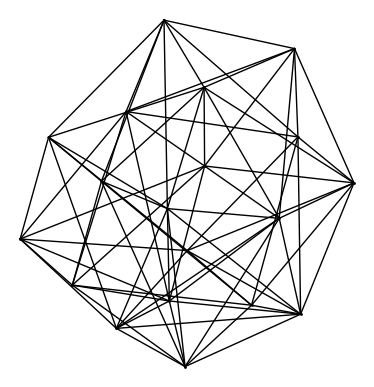

In [51]:
G=Graph([(0, 10, None), (1, 4, None), (1, 10, None), (2, 5, None), (3, 11, None), (4, 5, None), (4, 6, None), (4, 7, None), (4, 9, None), (5, 8, None), (10, 11, None)])
G.add_edges([(0,3),(0,6),(3,8),(8,2),(2,9),(9,7),(7,6)])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

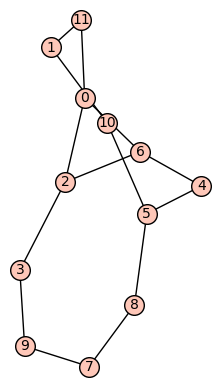

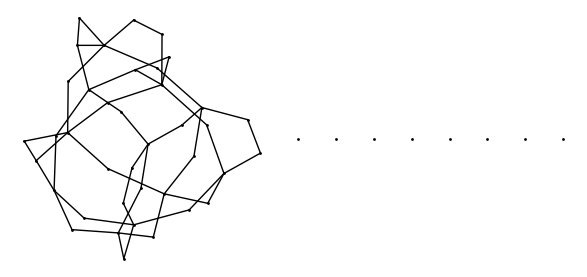

[5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0]


In [46]:
G=Graph([(0, 11, None), (1, 10, None), (1, 11, None), (2, 3, None), (3, 9, None), (4, 5, None), (4, 6, None), (5, 8, None), (5, 10, None), (7, 8, None), (7, 9, None)])
G.add_edges([(2,6),(0,2),(6,0)])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()

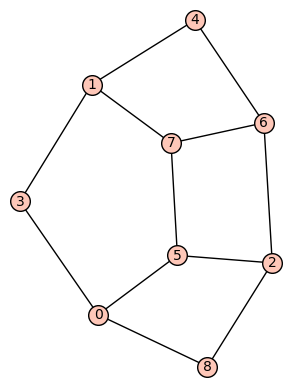

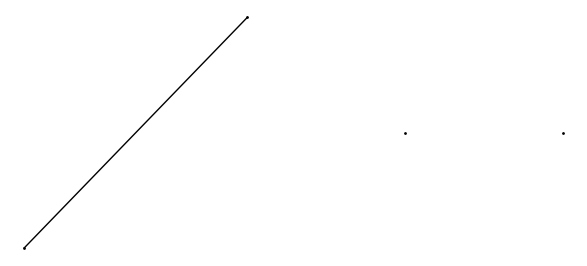

[1, 1, 0, 0]
[(0,), (1,), (2,), (6,)]


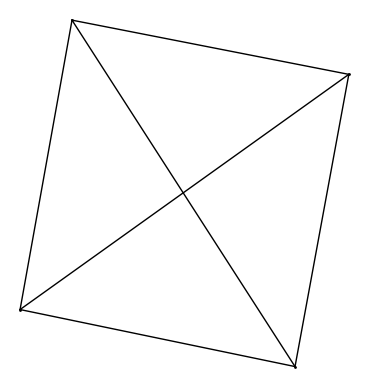

In [53]:
G=Graph([(0, 3, None), (0, 5, None), (0, 8, None), (1, 3, None), (1, 4, None), (1, 7, None), (2, 8, None), (4, 6, None)])
G.add_edges([(2,5),(2,6),(5,7),(6,7)])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()
print ptsk_TSgraph(G,Zskew(G)).vertices()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()

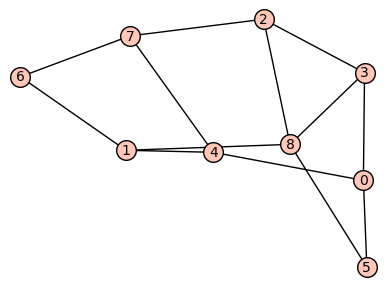

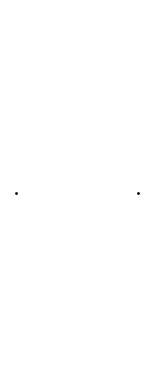

[0, 0]


In [40]:
G=Graph([(0, 5, None), (1, 4, None), (1, 6, None), (1, 8, None), (2, 8, None), (3, 8, None), (5, 8, None), (6, 7, None)])
G.add_edges([(0,3),(0,4),(4,7),(2,7),(2,3)])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()

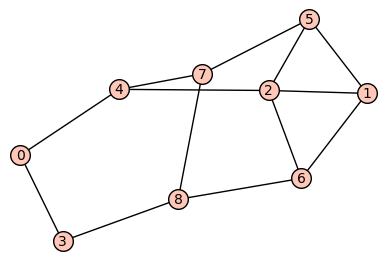

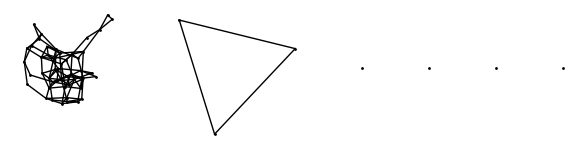

[7, 7, 7, 7, 7, 6, 6, 6, 6, 6, 6, 6, 6, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0]


In [36]:
G=Graph([(0, 3, None), (0, 4, None), (1, 2, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 8, None), (4, 7, None)])
G.add_edges([(1,5),(1,6),(6,8),(7,8),(5,7)])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()

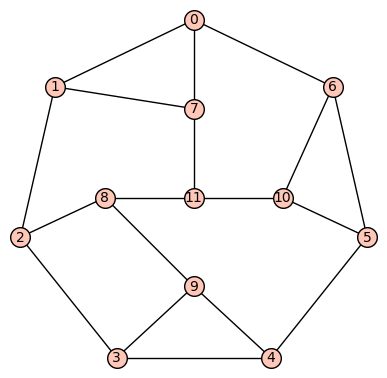

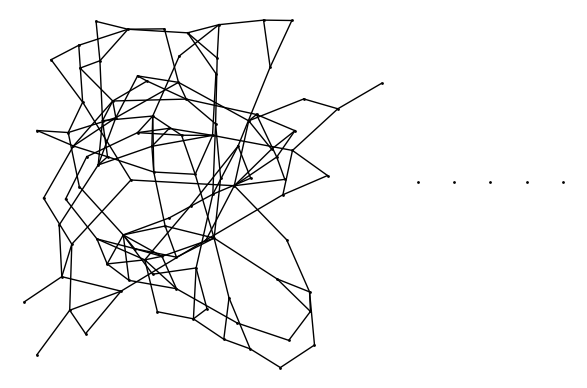

[8, 7, 7, 6, 6, 6, 6, 6, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 0, 0, 0, 0, 0]


In [23]:
G=graphs.FruchtGraph()
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()

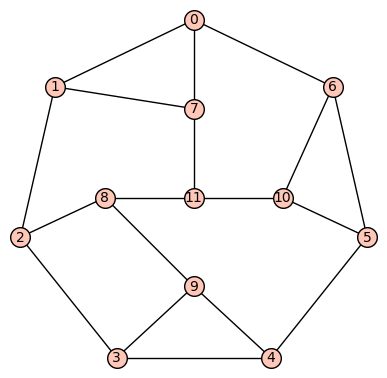

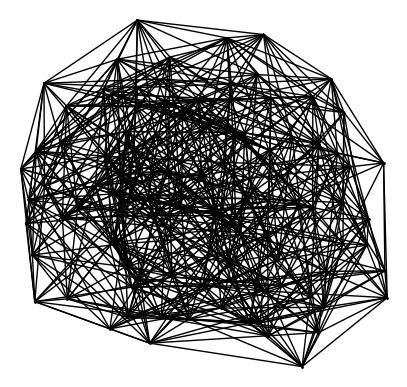

[21, 20, 19, 19, 19, 19, 19, 19, 18, 18, 18, 18, 18, 18, 18, 18, 17, 17, 17, 17, 17, 17, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 11, 11, 11, 10, 10]


In [50]:
G=graphs.FruchtGraph()
G.show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,vertex_labels=False,layout='spring').show()
print ptsk_TEgraph(G,Zskew(G)).degree_sequence()

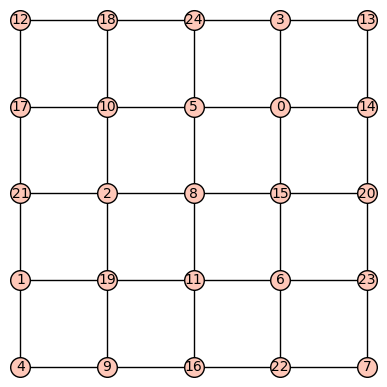

[(4, 7, 14, 15, 20), (6, 7, 8, 14, 18), (0, 3, 6, 13, 22), (6, 9, 13, 16, 17), (6, 15, 16, 19, 22), (0, 6, 9, 17, 24), (4, 6, 7, 14, 17), (0, 3, 10, 13, 23), (9, 11, 12, 19, 24), (1, 2, 4, 7, 21), (0, 5, 10, 18, 24), (7, 9, 19, 21, 23), (4, 10, 14, 15, 21), (9, 10, 11, 13, 24), (4, 5, 10, 14, 16), (4, 7, 9, 16, 18), (7, 13, 14, 15, 20), (1, 2, 10, 16, 19), (1, 2, 6, 7, 13), (0, 3, 8, 13, 18), (3, 6, 13, 17, 24), (3, 4, 6, 7, 18), (1, 10, 18, 19, 24), (3, 4, 7, 18, 19), (0, 8, 9, 17, 20), (7, 13, 15, 20, 23), (2, 9, 10, 13, 24), (8, 10, 11, 12, 22), (3, 10, 19, 23, 24), (0, 6, 14, 17, 20), (3, 5, 7, 13, 24), (1, 4, 6, 11, 20), (10, 11, 12, 13, 23), (2, 6, 8, 9, 16), (8, 13, 14, 20, 23), (3, 5, 6, 13, 20), (6, 7, 13, 14, 18), (9, 12, 19, 21, 22), (7, 13, 14, 16, 22), (2, 6, 17, 19, 21), (8, 14, 16, 17, 19), (3, 12, 13, 17, 21), (10, 12, 14, 19, 22), (1, 8, 12, 22, 24), (0, 6, 9, 11, 24), (0, 3, 10, 15, 24), (0, 9, 11, 12, 21), (1, 6, 8, 18, 20), (0, 6, 8, 14, 23), (4, 10, 14, 15, 16), (5

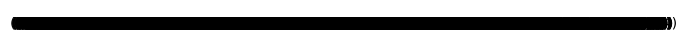

In [20]:
G=graphs.Grid2dGraph(5,5)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print list(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

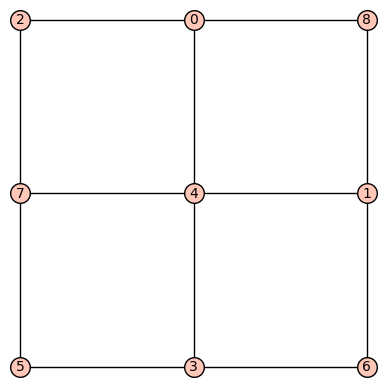

[(3, 4, 6), (2, 3, 5), (1, 2, 8), (0, 4, 5), (0, 6, 8), (0, 5, 6), (1, 4, 5), (3, 6, 8), (1, 6, 8), (5, 6, 7), (2, 5, 7), (0, 2, 5), (0, 4, 8), (4, 7, 8), (0, 2, 4), (2, 7, 8), (2, 4, 7), (3, 4, 8), (6, 7, 8), (1, 2, 4), (1, 2, 5), (2, 3, 8), (4, 5, 7), (0, 2, 8), (1, 4, 8), (1, 5, 6), (3, 5, 6), (1, 4, 6), (3, 4, 5), (2, 3, 4), (4, 6, 7), (0, 4, 6)]
[[(3, 4, 6)], [(2, 3, 5)], [(1, 2, 8)], [(0, 4, 5)], [(0, 6, 8)], [(0, 5, 6)], [(1, 4, 5)], [(3, 6, 8)], [(1, 6, 8)], [(5, 6, 7)], [(2, 5, 7)], [(0, 2, 5)], [(0, 4, 8)], [(4, 7, 8)], [(0, 2, 4)], [(2, 7, 8)], [(2, 4, 7)], [(3, 4, 8)], [(6, 7, 8)], [(1, 2, 4)], [(1, 2, 5)], [(2, 3, 8)], [(4, 5, 7)], [(0, 2, 8)], [(1, 4, 8)], [(1, 5, 6)], [(3, 5, 6)], [(1, 4, 6)], [(3, 4, 5)], [(2, 3, 4)], [(4, 6, 7)], [(0, 4, 6)]]


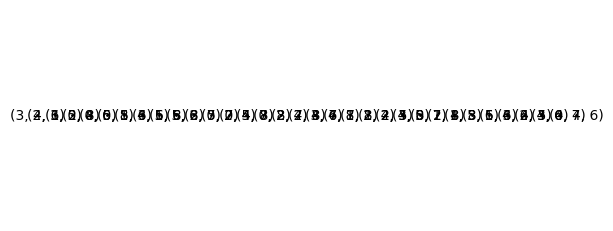

In [19]:
G=graphs.Grid2dGraph(3,3)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print list(ptsk_TSgraph(G,Zskew(G)))
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

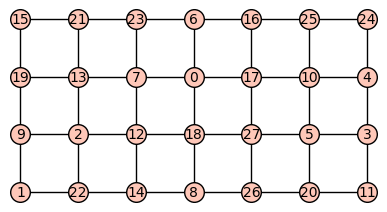

[[(5, 13, 15, 25)], [(6, 20, 21, 27)], [(2, 10, 20, 21)], [(2, 8, 12, 14)], [(10, 17, 24, 25)], [(8, 11, 12, 26)], [(5, 10, 24, 25)], [(4, 8, 11, 20)], [(4, 10, 11, 24)], [(1, 13, 21, 22)], [(3, 5, 24, 26)], [(1, 2, 9, 13)], [(5, 13, 15, 26)], [(5, 9, 13, 26)], [(4, 11, 16, 24)], [(1, 2, 10, 16)], [(2, 13, 14, 23)], [(6, 9, 12, 25)], [(5, 11, 13, 15)], [(3, 6, 8, 19)], [(6, 8, 20, 25)], [(3, 4, 11, 24)], [(1, 9, 14, 15)], [(3, 6, 8, 21)], [(4, 5, 8, 22)], [(3, 5, 11, 27)], [(2, 19, 20, 27)], [(1, 15, 21, 23)], [(10, 11, 24, 25)], [(3, 7, 10, 21)], [(8, 12, 17, 25)], [(6, 10, 24, 25)], [(3, 7, 10, 19)], [(2, 13, 19, 22)], [(1, 2, 16, 24)], [(10, 16, 17, 25)], [(2, 13, 15, 21)], [(6, 16, 17, 24)], [(1, 13, 14, 22)], [(6, 7, 16, 24)], [(1, 2, 3, 10)], [(2, 13, 15, 19)], [(1, 13, 14, 23)], [(7, 10, 19, 20)], [(1, 3, 8, 14)], [(5, 8, 22, 25)], [(5, 10, 11, 24)], [(3, 5, 10, 11)], [(5, 8, 11, 20)], [(1, 8, 9, 14)], [(1, 2, 3, 24)], [(1, 9, 13, 14)], [(5, 12, 22, 25)], [(6, 9, 13, 19)], [(6, 

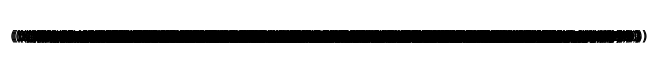

In [16]:
G=graphs.Grid2dGraph(4,7)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

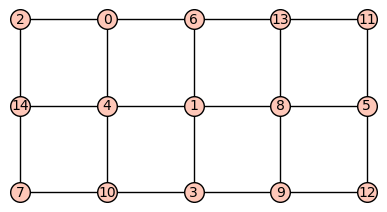

[[(3, 8, 10)], [(3, 12, 14)], [(5, 11, 12)], [(2, 6, 9)], [(0, 6, 8)], [(8, 10, 11)], [(8, 9, 12)], [(4, 6, 9)], [(0, 6, 11)], [(6, 11, 13)], [(0, 3, 8)], [(5, 6, 11)], [(6, 8, 9)], [(2, 4, 14)], [(3, 9, 12)], [(3, 8, 13)], [(5, 6, 8)], [(3, 8, 14)], [(3, 5, 8)], [(4, 7, 9)], [(4, 6, 13)], [(6, 9, 11)], [(8, 11, 14)], [(4, 5, 6)], [(4, 7, 10)], [(0, 3, 12)], [(4, 6, 10)], [(2, 5, 7)], [(3, 4, 13)], [(2, 4, 5)], [(3, 4, 14)], [(8, 12, 13)], [(3, 5, 12)], [(0, 2, 4)], [(6, 10, 11)], [(3, 12, 13)], [(5, 8, 12)], [(9, 11, 12)], [(8, 11, 13)], [(0, 2, 7)], [(4, 7, 14)], [(0, 8, 12)], [(2, 7, 9)], [(3, 7, 13)], [(0, 2, 6)], [(6, 8, 13)], [(3, 4, 9)], [(0, 8, 11)], [(2, 7, 10)], [(11, 12, 13)], [(10, 11, 12)], [(3, 4, 10)], [(5, 8, 11)], [(2, 5, 6)], [(3, 8, 9)], [(11, 12, 14)], [(0, 11, 12)], [(8, 12, 14)], [(4, 7, 13)], [(3, 10, 12)], [(0, 3, 7)], [(3, 7, 14)], [(6, 8, 10)], [(2, 6, 14)], [(2, 4, 9)], [(4, 5, 7)], [(0, 3, 4)], [(2, 7, 13)], [(3, 7, 9)], [(8, 9, 11)], [(2, 6, 13)], [(2, 7, 1

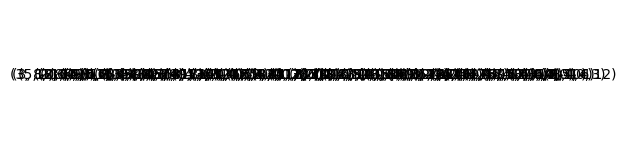

In [14]:
G=graphs.Grid2dGraph(3,5)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

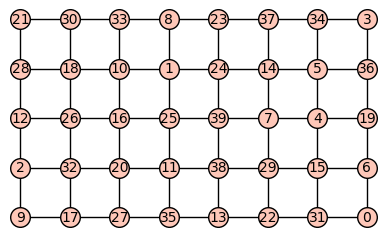

[[(2, 13, 26, 31)], [(6, 8, 10, 34)], [(13, 26, 30, 31)], [(4, 8, 30, 31)], [(2, 6, 28, 34)], [(10, 23, 28, 34)], [(6, 26, 28, 34)], [(8, 28, 31, 34)], [(26, 28, 31, 34)], [(2, 26, 29, 31)], [(2, 13, 30, 31)], [(4, 8, 28, 36)], [(6, 10, 30, 36)], [(4, 17, 30, 31)], [(14, 26, 30, 34)], [(17, 29, 30, 31)], [(10, 13, 28, 31)], [(2, 4, 28, 34)], [(14, 17, 28, 34)], [(6, 10, 28, 36)], [(6, 20, 34, 35)], [(17, 28, 29, 31)], [(2, 6, 13, 28)], [(6, 13, 17, 20)], [(6, 13, 26, 30)], [(13, 17, 28, 29)], [(6, 10, 28, 34)], [(6, 13, 20, 35)], [(2, 23, 34, 35)], [(2, 23, 28, 34)], [(6, 10, 28, 29)], [(17, 23, 30, 34)], [(2, 13, 31, 35)], [(14, 17, 30, 36)], [(6, 26, 30, 34)], [(4, 26, 30, 31)], [(10, 30, 31, 34)], [(4, 17, 26, 31)], [(17, 28, 31, 36)], [(4, 17, 35, 36)], [(6, 8, 13, 28)], [(4, 6, 10, 30)], [(4, 6, 20, 35)], [(14, 17, 23, 35)], [(8, 13, 29, 30)], [(4, 6, 8, 30)], [(4, 17, 30, 36)], [(4, 8, 10, 31)], [(8, 14, 28, 34)], [(14, 23, 26, 28)], [(2, 26, 31, 34)], [(13, 17, 31, 35)], [(2, 6,

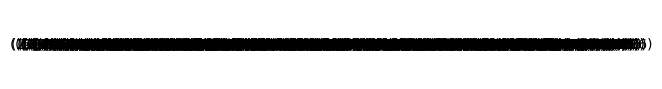

In [13]:
G=graphs.Grid2dGraph(5,8)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

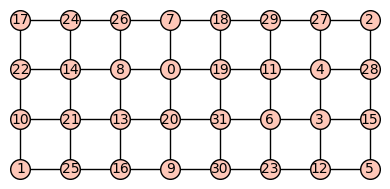

[[(7, 9, 22, 25)], [(16, 18, 21, 28)], [(3, 5, 8, 24)], [(4, 15, 17, 25)], [(4, 17, 26, 29)], [(3, 5, 8, 22)], [(15, 18, 28, 30)], [(7, 10, 17, 24)], [(4, 10, 15, 17)], [(4, 5, 15, 23)], [(6, 18, 28, 30)], [(3, 4, 15, 27)], [(2, 5, 12, 28)], [(1, 3, 24, 28)], [(12, 17, 25, 30)], [(4, 5, 15, 27)], [(14, 21, 22, 25)], [(8, 14, 22, 26)], [(7, 18, 24, 28)], [(2, 4, 14, 26)], [(2, 3, 5, 29)], [(1, 14, 17, 21)], [(7, 8, 17, 25)], [(1, 5, 21, 27)], [(7, 8, 14, 17)], [(3, 6, 12, 28)], [(2, 4, 5, 27)], [(6, 9, 12, 13)], [(2, 3, 27, 29)], [(1, 3, 23, 24)], [(3, 7, 23, 24)], [(6, 9, 12, 25)], [(16, 17, 21, 25)], [(4, 5, 12, 27)], [(1, 10, 16, 17)], [(4, 14, 15, 17)], [(4, 5, 12, 23)], [(1, 9, 13, 22)], [(8, 11, 24, 27)], [(4, 5, 23, 29)], [(4, 5, 28, 29)], [(1, 9, 13, 24)], [(2, 4, 13, 25)], [(2, 11, 15, 27)], [(10, 16, 17, 21)], [(1, 11, 18, 22)], [(3, 5, 7, 24)], [(6, 9, 13, 15)], [(7, 8, 18, 28)], [(1, 14, 22, 25)], [(1, 10, 17, 21)], [(1, 18, 22, 27)], [(1, 9, 24, 25)], [(9, 10, 15, 30)], [(6

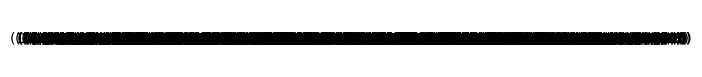

In [12]:
G=graphs.Grid2dGraph(4,8)
G.relabel()
G.show()
#print connected_components(ptsk_TEgraph(G,Zskew(G)))
#ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

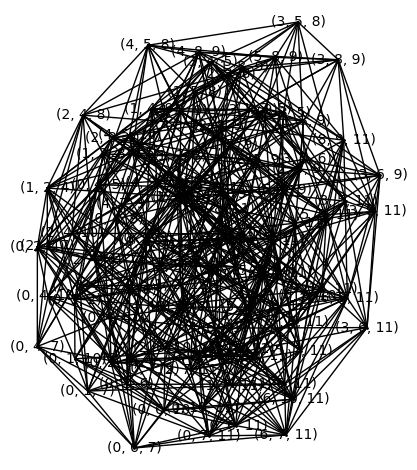

In [13]:
g=graphs.FruchtGraph()
ptsk_TEgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()

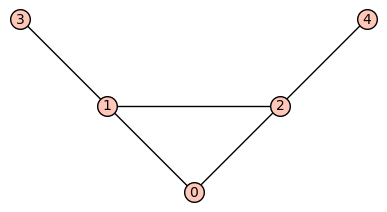

[2, 3, 3, 1, 1]
1


In [56]:
g=graphs.BullGraph()
g.show()
print g.degree()
print g.degree()[g.order()-2]


In [12]:
n=9
for g in graphs(n):
    k=ptsk_TEgraph(g,Zskew(g)).order()-1
    if (g.is_connected()==True and ptsk_TEgraph(g,Zskew(g)).order()>2 and ptsk_TEgraph(g,Zskew(g)).degree()[k]==1):
        #print g.vertices(), g.edges()
        print ptsk_TEgraph(g,Zskew(g)).degree()
        ptsk_TEgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()

KeyboardInterrupt: 

In [25]:
n=7
count=0
for g in graphs(n):
    if Zskew(g)==2:
        print g.vertices(), g.edges()

[0, 1, 2, 3, 4, 5, 6] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 6, None), (3, 5, None), (4, 6, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 3, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 6, None), (4, 5, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 3, None), (0, 4, None), (0, 6, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (3, 4, None), (5, 6, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 2, None), (0, 4, None), (0, 6, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (3, 5, None), (4, 6, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 2, None), (0, 4, None), (0, 5, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 2, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None)]
[0, 1, 2, 3, 4, 5, 6] [(0, 2, None), (0, 4, None), (0, 5, None),

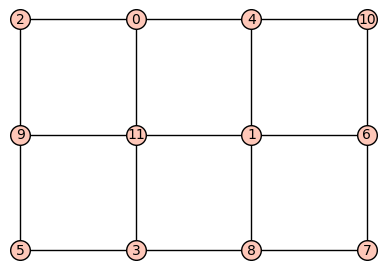

[[(0, 4), (0, 6), (0, 8), (3, 4), (3, 6), (3, 8), (4, 9), (6, 9), (8, 9)]]


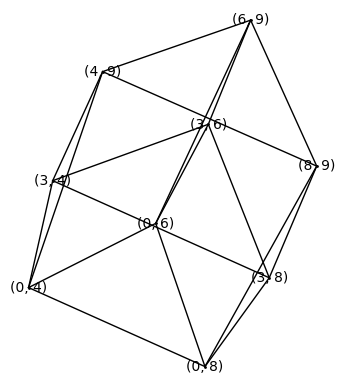

[[(8, 9)], [(6, 9)], [(4, 9)], [(3, 8)], [(0, 6)], [(3, 6)], [(0, 4)], [(0, 8)], [(3, 4)]]


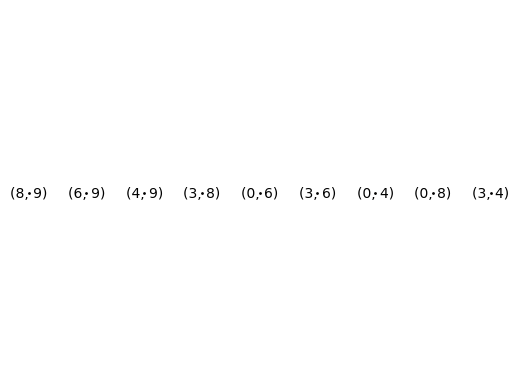

In [17]:
G=graphs.Grid2dGraph(3,4)
G.relabel()
G.show()
print connected_components(ptsk_TEgraph(G,Zskew(G)))
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1).show()
print connected_components(ptsk_TSgraph(G,Zskew(G)))
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1).show()

7


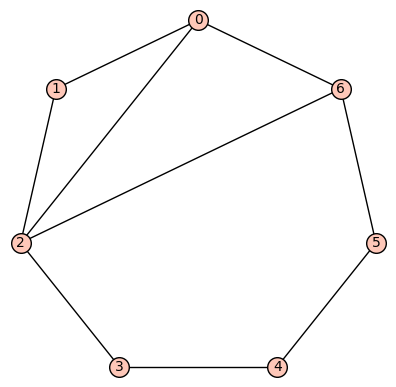

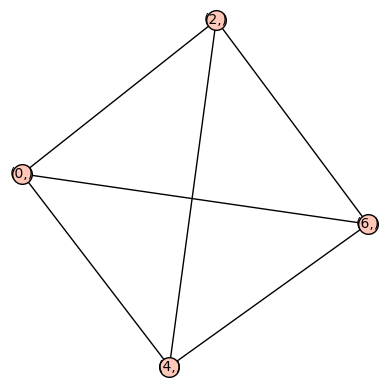

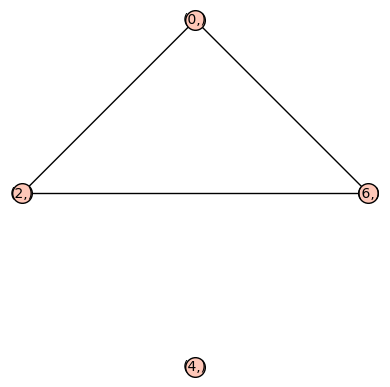

In [18]:
G=Graph({0:[1,6],1:[2],2:[3,0,6],3:[4],4:[5],5:[6]})
print len(G.vertices())
G.plot(layout="circular").show()
ptsk_TEgraph(G,Zskew(G)).plot().show()
ptsk_TSgraph(G,Zskew(G)).plot(layout='circular').show()

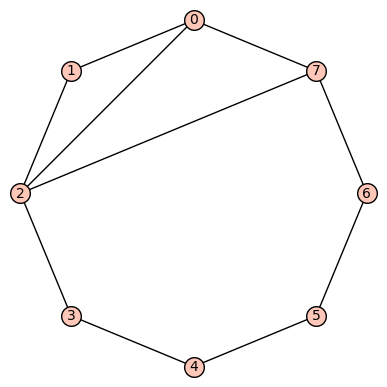

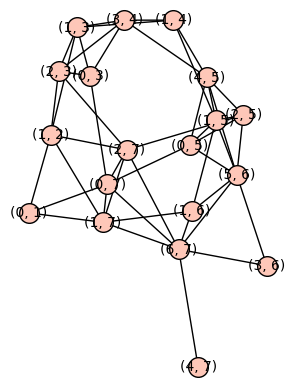

[10, 10, 10, 9, 9, 9, 9, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7]
[7, 7, 6, 6, 6, 6, 6, 5, 5, 5, 5, 5, 5, 4, 4, 4, 3, 2, 1]


In [58]:
G=Graph({0:[1,7],1:[2],2:[3,0,7],3:[4],4:[5],5:[6],6:[7]})
G.plot(layout="circular").show()
Zskew(G)
ptsk_TEgraph(G,Zskew(G))
ptsk_TSgraph(G,Zskew(G)).plot(layout='spring').show()
print ptsk_TEgraph(G,Zskew(G)).degree_sequence()
print ptsk_TSgraph(G,Zskew(G)).degree_sequence()

In [55]:
n=3
for g in graphs(n):
    if ptsk_TEgraph(g,Zskew(g)).is_tree()==True:
        print g.edges()
        

[(0, 2, None), (1, 2, None)]


In [12]:
n=9
for g in graphs(n):
    if (ptsk_TEgraph(g,Zskew(g)).is_tree()==True and g.is_connected()==True and ptsk_TEgraph(g,Zskew(g)).order()>2):
        if (len(ptsk_TEgraph(g,Zskew(g)).vertices())>1):
            g.show()
            print g.vertices(), g.edges()
            ptsk_TEgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()

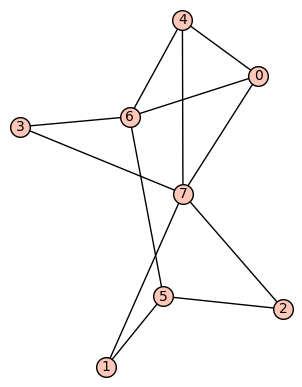

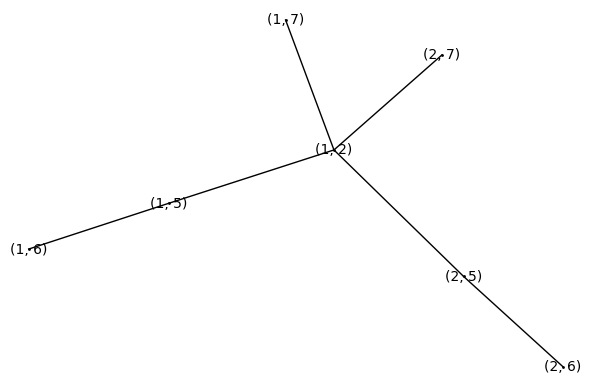

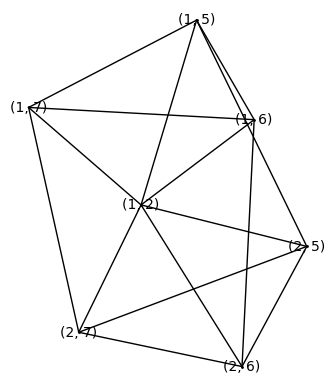

In [56]:
g=Graph( [(0, 4, None), (0, 6, None), (0, 7, None), (1, 5, None), (1, 7, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None)])
g.show()
ptsk_TSgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()
ptsk_TEgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()

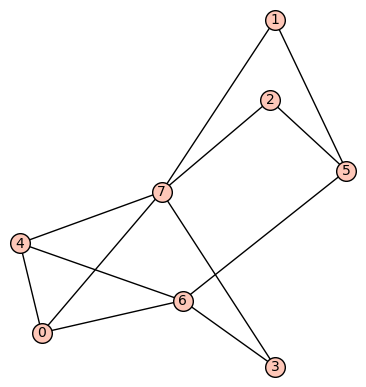

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 5, None), (1, 7, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None)]


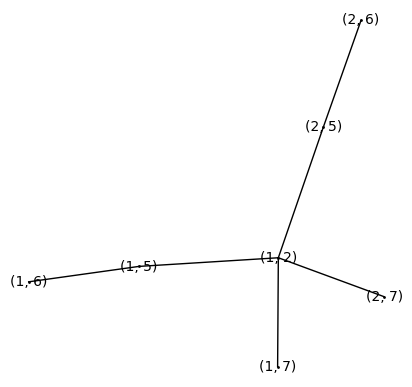

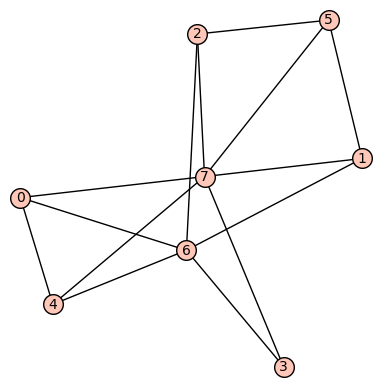

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


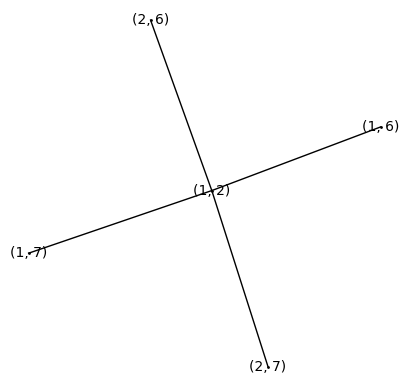

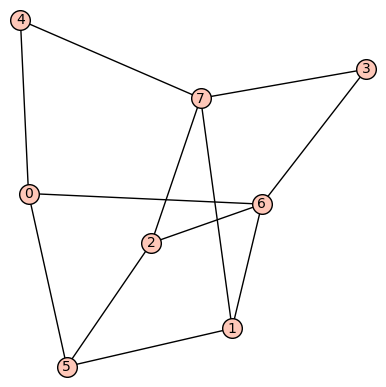

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None)]


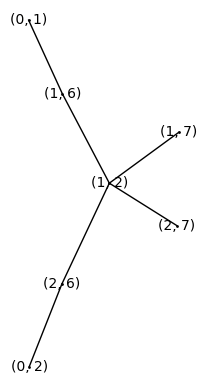

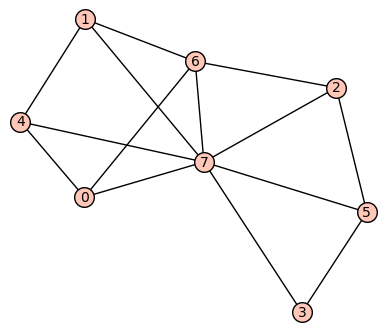

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


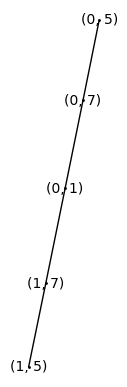

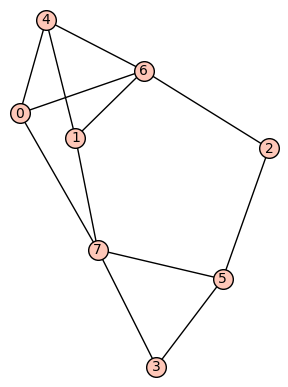

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 7, None), (4, 6, None), (5, 7, None)]


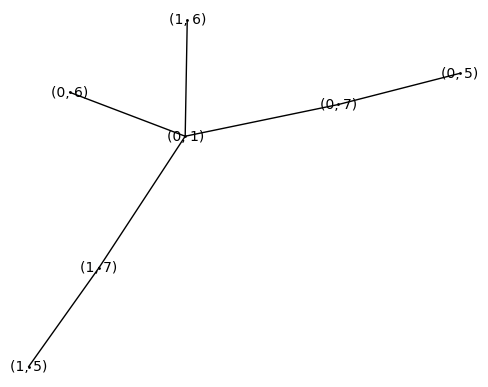

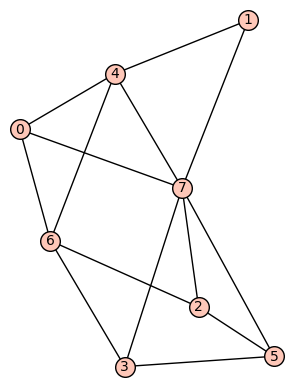

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


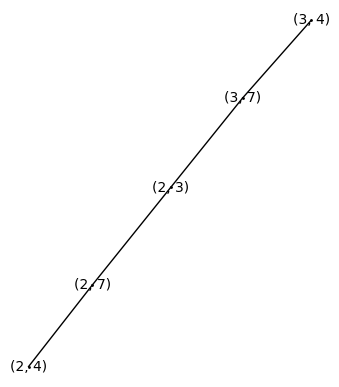

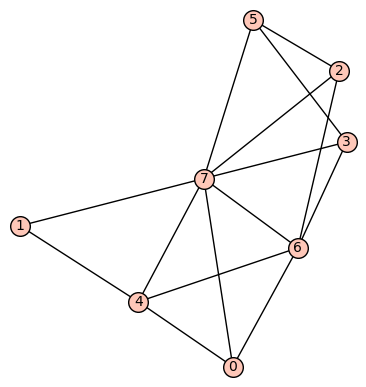

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


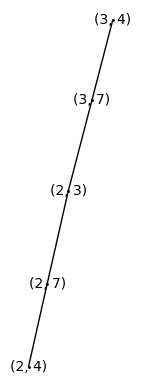

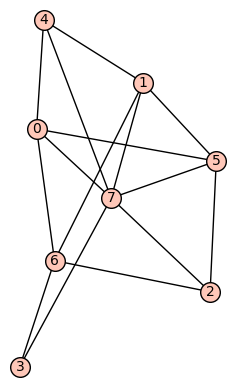

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


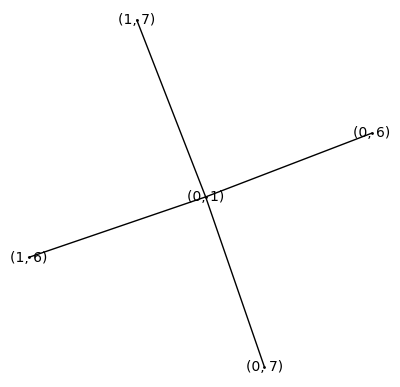

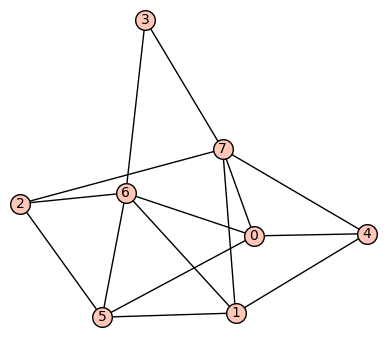

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None)]


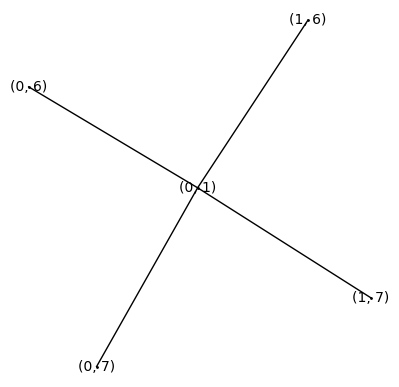

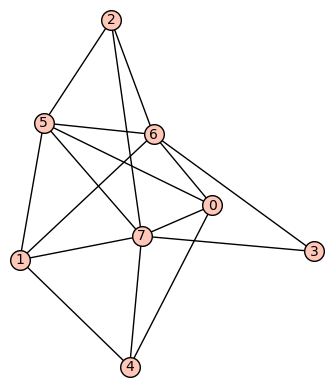

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


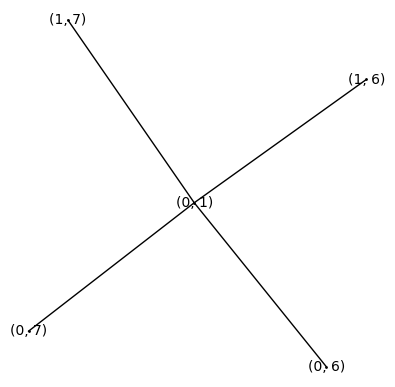

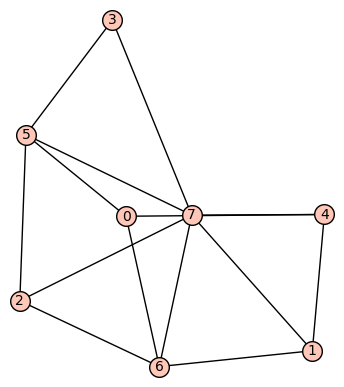

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


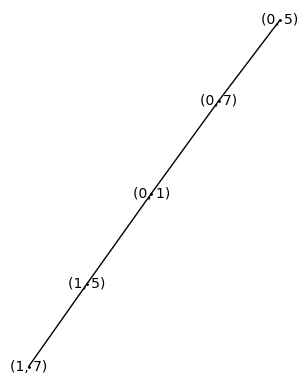

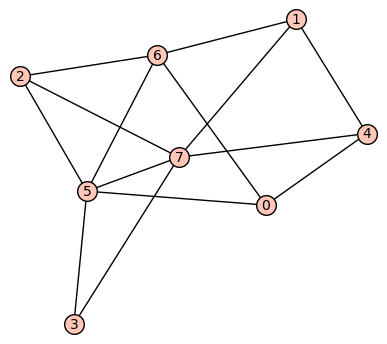

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


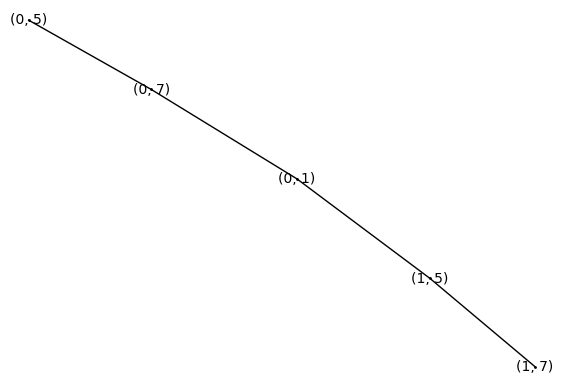

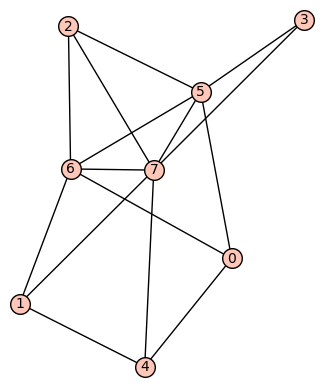

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


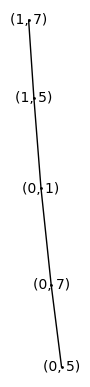

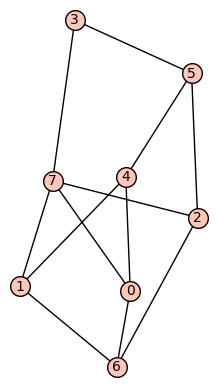

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 5, None)]


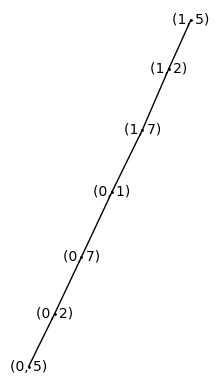

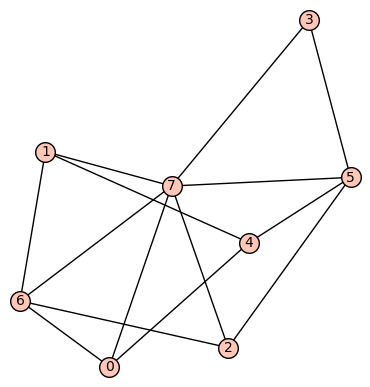

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 5, None), (5, 7, None), (6, 7, None)]


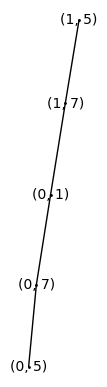

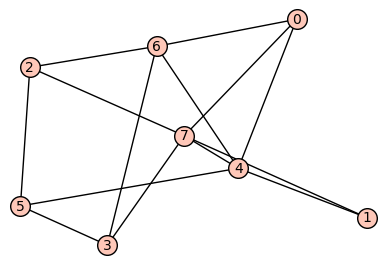

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None)]


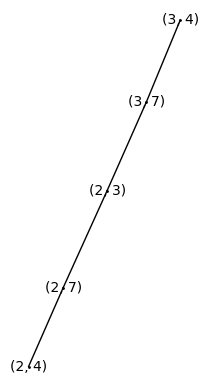

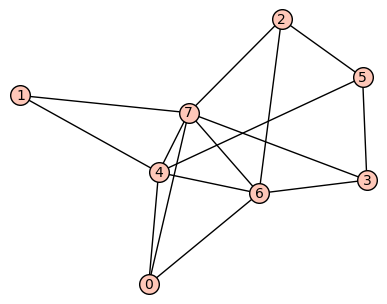

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


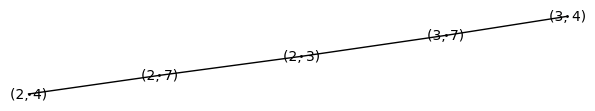

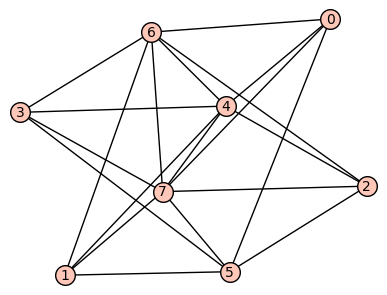

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


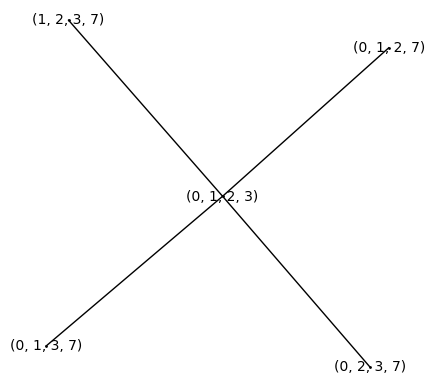

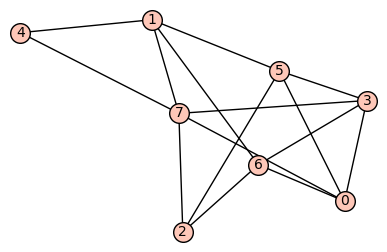

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None)]


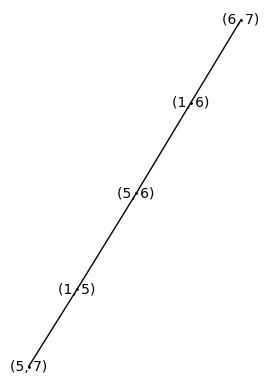

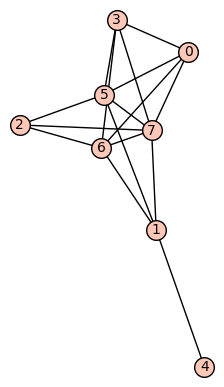

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 7, None), (6, 7, None)]


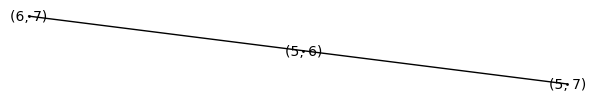

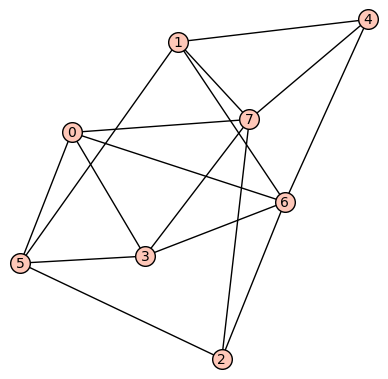

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None)]


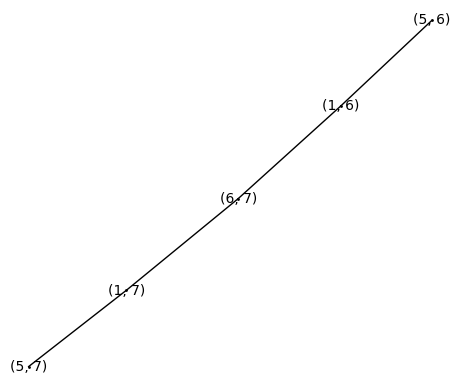

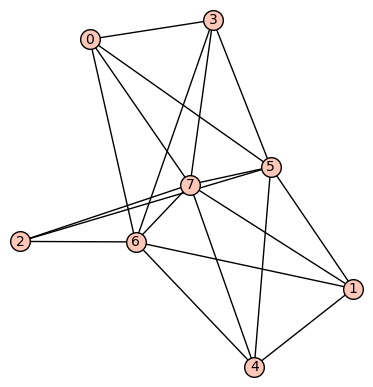

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


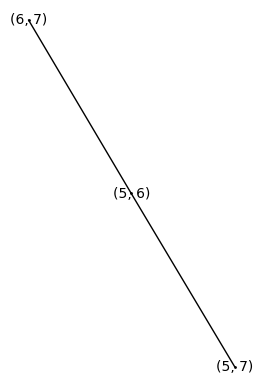

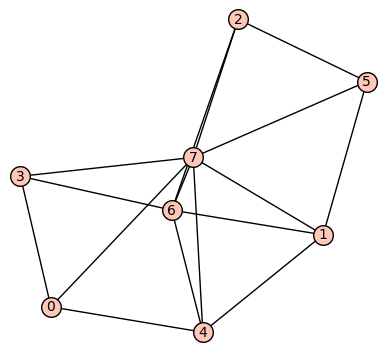

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


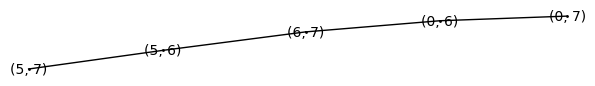

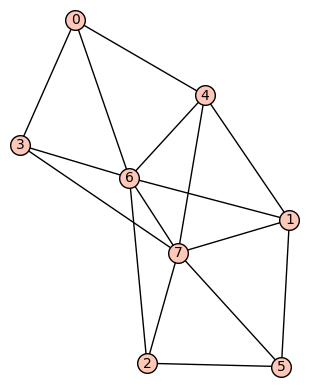

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


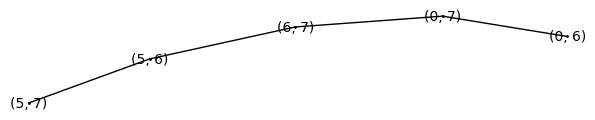

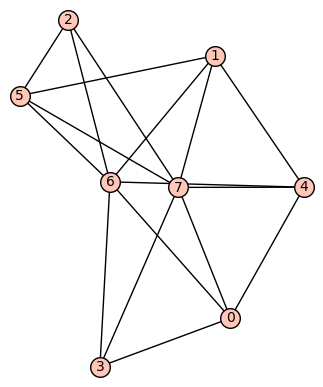

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


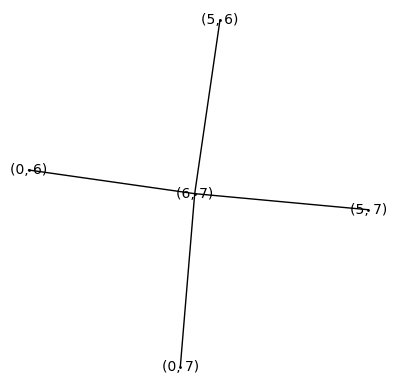

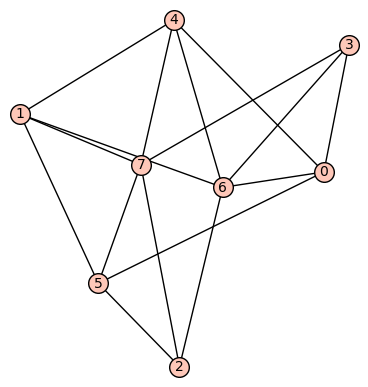

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


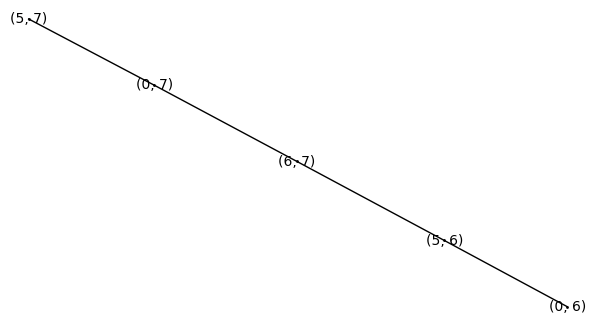

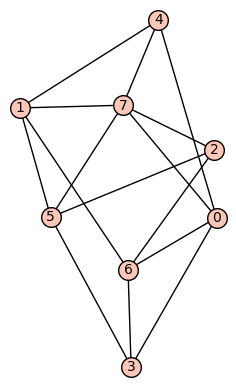

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None)]


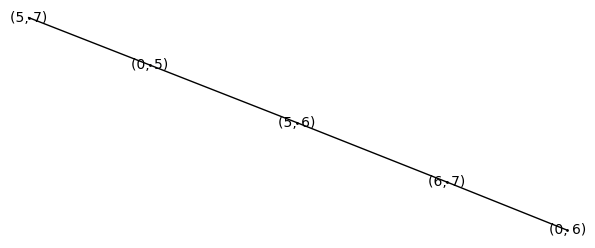

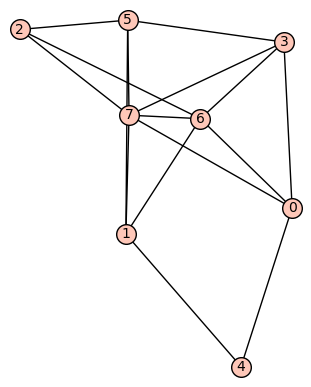

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 7, None), (6, 7, None)]


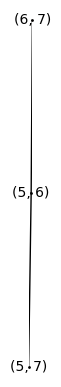

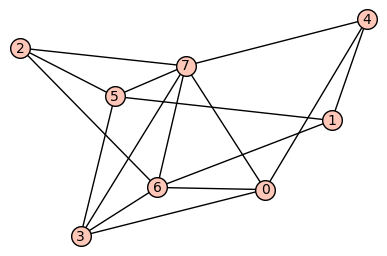

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


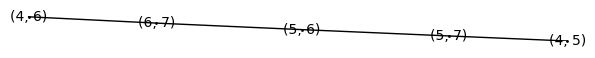

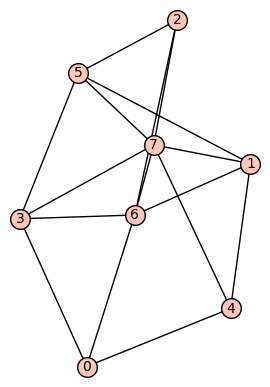

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


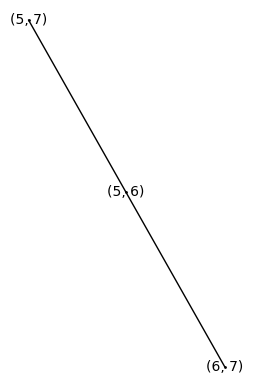

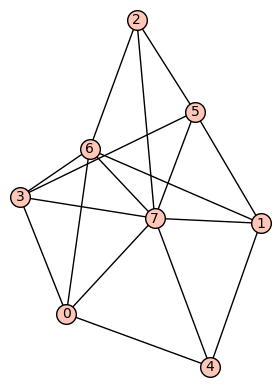

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


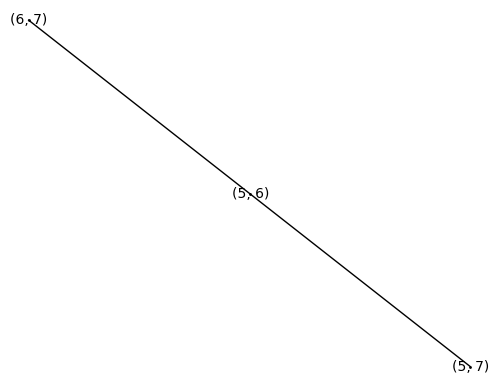

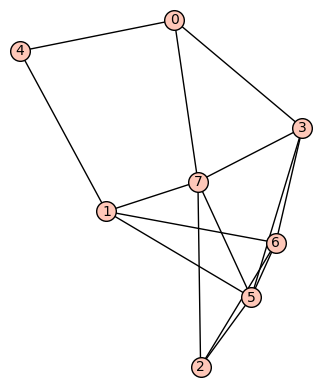

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 6, None), (5, 7, None)]


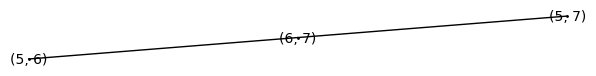

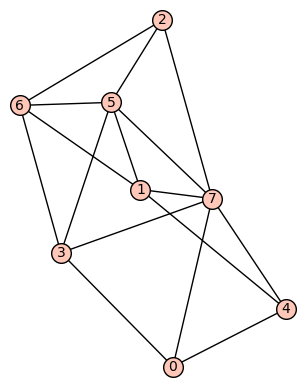

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


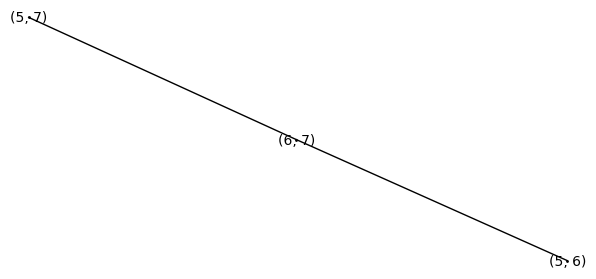

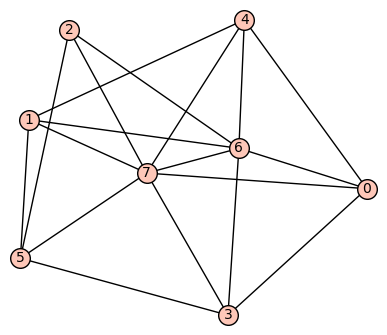

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


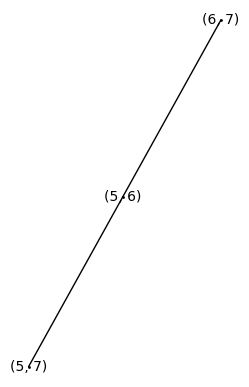

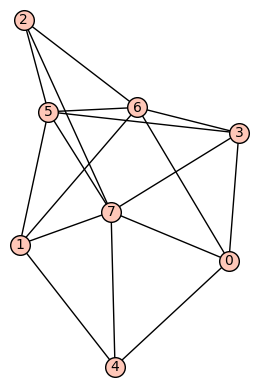

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


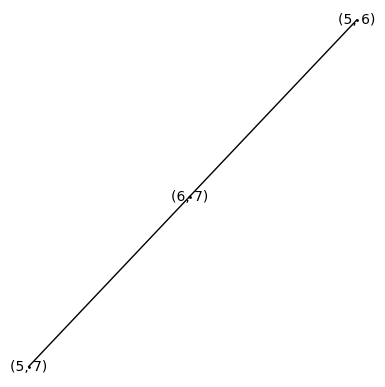

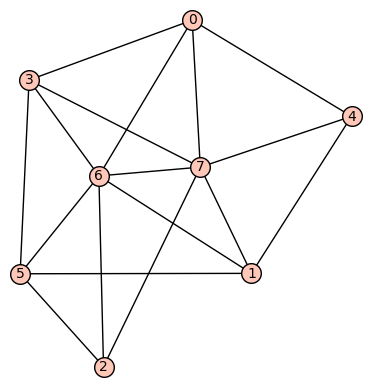

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (6, 7, None)]


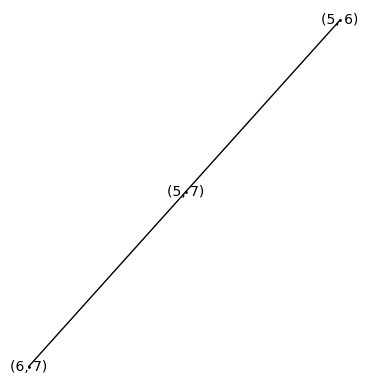

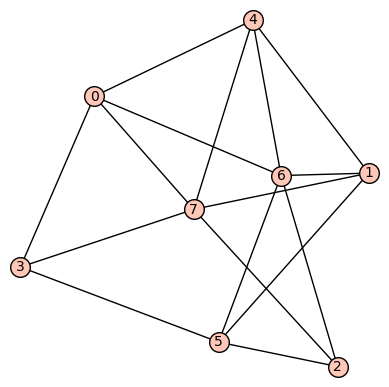

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None)]


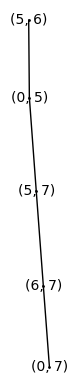

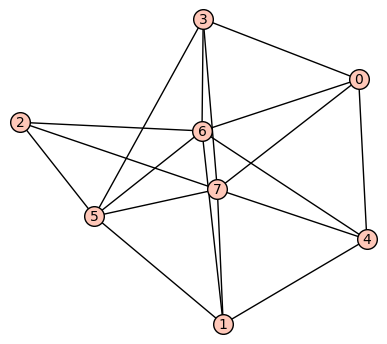

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


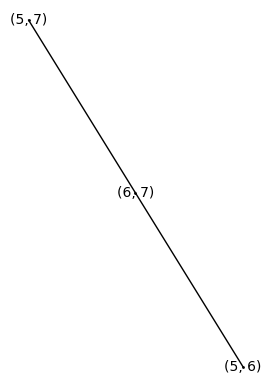

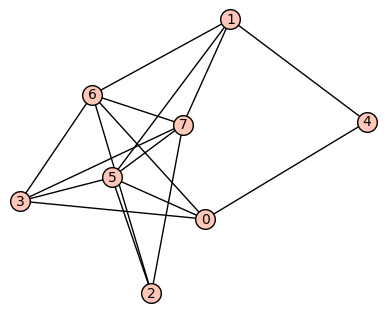

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 7, None), (6, 7, None)]


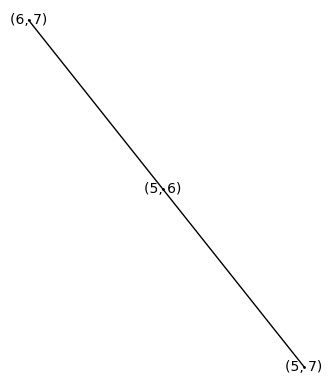

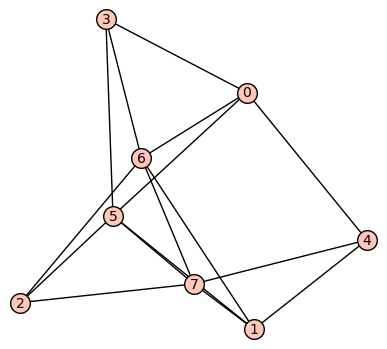

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


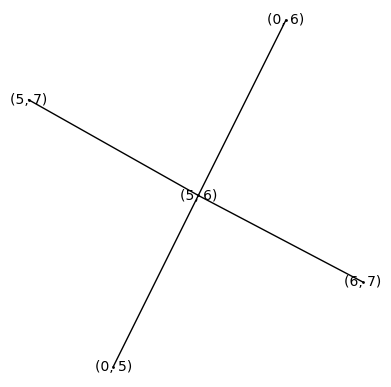

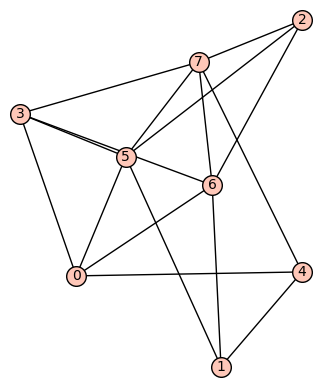

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


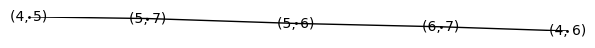

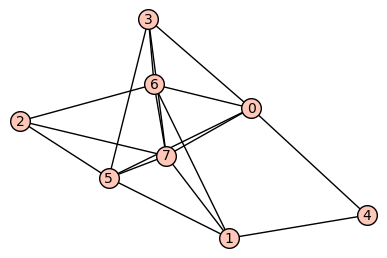

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 7, None), (6, 7, None)]


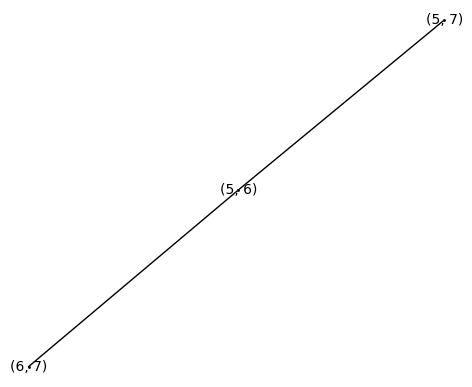

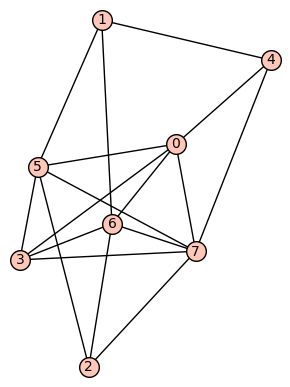

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


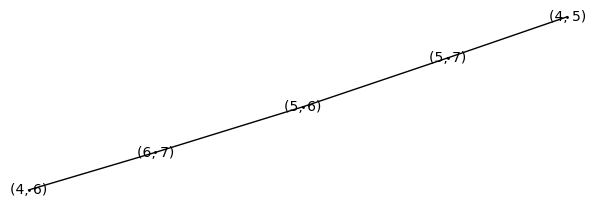

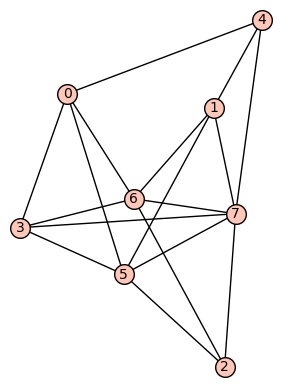

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


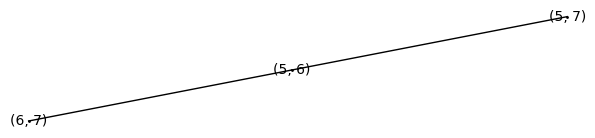

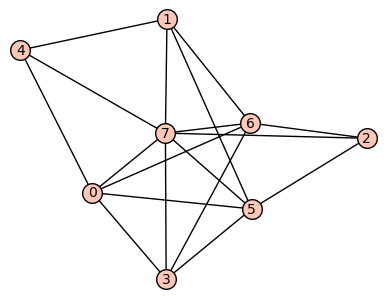

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


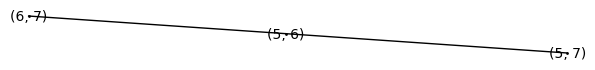

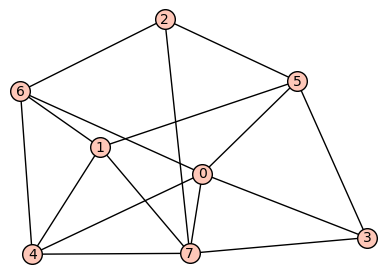

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None)]


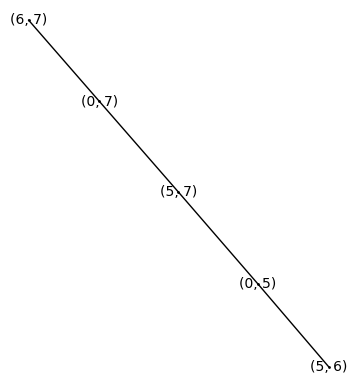

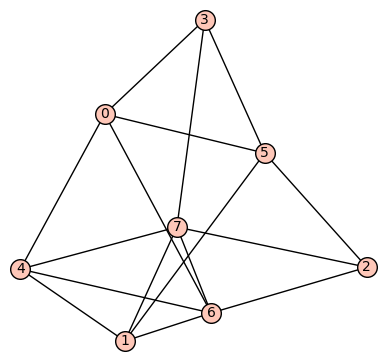

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (6, 7, None)]


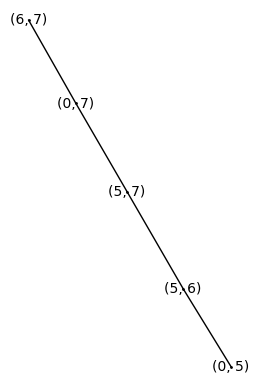

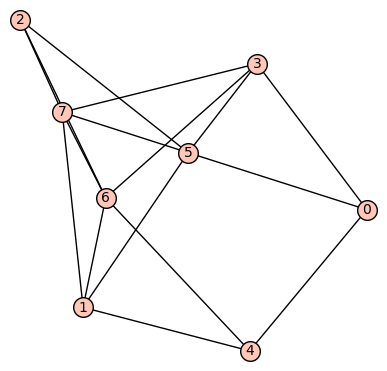

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


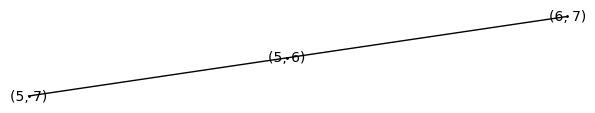

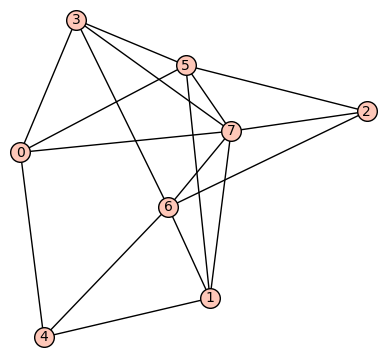

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


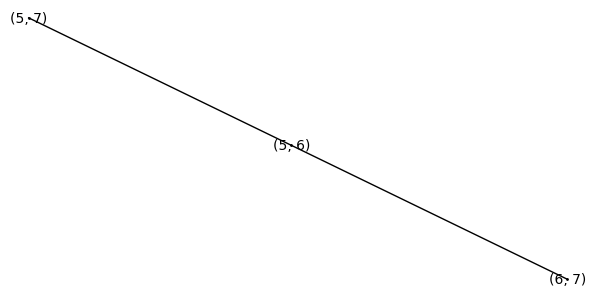

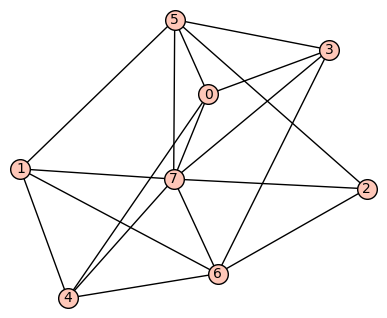

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


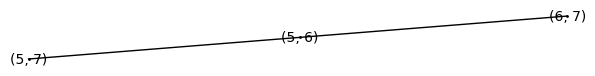

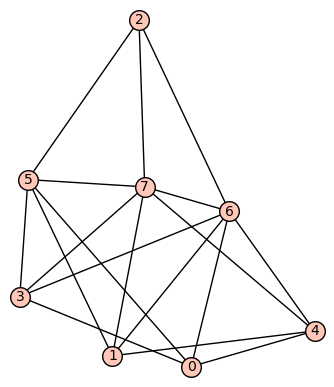

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


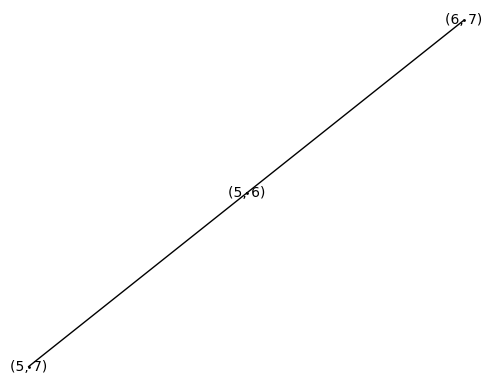

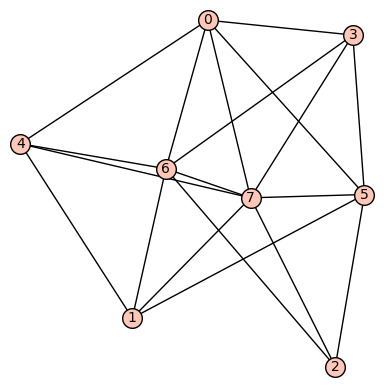

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


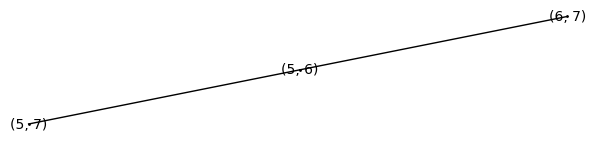

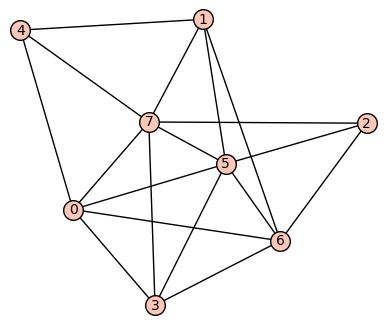

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


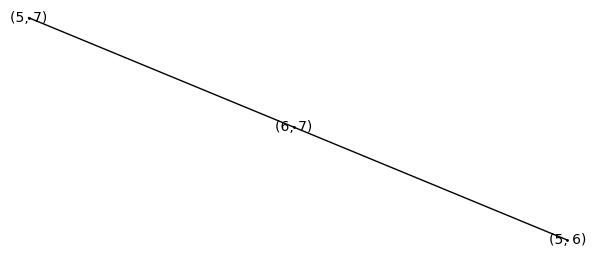

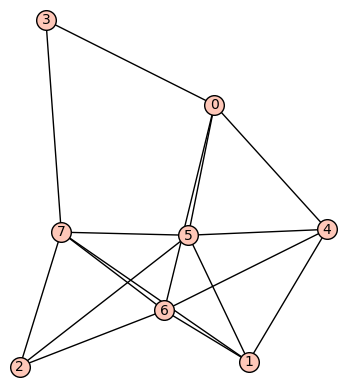

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


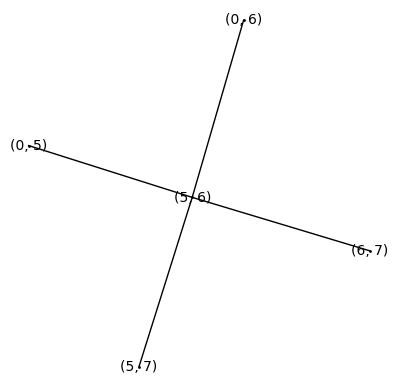

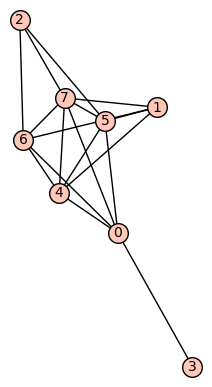

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


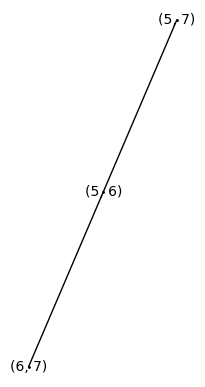

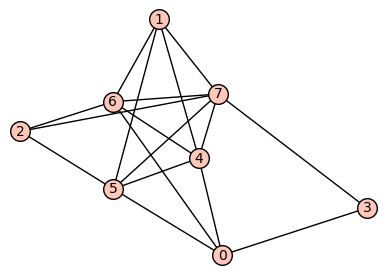

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


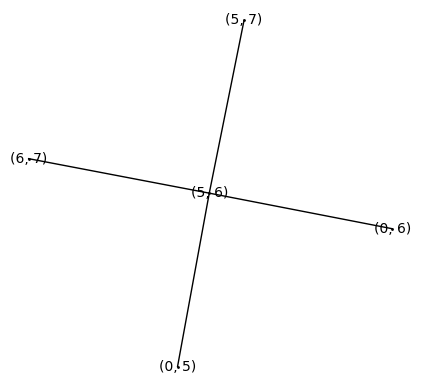

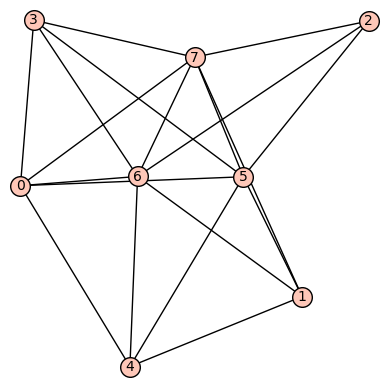

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


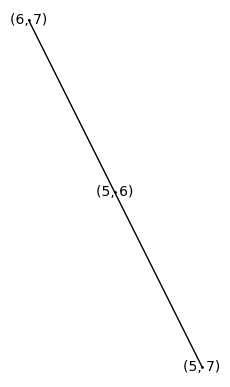

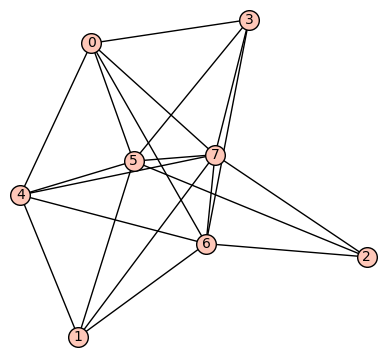

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


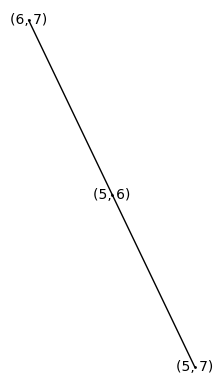

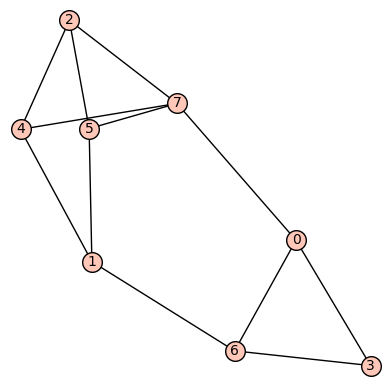

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None)]


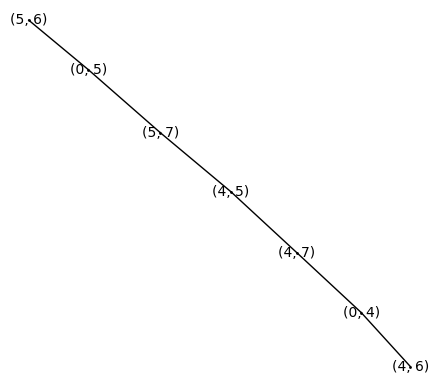

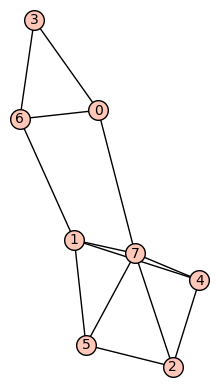

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None)]


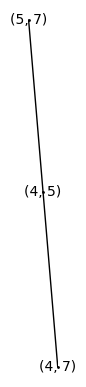

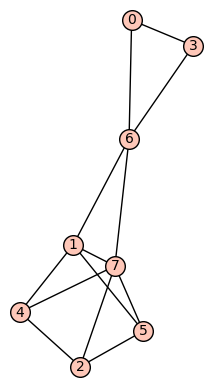

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


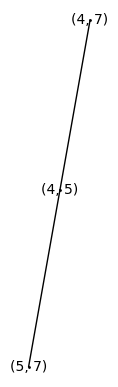

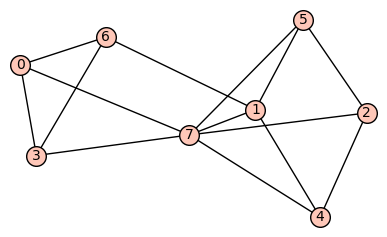

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


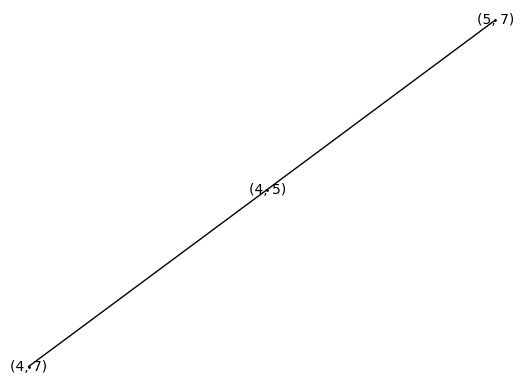

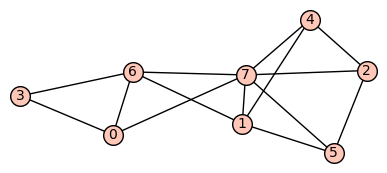

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


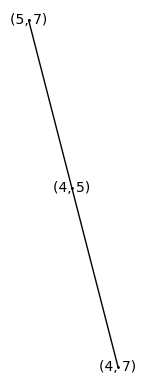

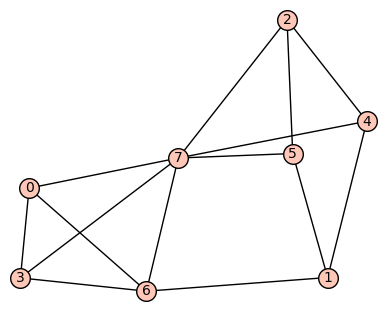

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


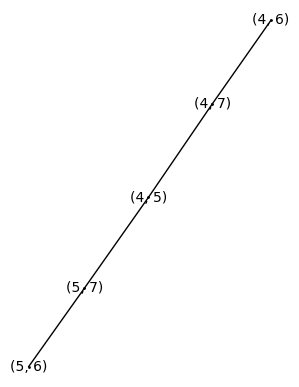

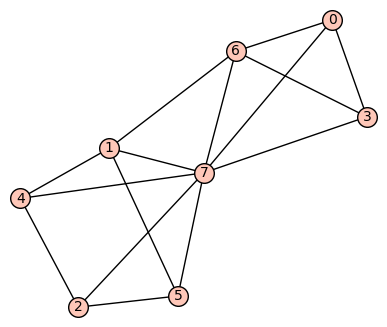

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


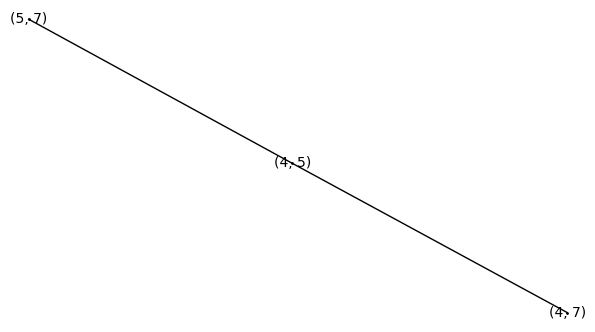

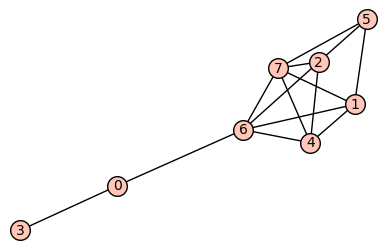

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


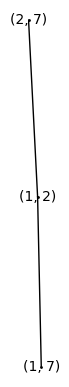

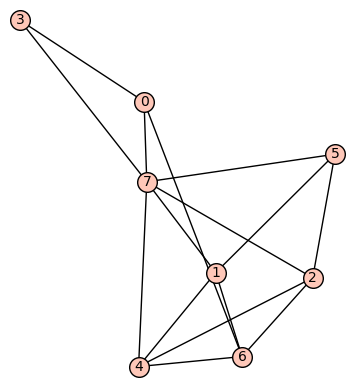

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


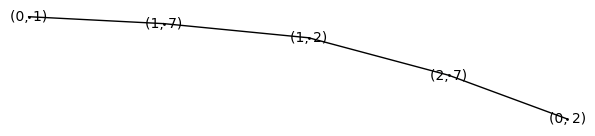

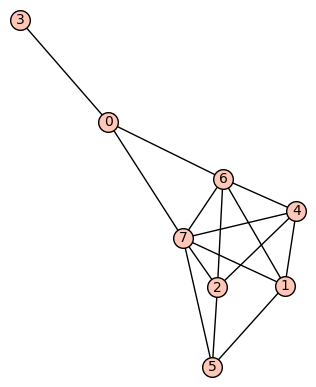

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


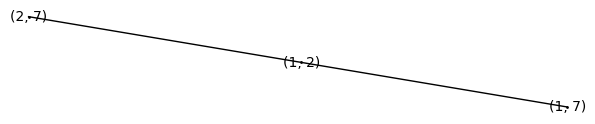

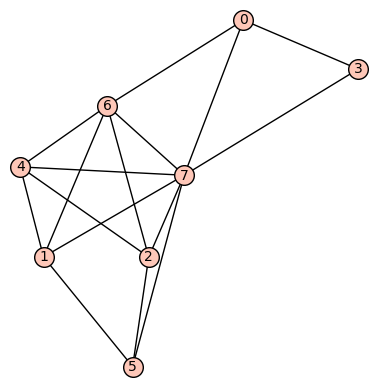

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


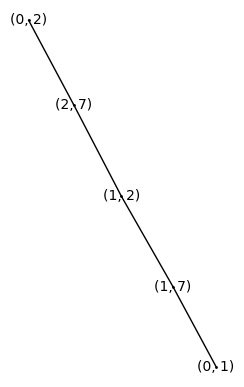

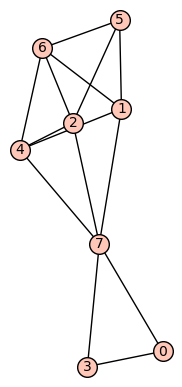

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None)]


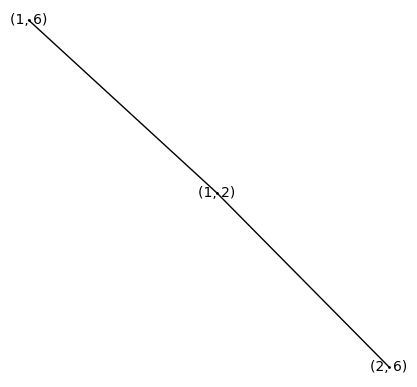

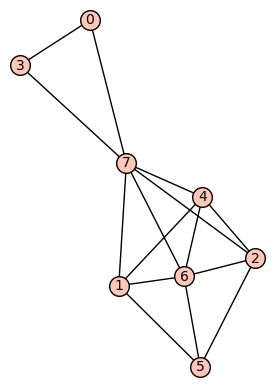

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


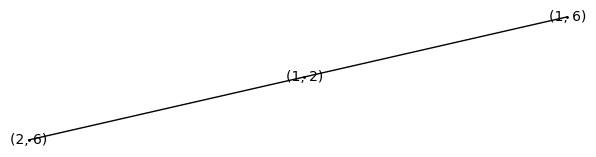

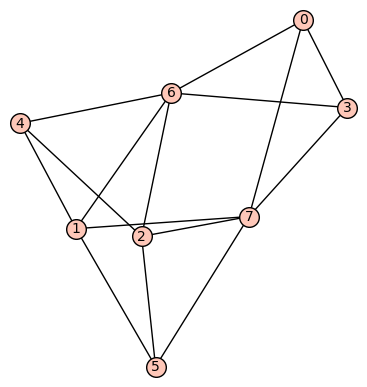

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None)]


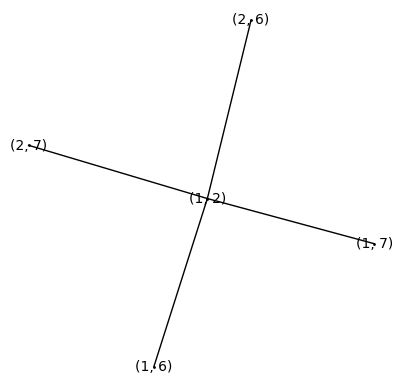

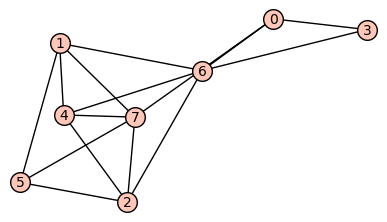

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None)]


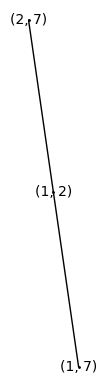

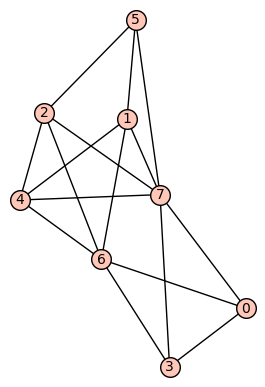

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


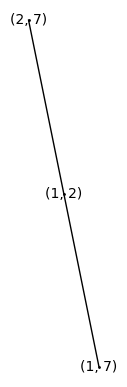

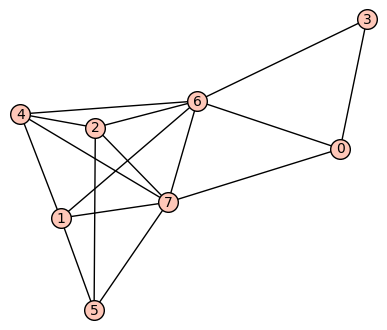

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


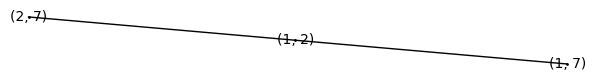

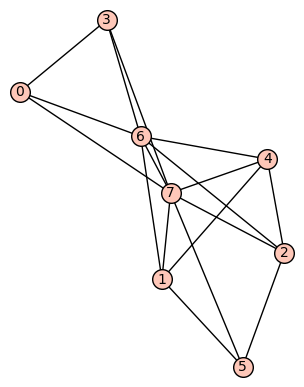

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


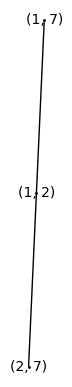

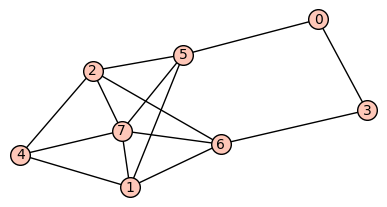

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


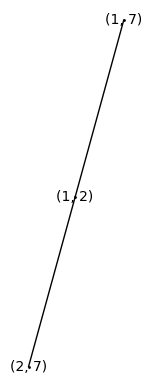

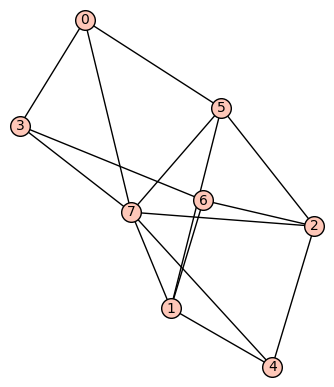

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


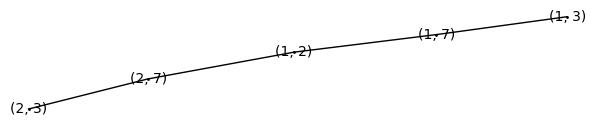

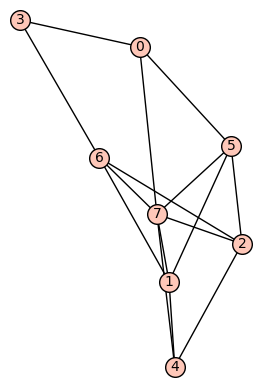

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


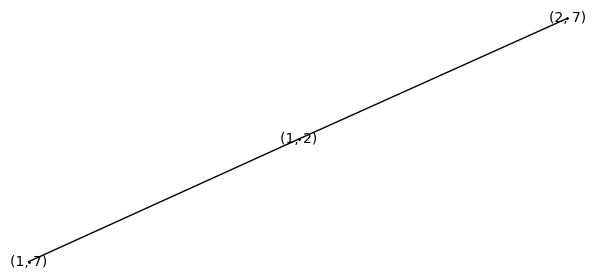

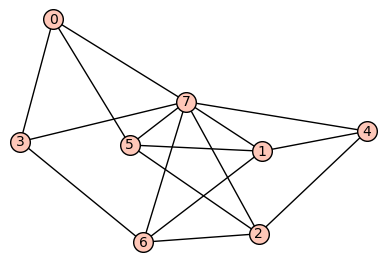

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


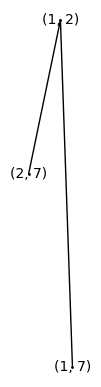

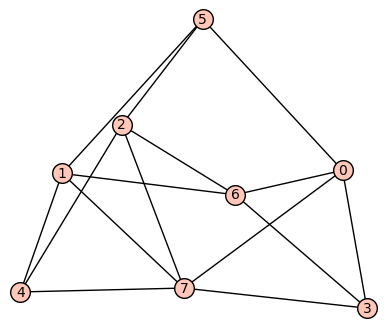

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None)]


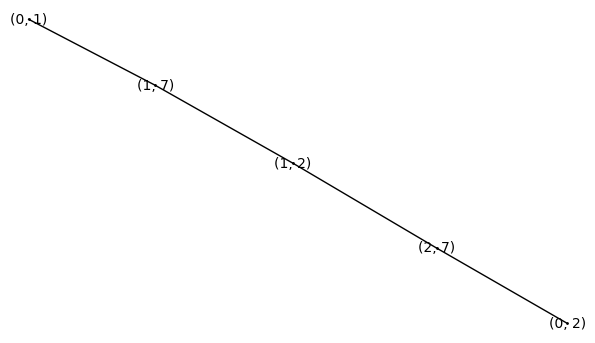

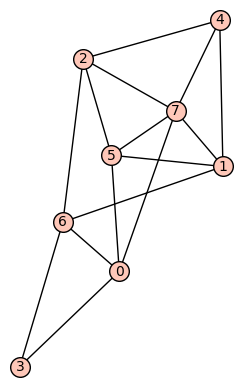

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None)]


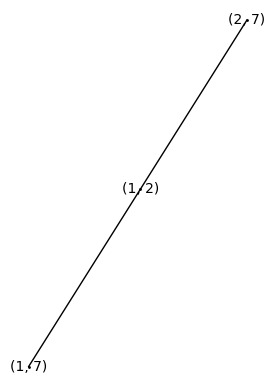

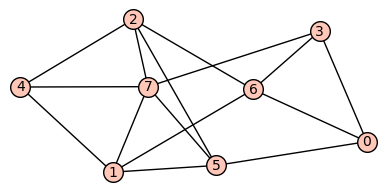

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


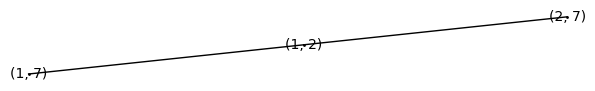

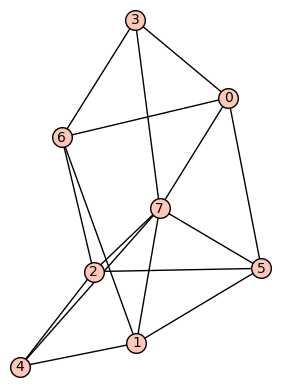

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


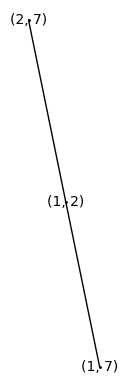

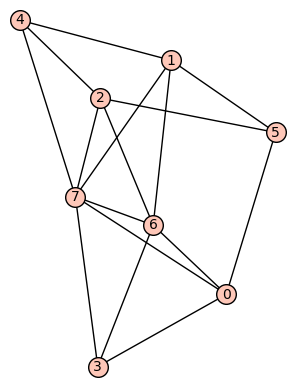

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (6, 7, None)]


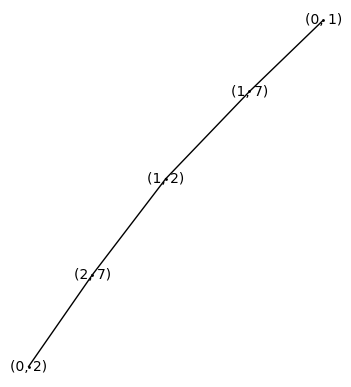

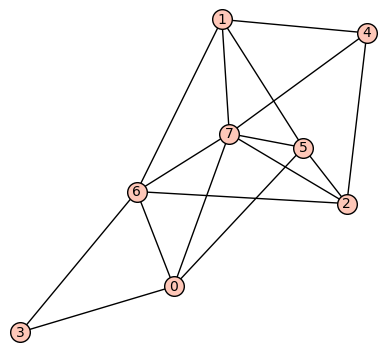

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


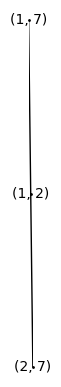

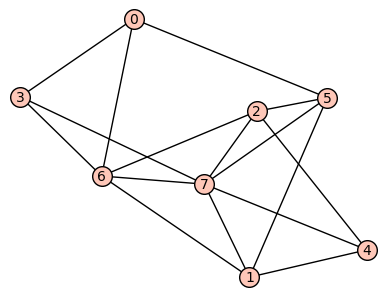

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


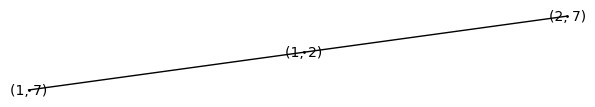

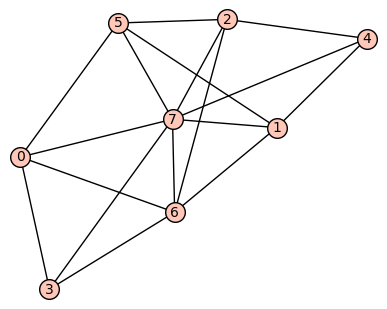

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


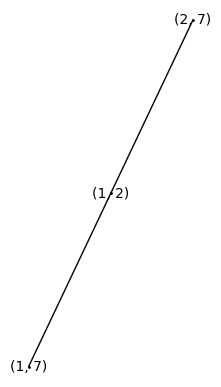

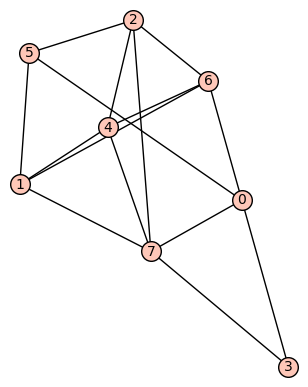

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None)]


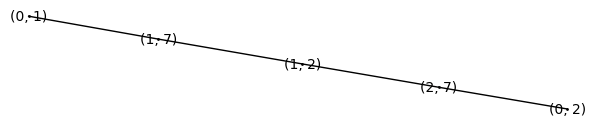

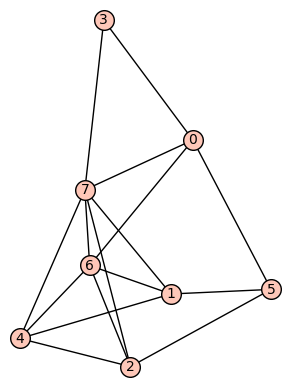

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (6, 7, None)]


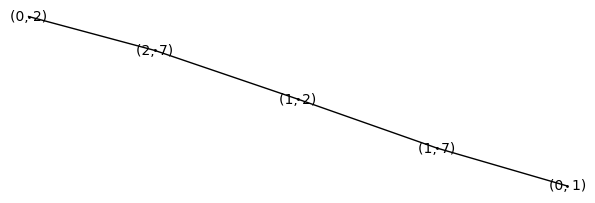

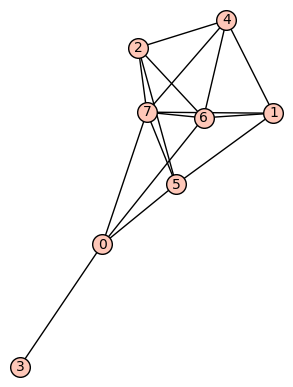

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


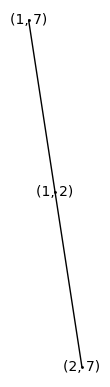

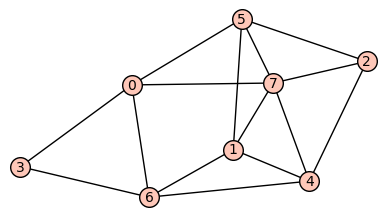

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None)]


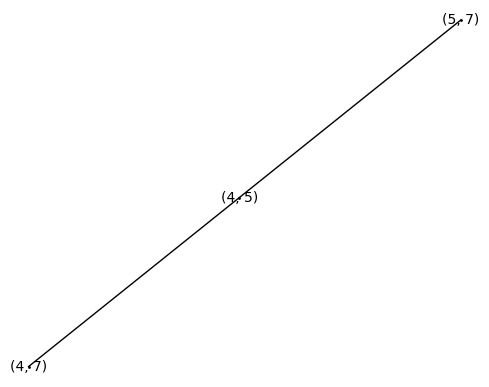

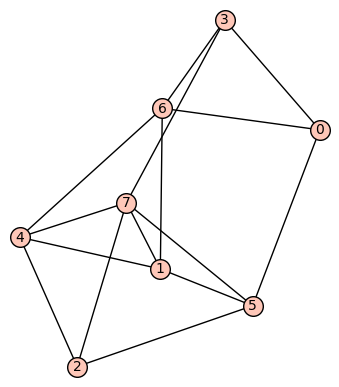

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


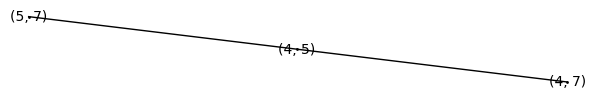

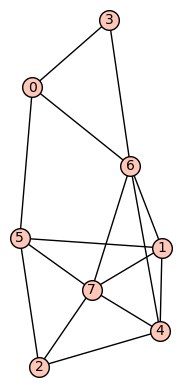

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


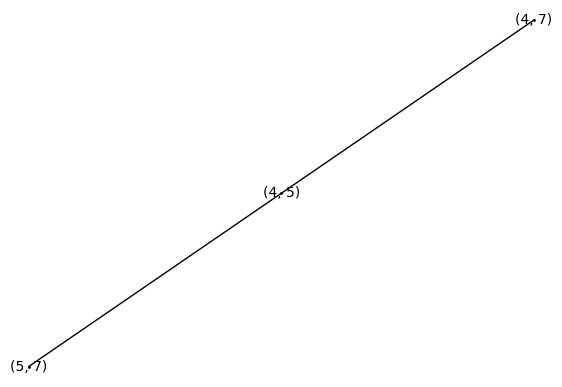

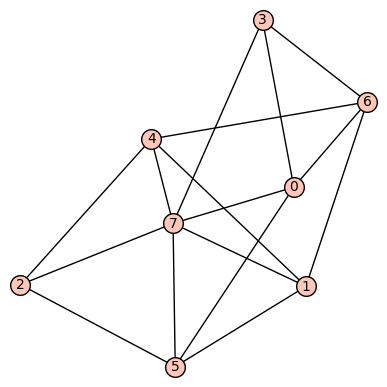

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


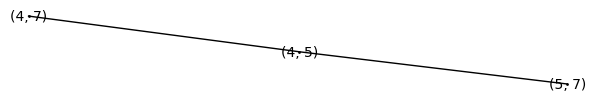

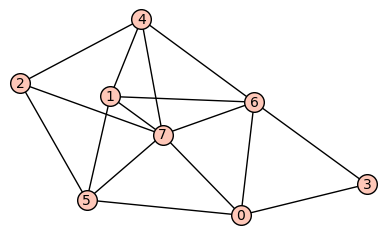

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


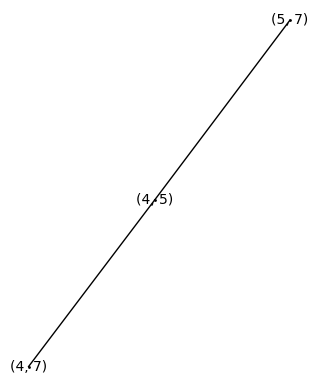

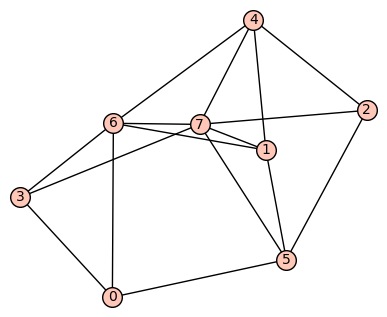

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


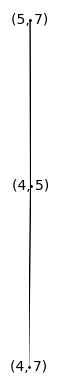

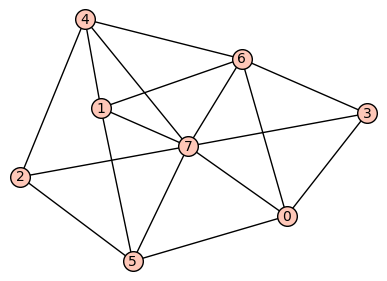

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


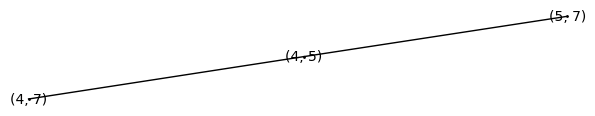

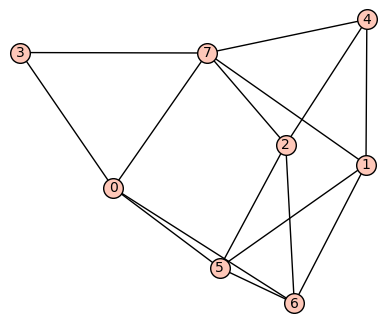

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 7, None), (5, 6, None)]


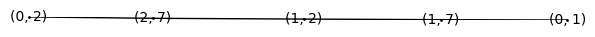

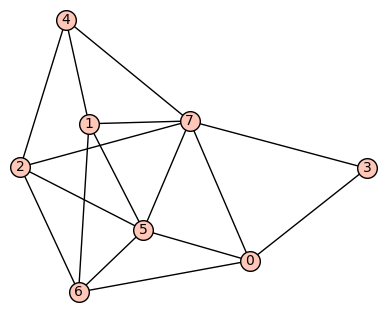

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


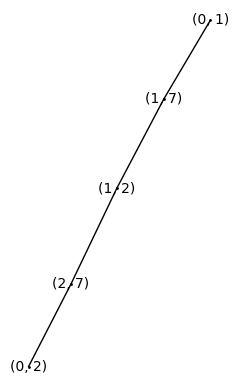

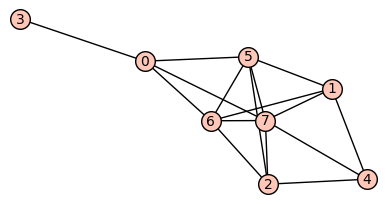

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


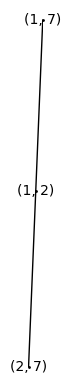

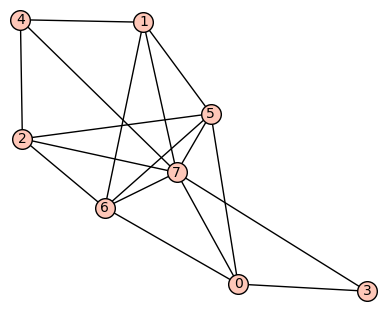

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


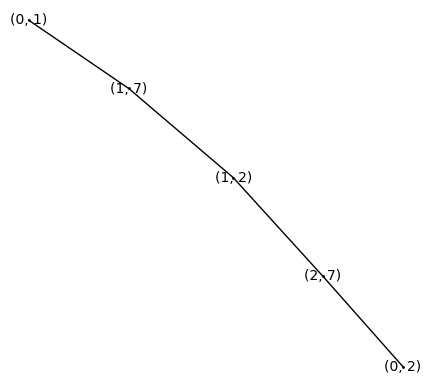

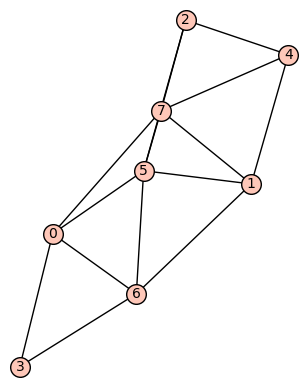

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


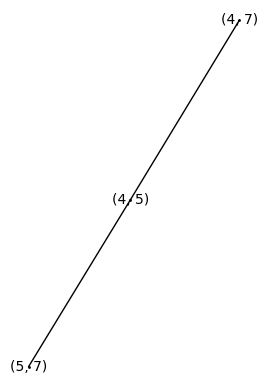

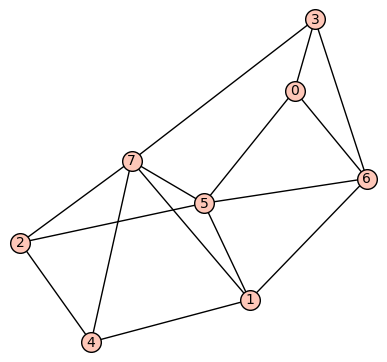

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


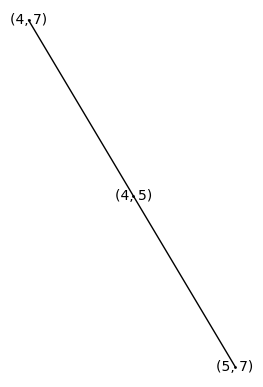

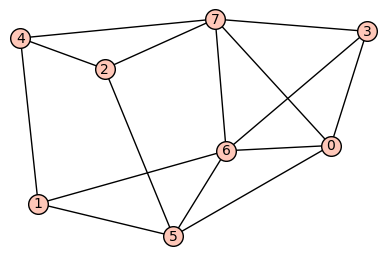

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (6, 7, None)]


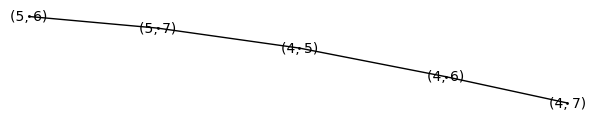

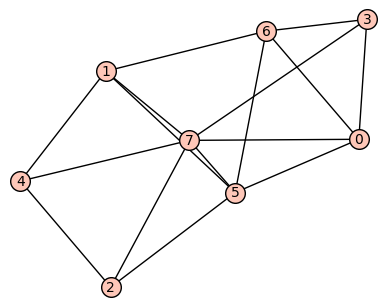

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


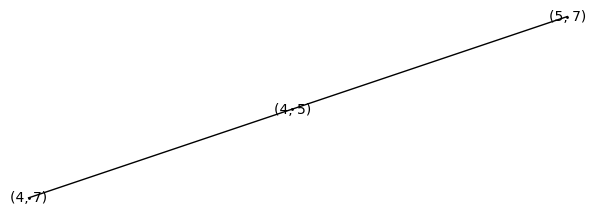

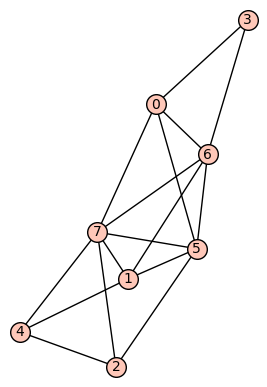

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


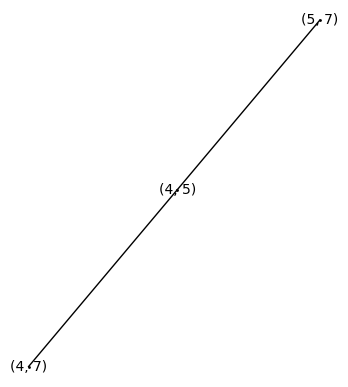

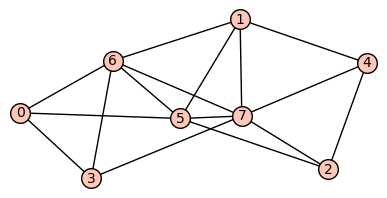

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


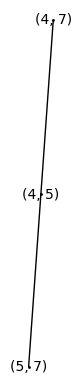

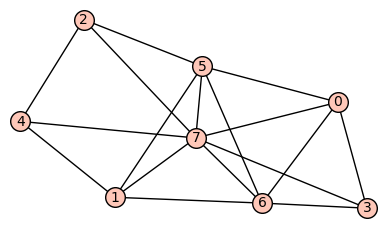

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


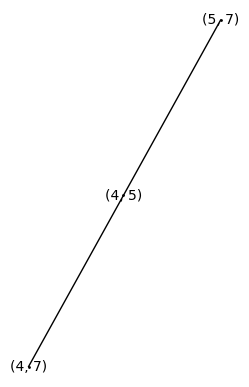

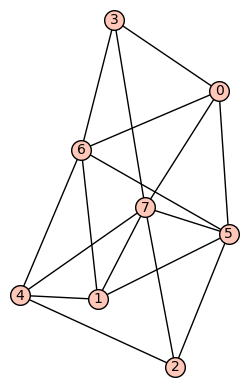

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


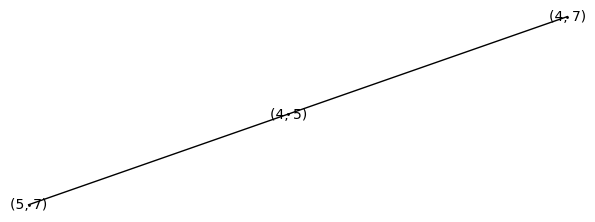

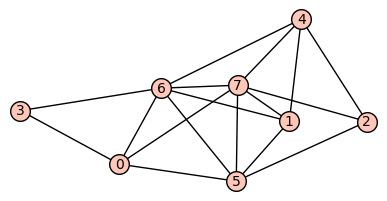

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


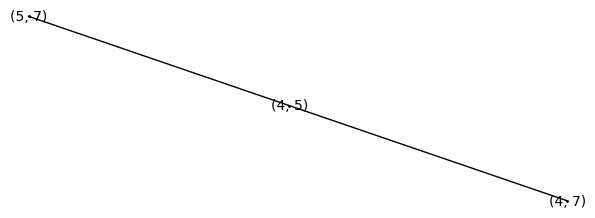

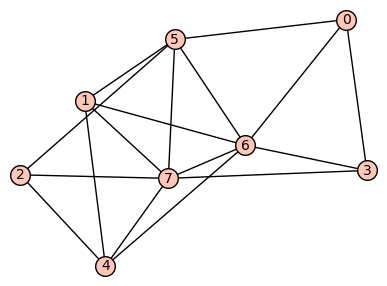

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


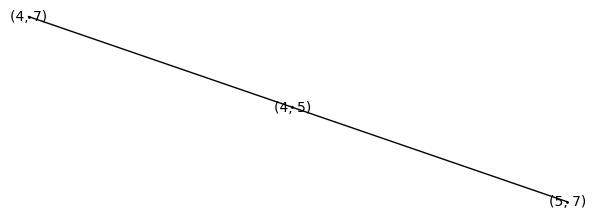

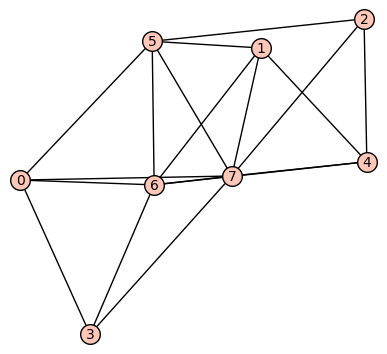

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


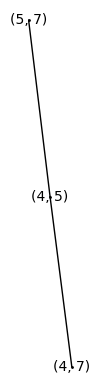

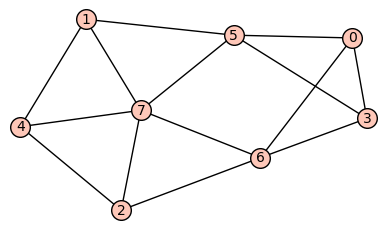

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


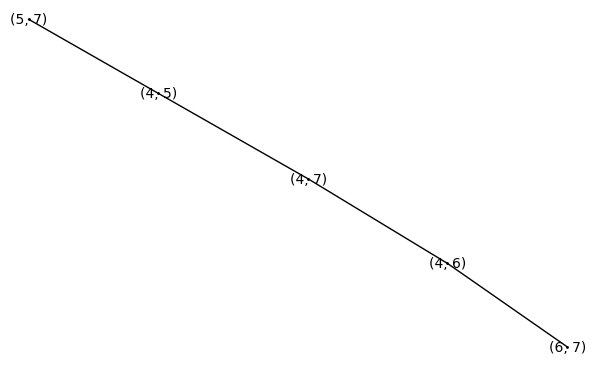

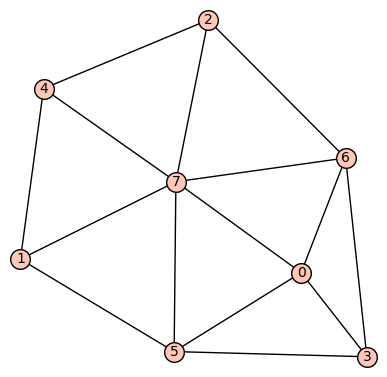

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


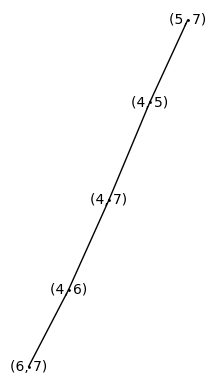

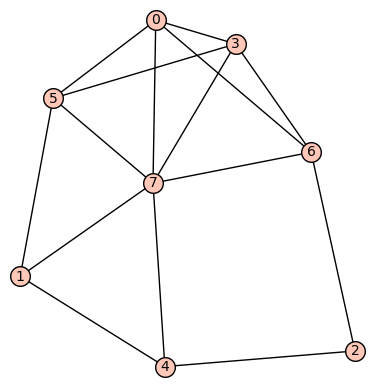

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


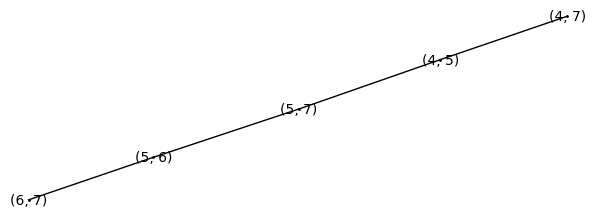

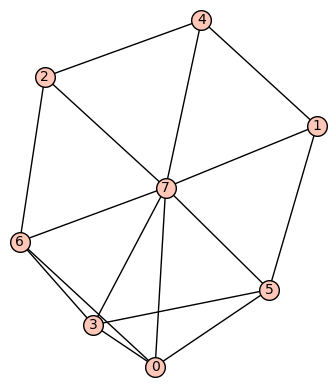

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


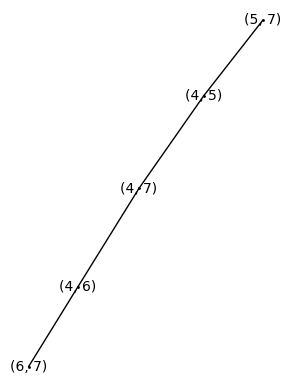

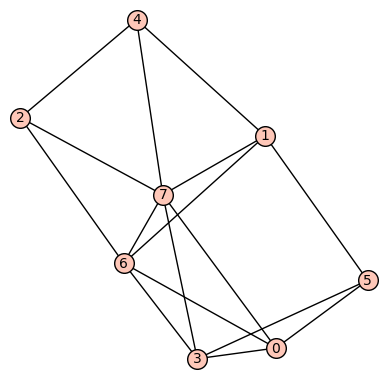

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (6, 7, None)]


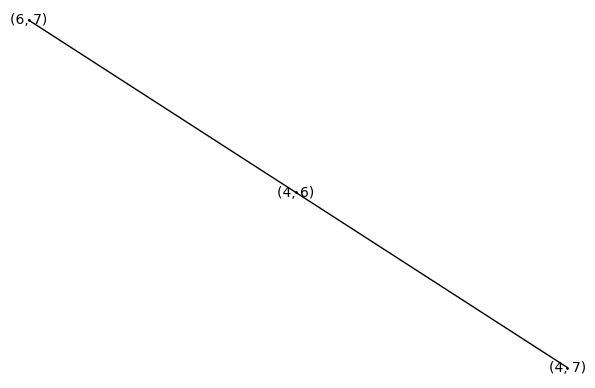

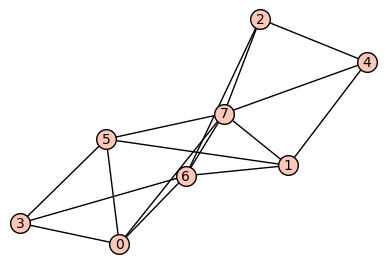

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


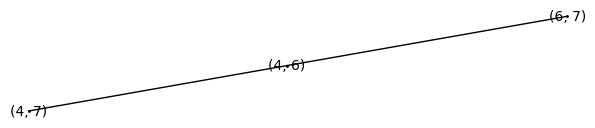

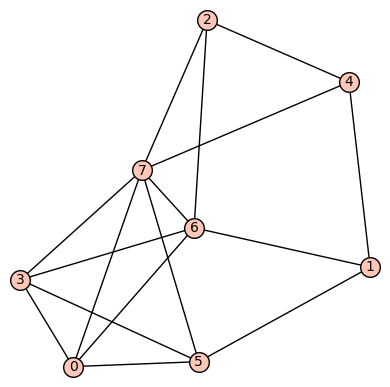

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


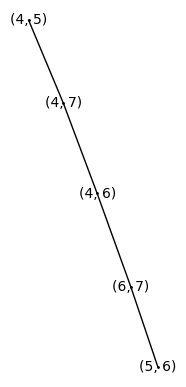

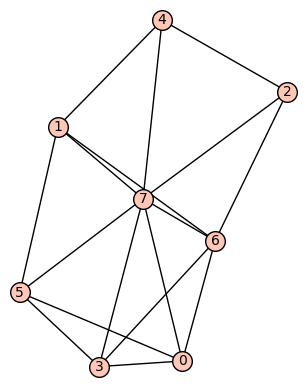

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


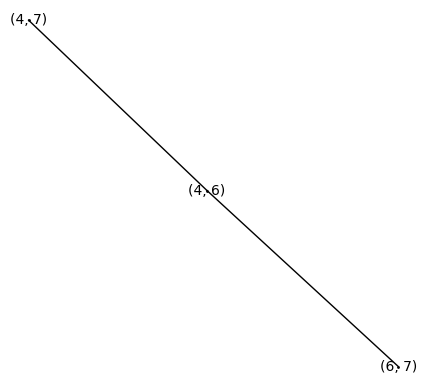

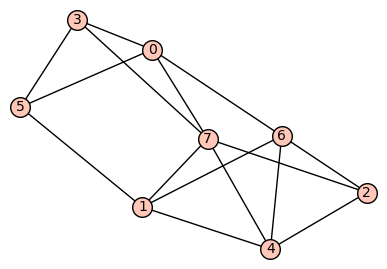

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None)]


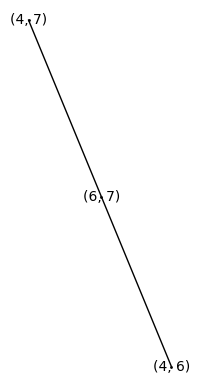

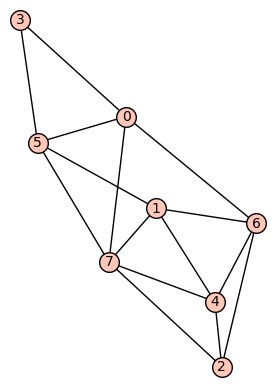

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


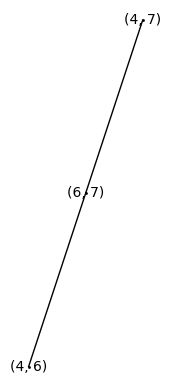

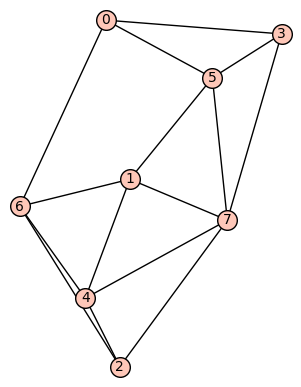

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


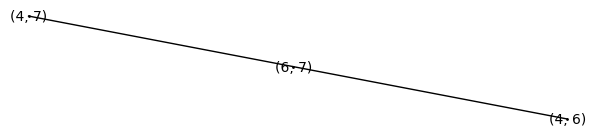

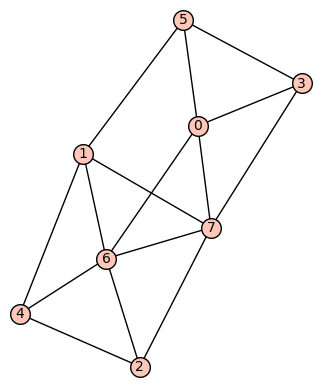

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (6, 7, None)]


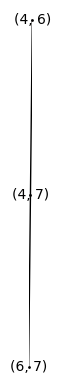

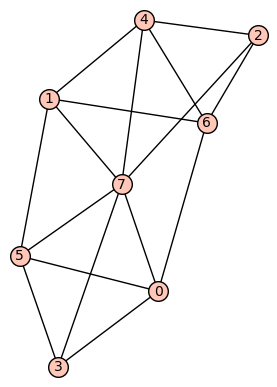

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


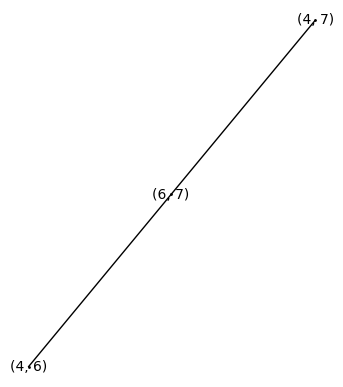

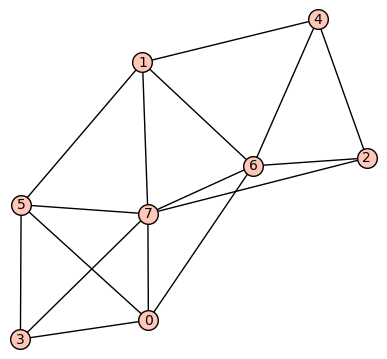

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


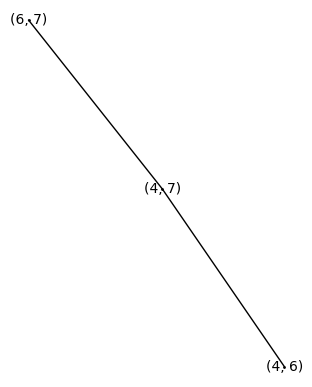

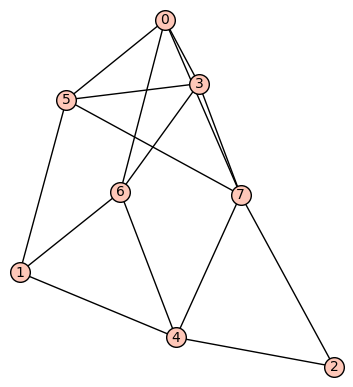

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


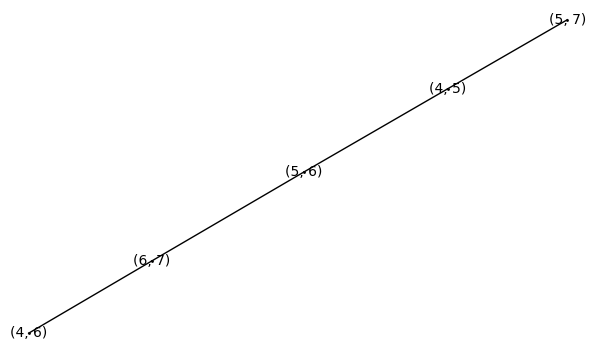

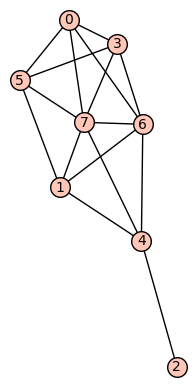

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


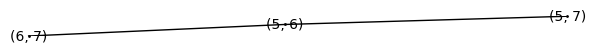

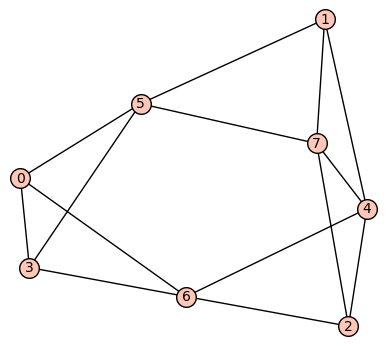

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None)]


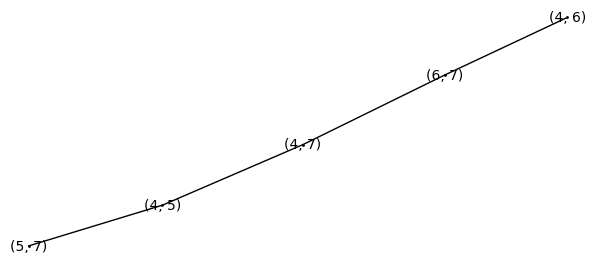

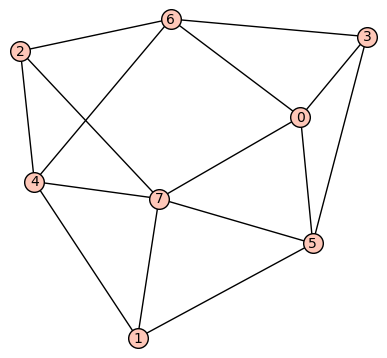

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None)]


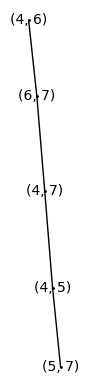

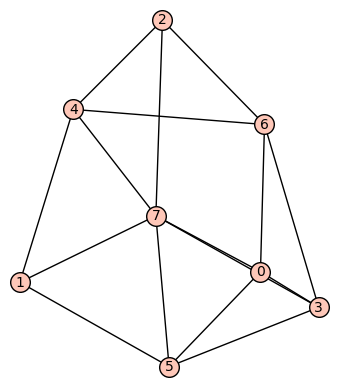

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


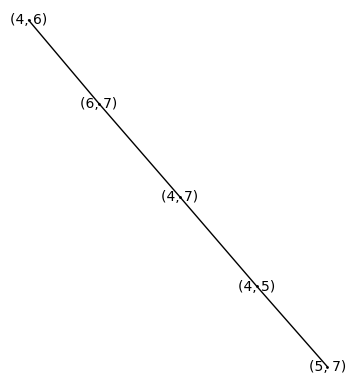

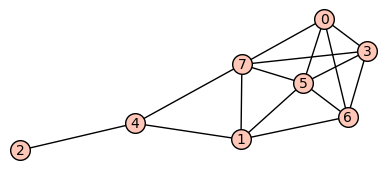

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


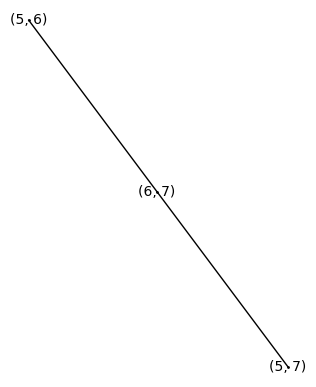

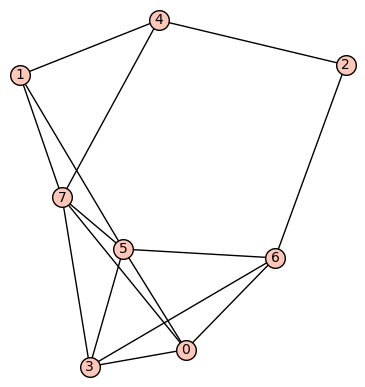

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


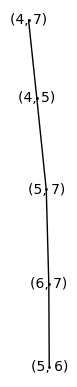

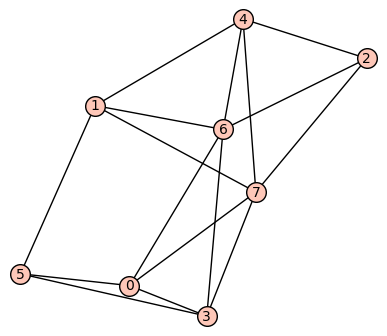

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None)]


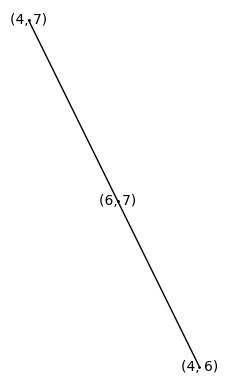

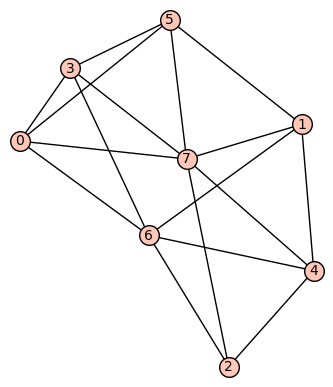

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


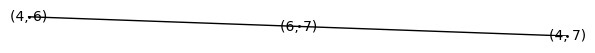

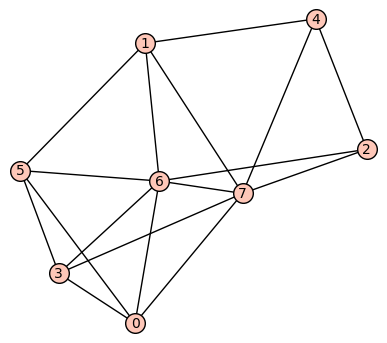

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (6, 7, None)]


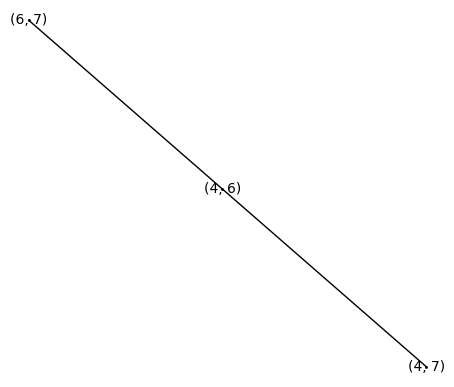

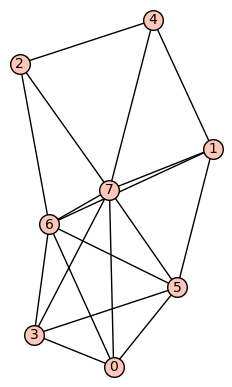

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


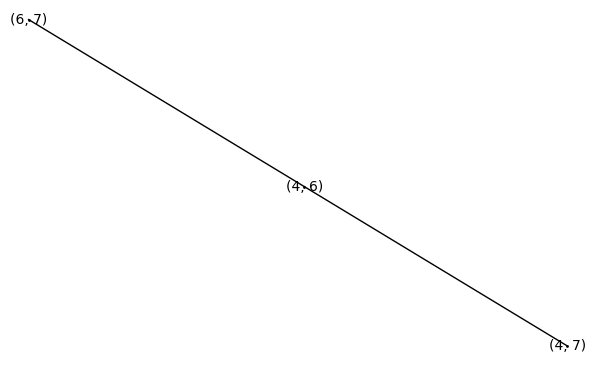

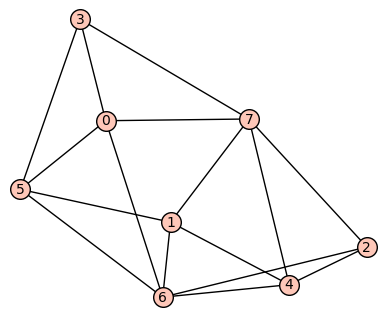

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None)]


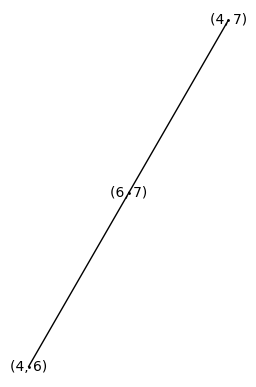

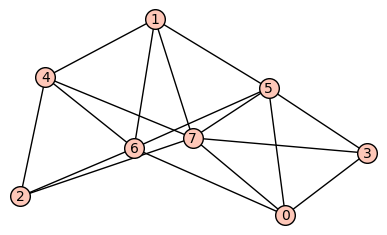

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


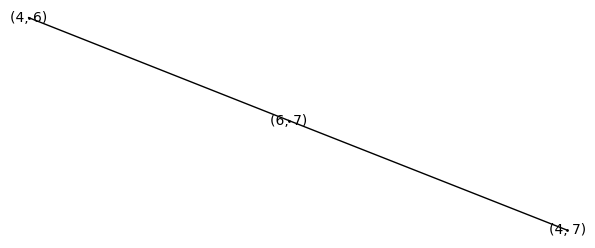

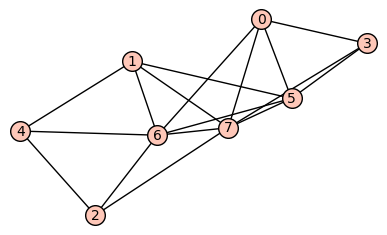

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (5, 6, None), (5, 7, None), (6, 7, None)]


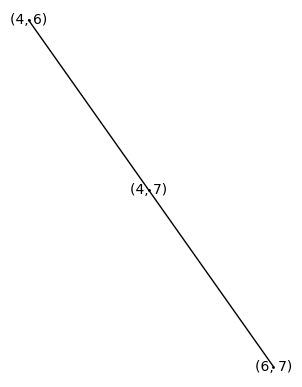

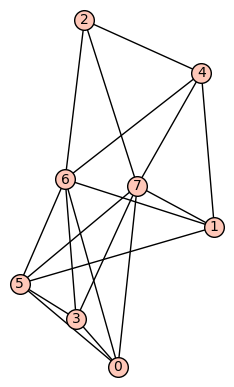

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


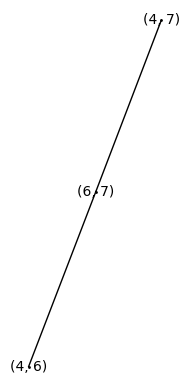

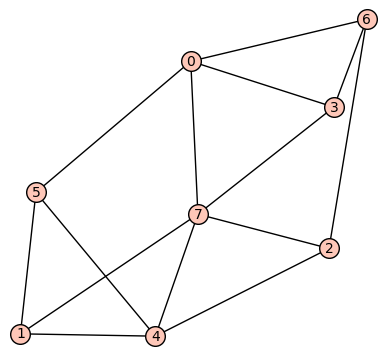

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None)]


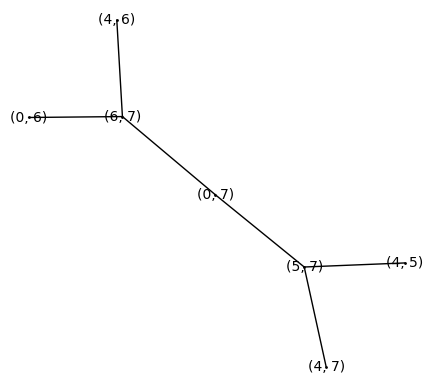

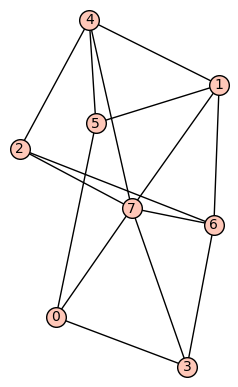

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


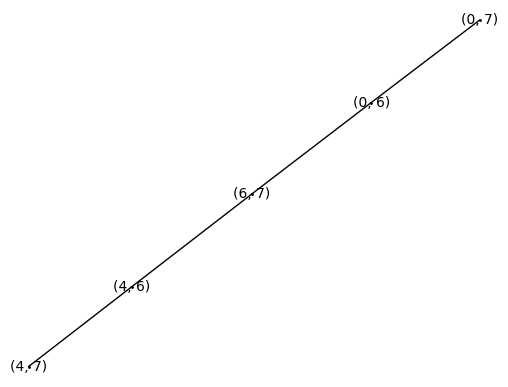

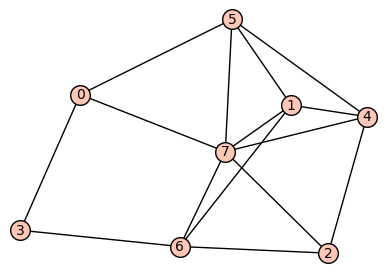

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


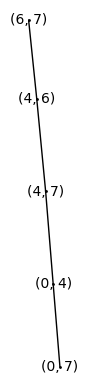

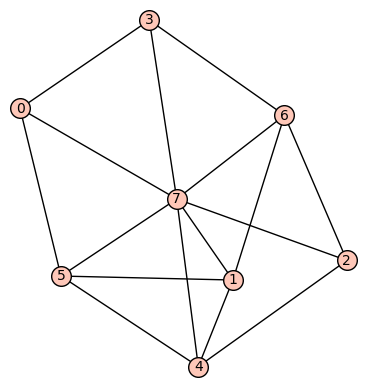

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


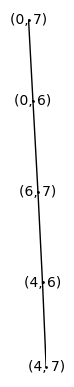

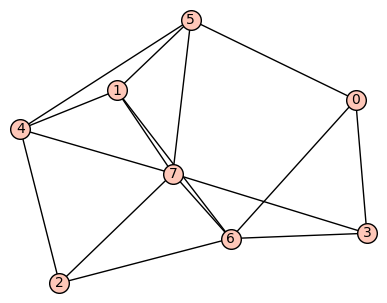

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


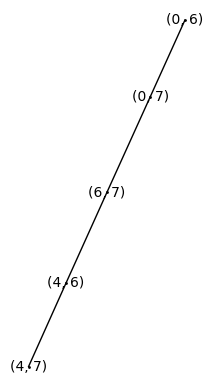

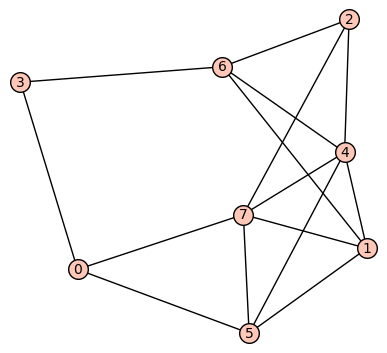

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


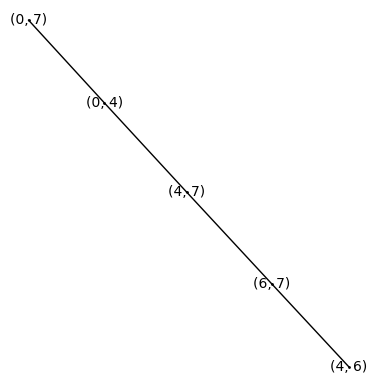

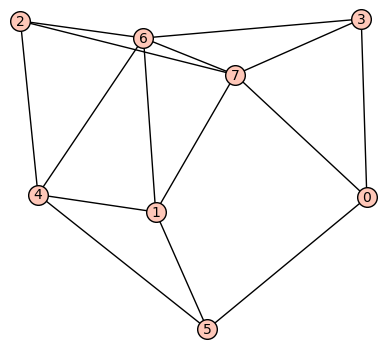

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (6, 7, None)]


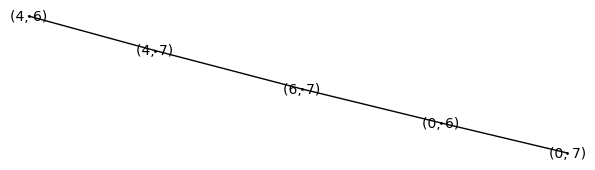

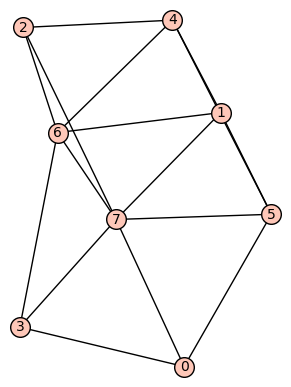

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


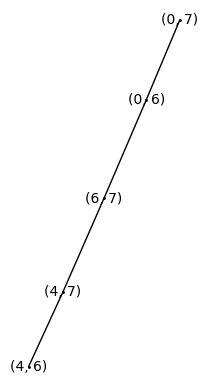

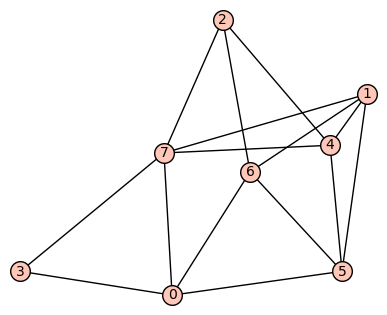

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None)]


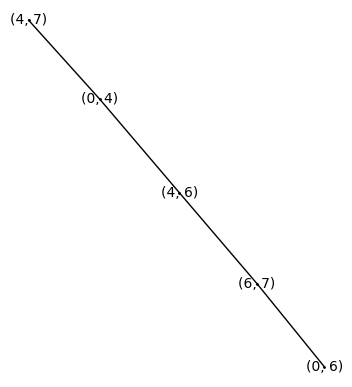

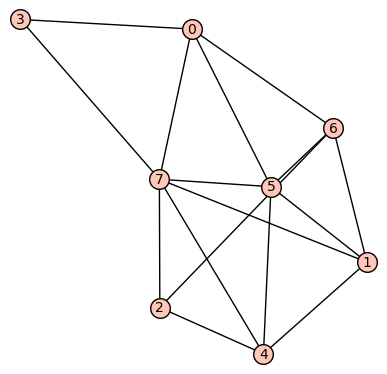

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None)]


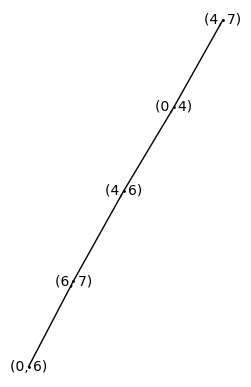

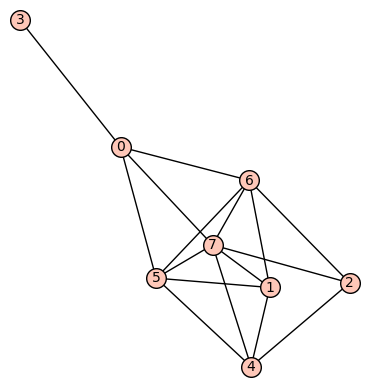

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


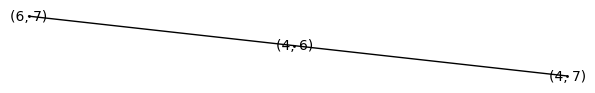

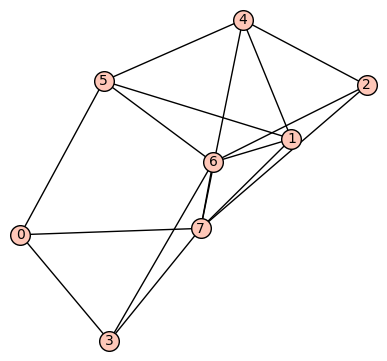

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (6, 7, None)]


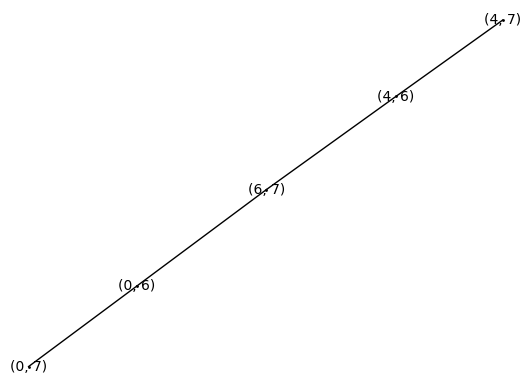

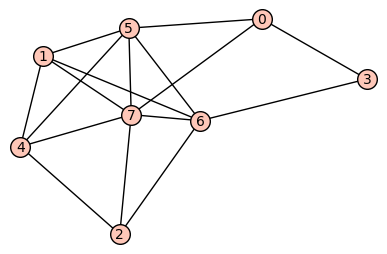

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


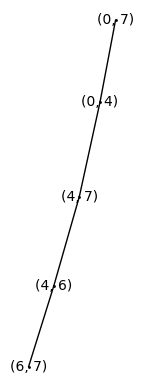

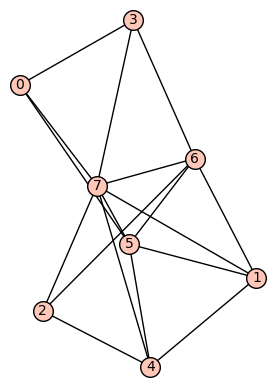

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


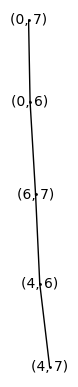

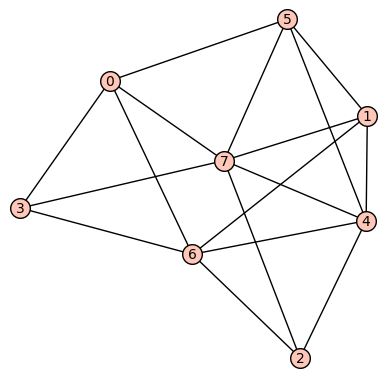

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


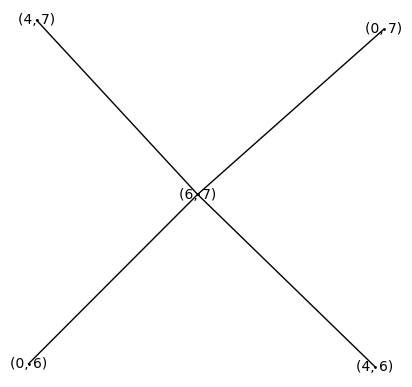

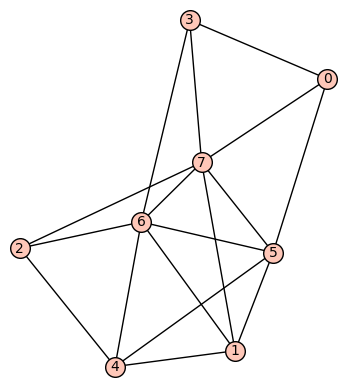

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 6, None), (5, 7, None), (6, 7, None)]


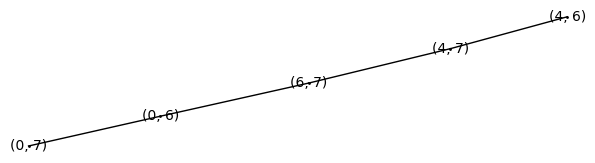

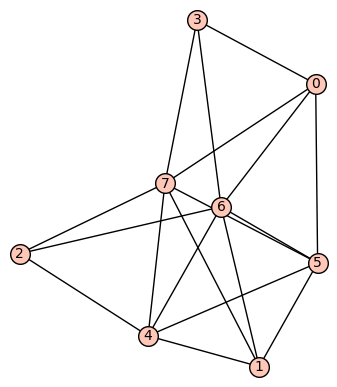

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


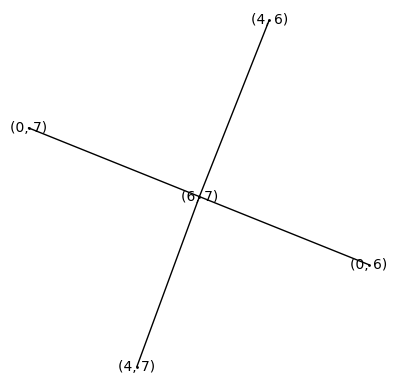

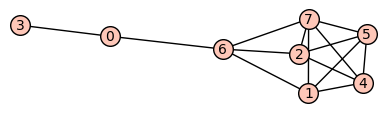

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


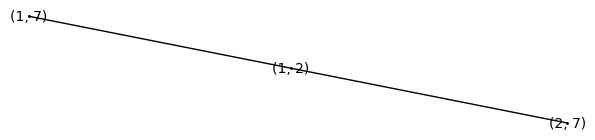

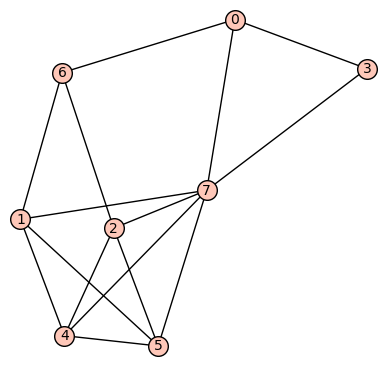

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None)]


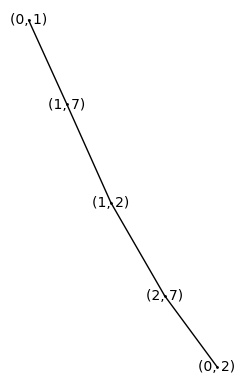

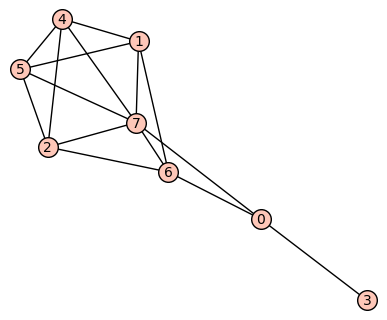

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


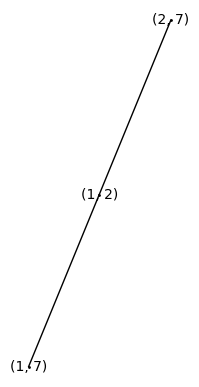

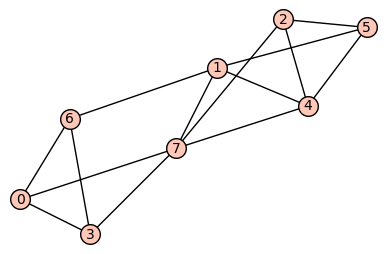

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None)]


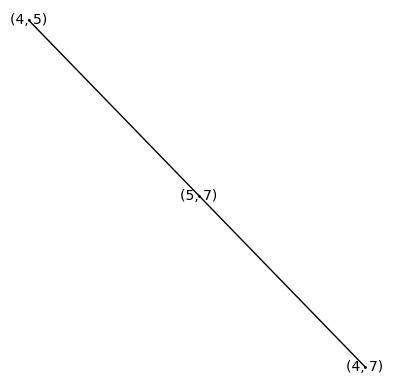

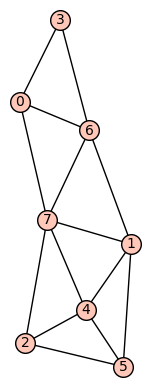

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 7, None), (6, 7, None)]


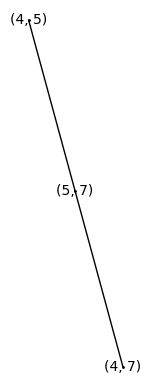

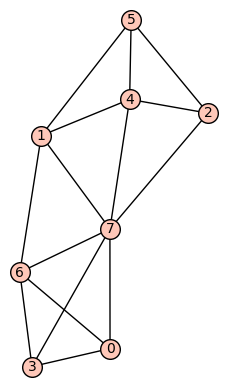

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


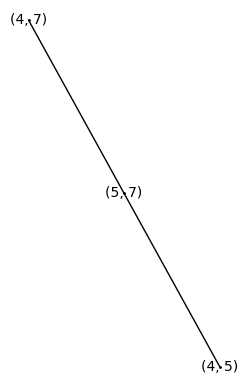

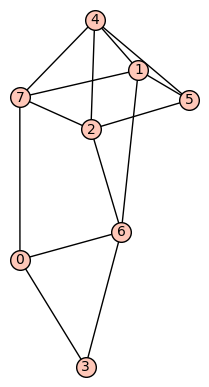

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 7, None)]


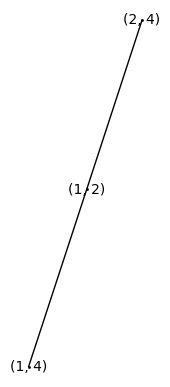

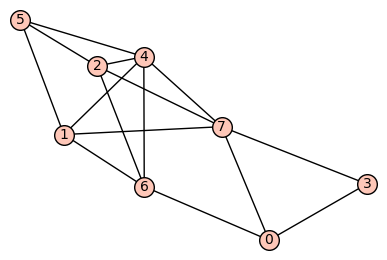

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None)]


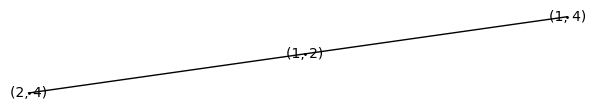

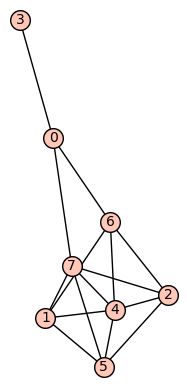

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


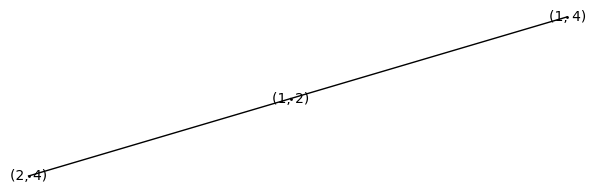

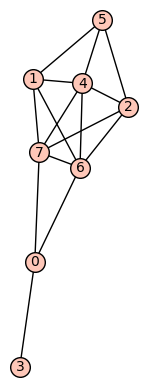

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


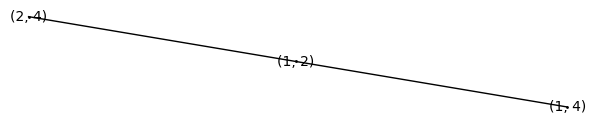

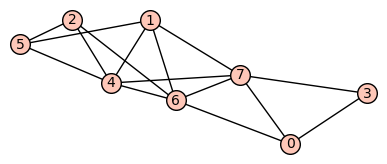

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


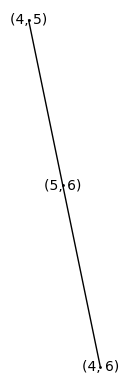

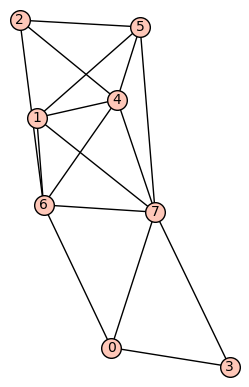

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


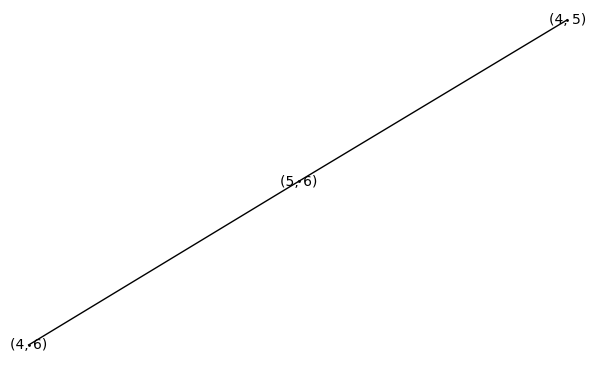

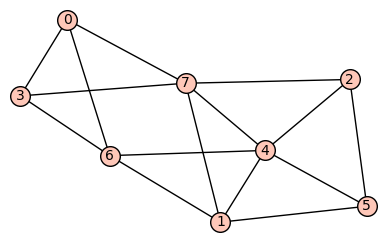

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None)]


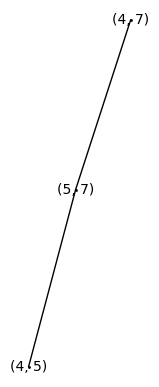

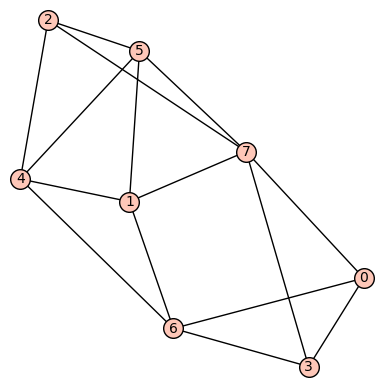

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None)]


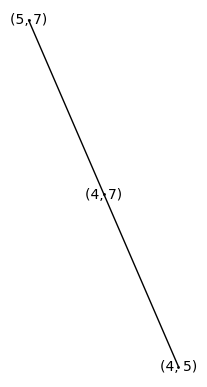

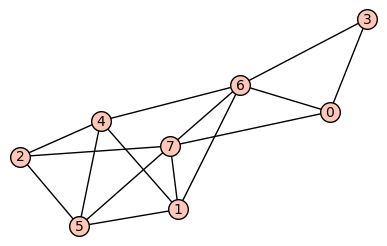

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


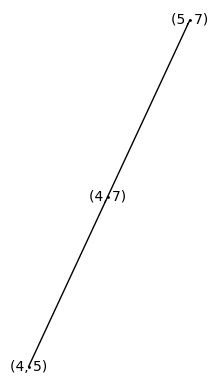

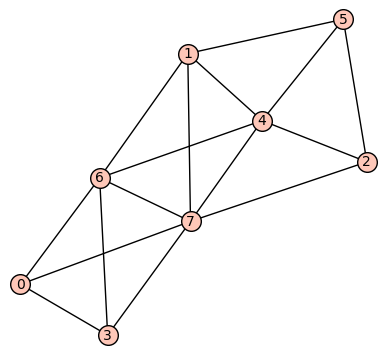

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


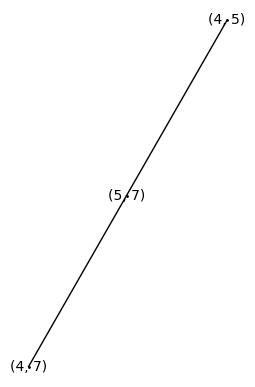

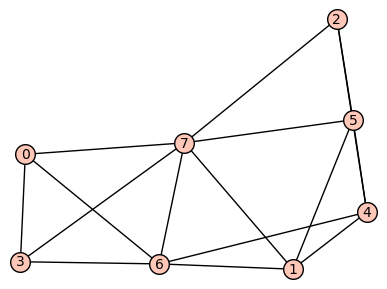

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


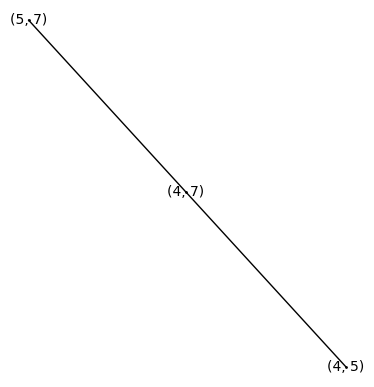

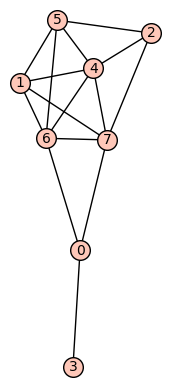

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


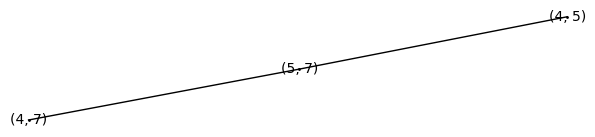

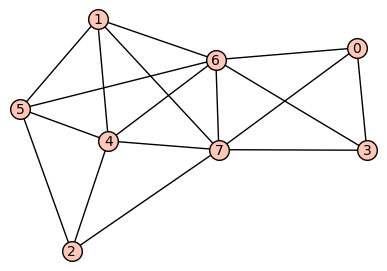

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


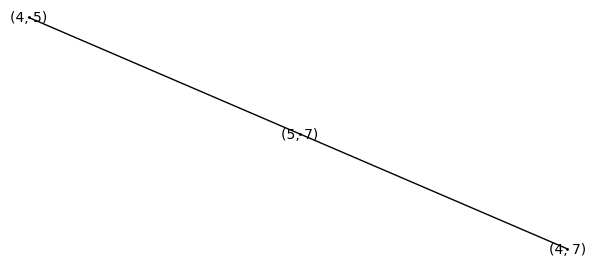

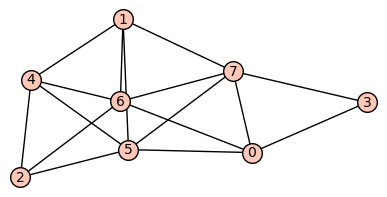

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


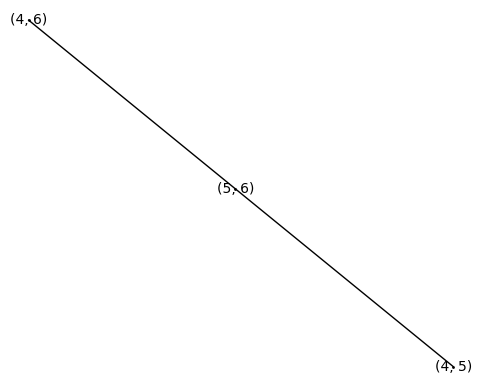

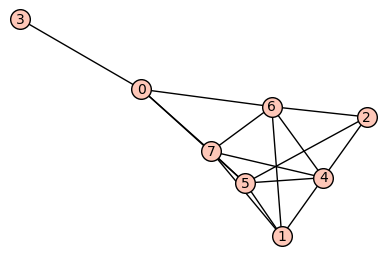

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


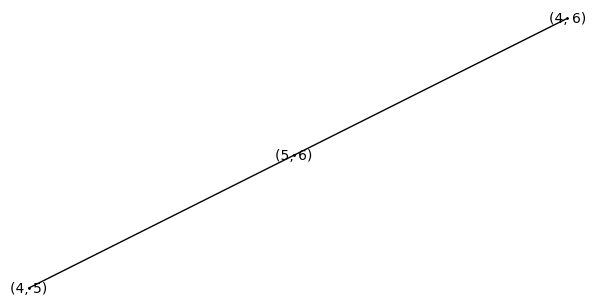

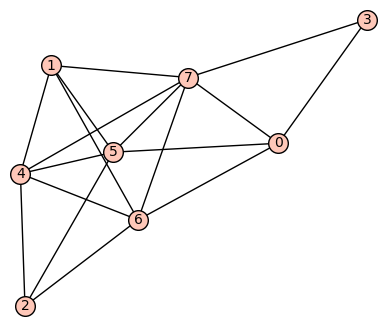

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


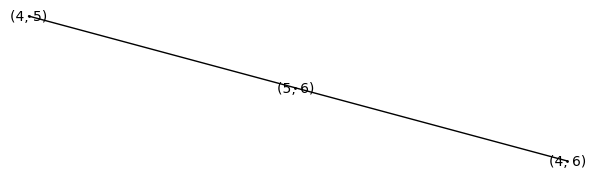

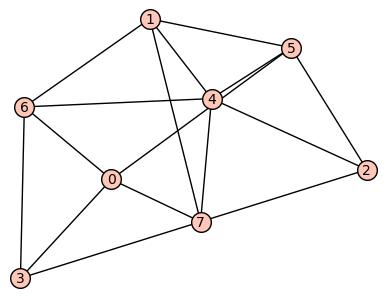

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None)]


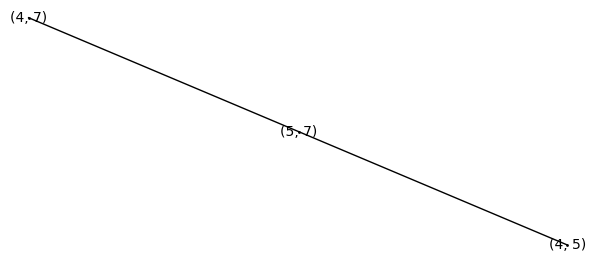

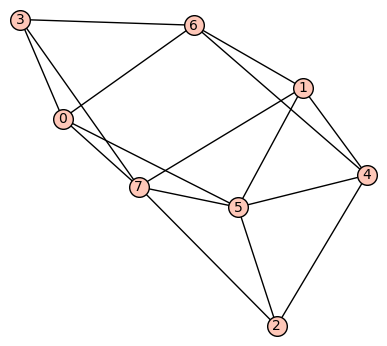

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None)]


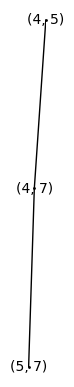

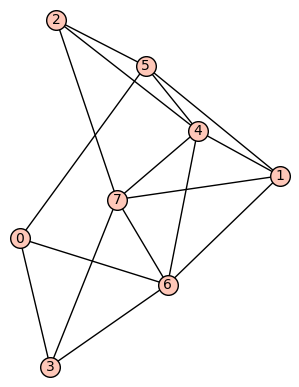

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


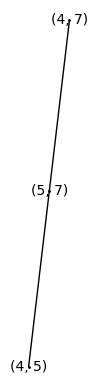

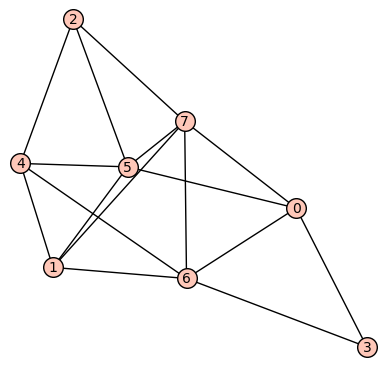

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


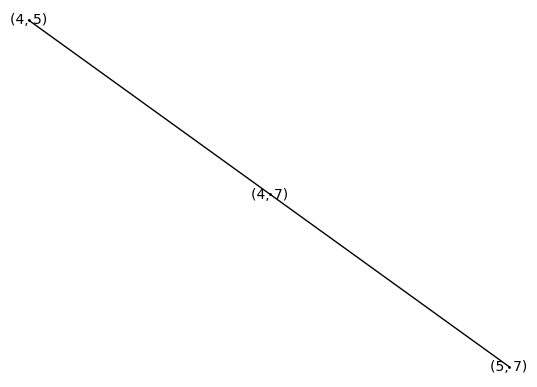

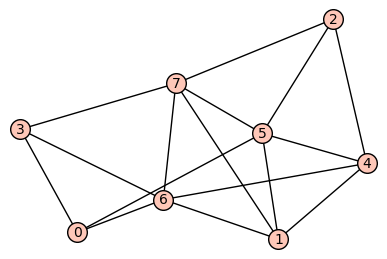

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


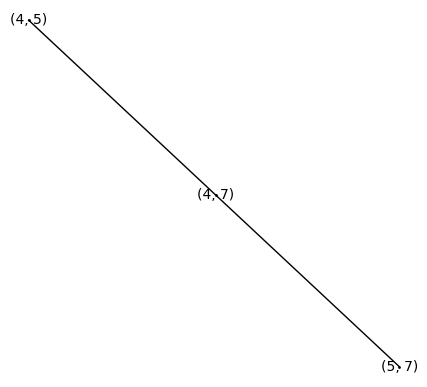

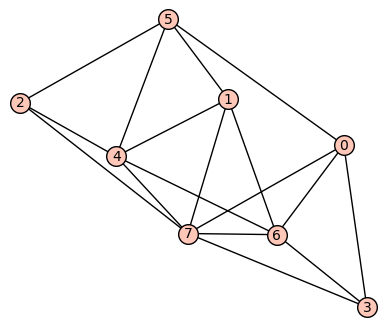

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (6, 7, None)]


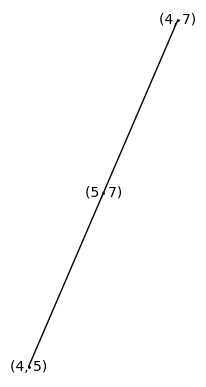

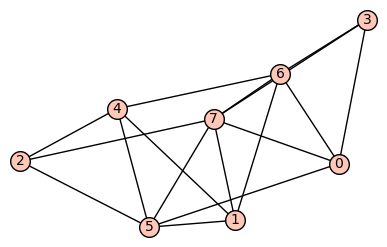

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


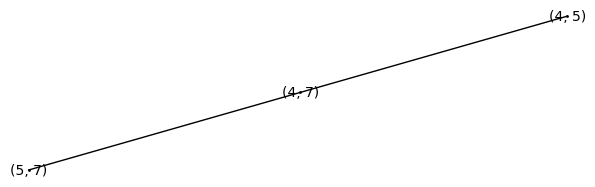

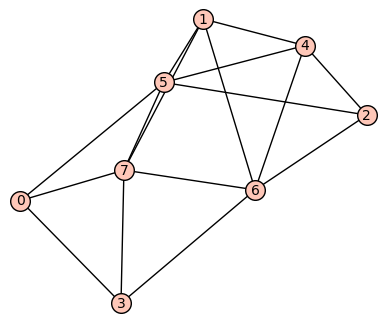

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


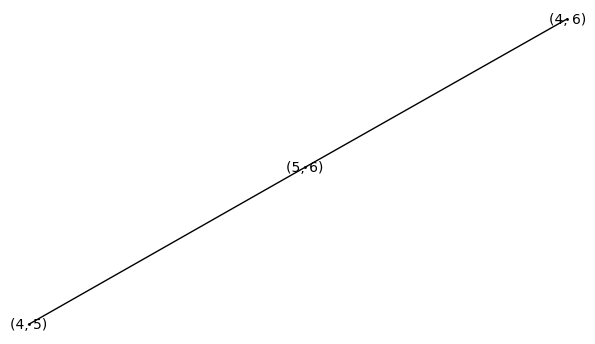

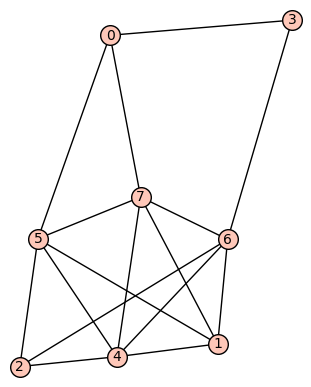

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 6, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


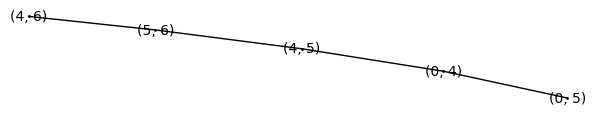

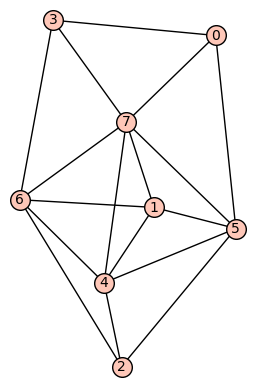

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


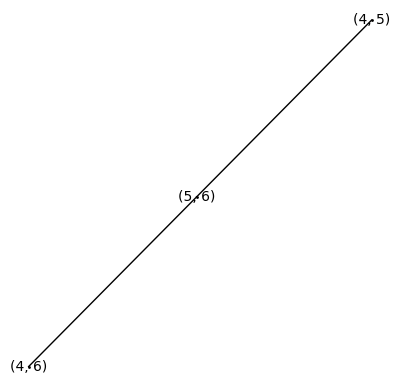

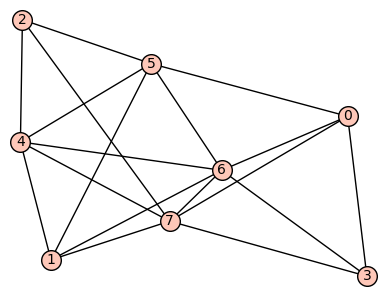

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


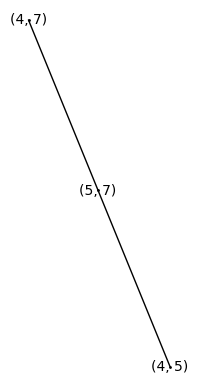

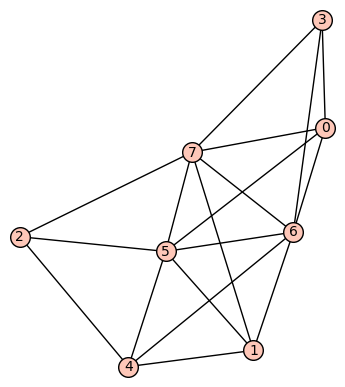

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 6, None), (5, 7, None), (6, 7, None)]


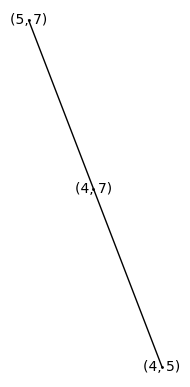

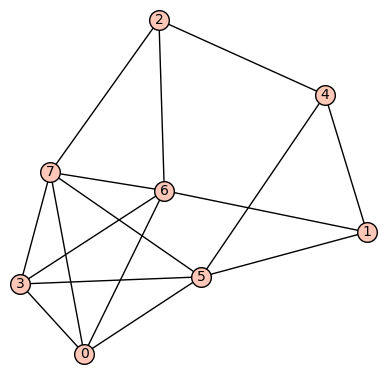

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (5, 7, None), (6, 7, None)]


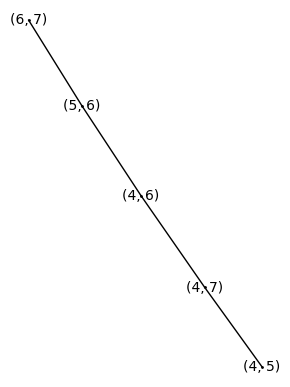

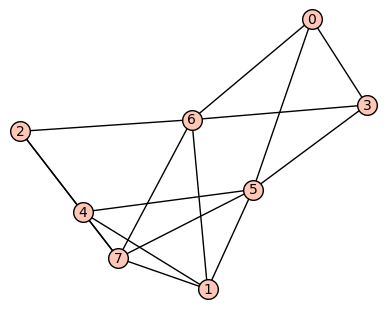

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


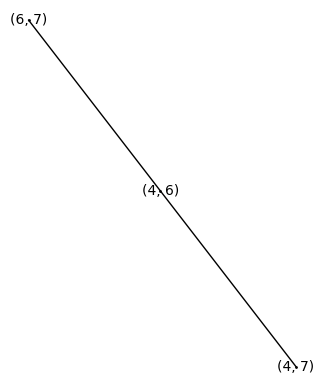

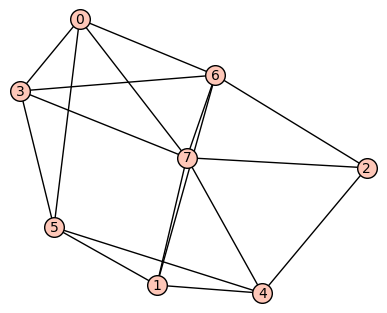

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


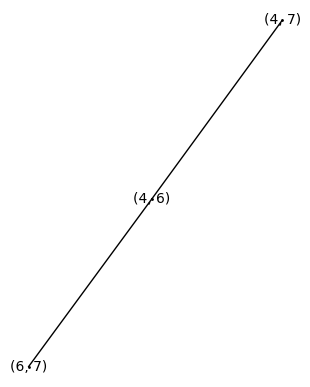

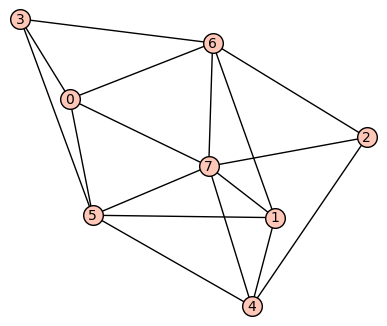

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


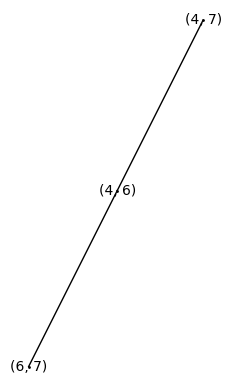

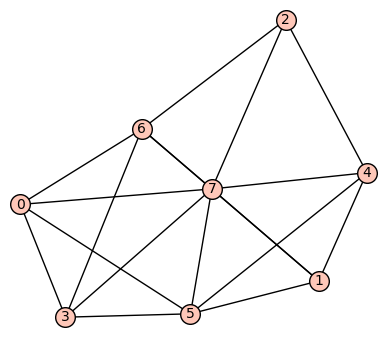

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


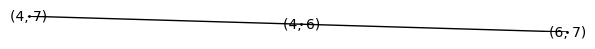

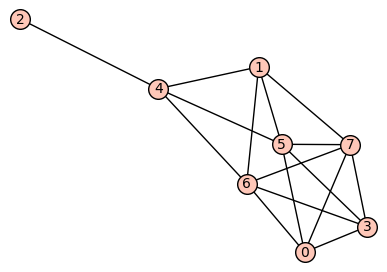

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


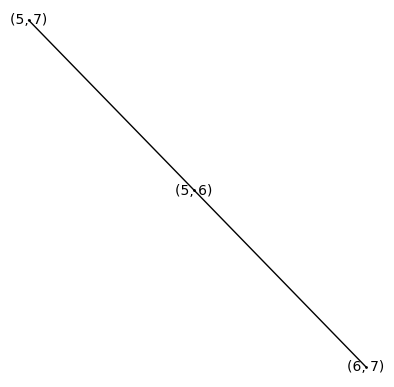

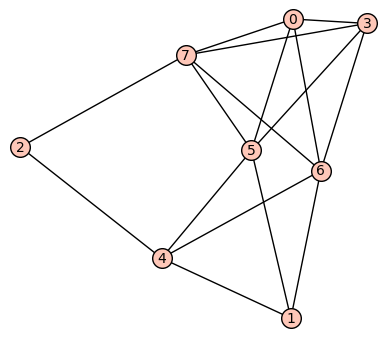

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


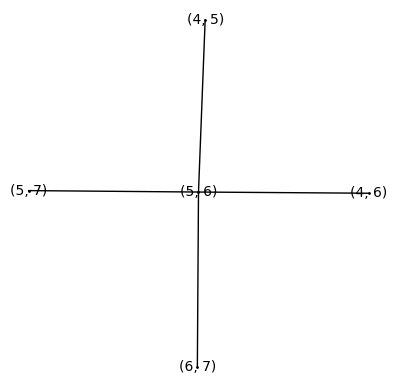

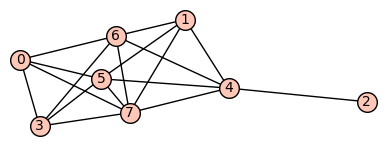

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


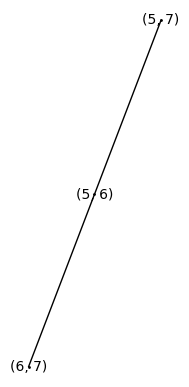

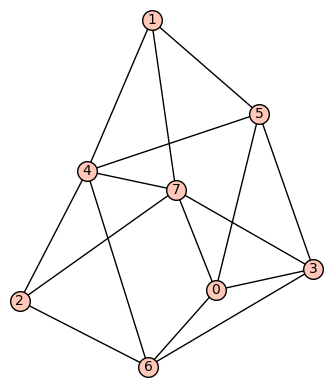

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None)]


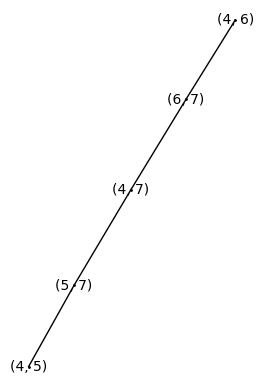

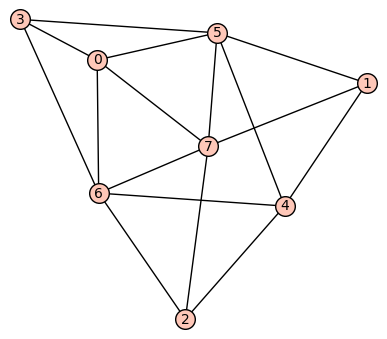

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


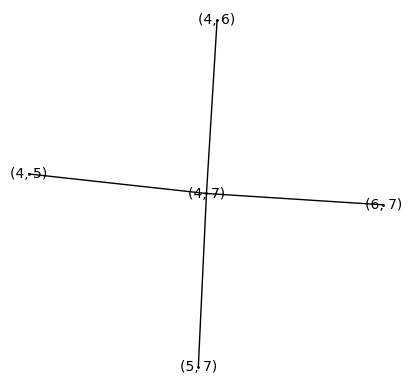

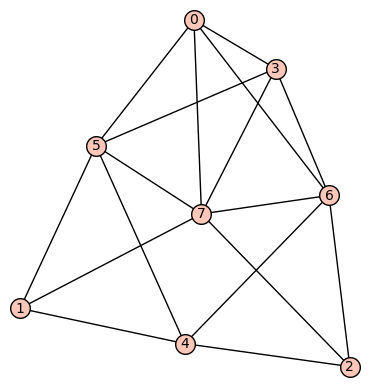

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


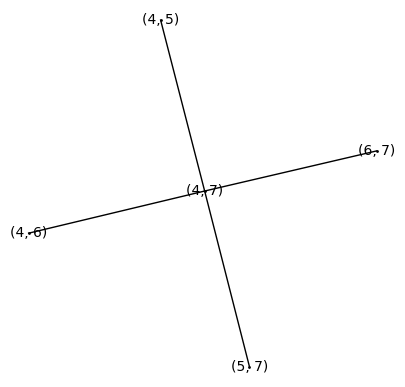

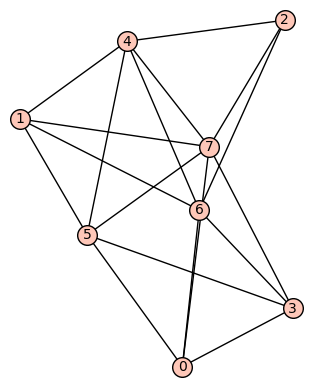

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


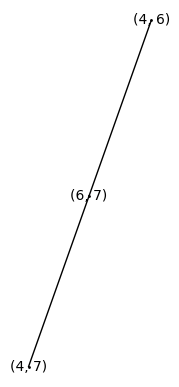

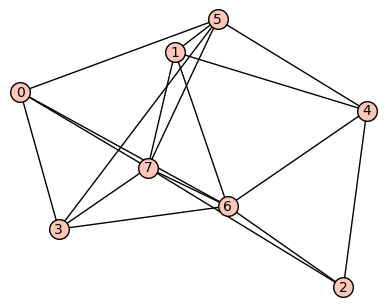

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


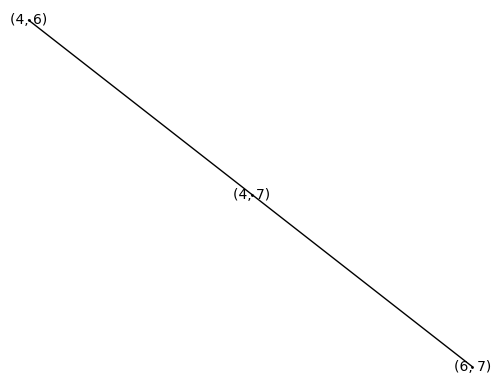

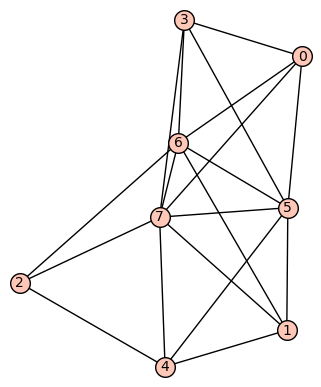

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


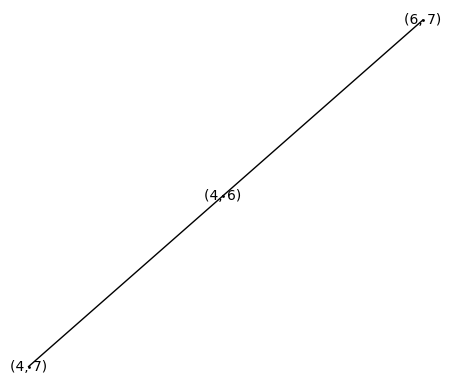

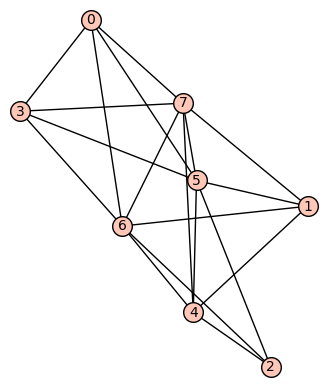

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


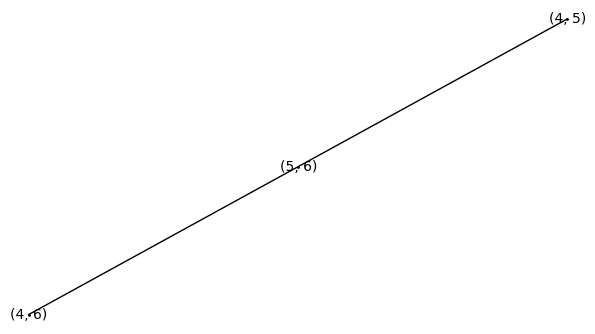

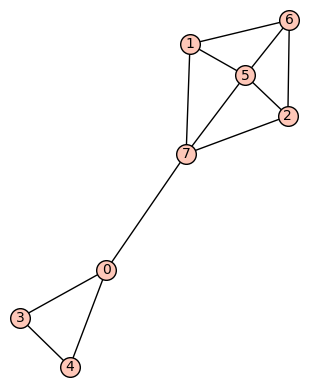

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 7, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (5, 6, None), (5, 7, None)]


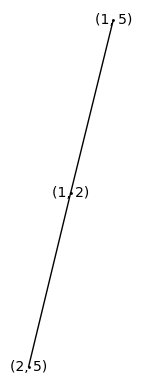

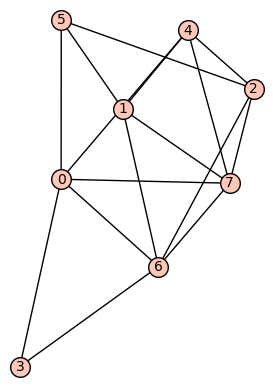

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (6, 7, None)]


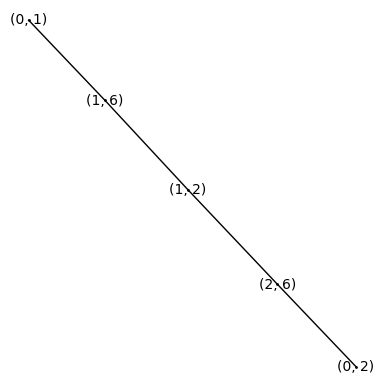

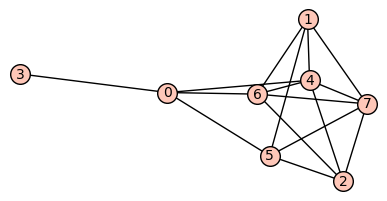

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


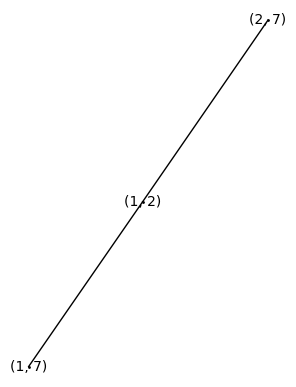

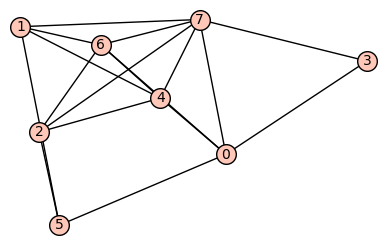

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 6, None), (4, 7, None), (6, 7, None)]


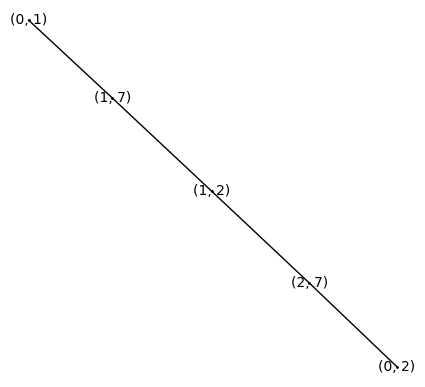

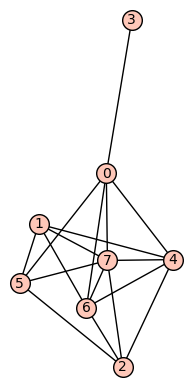

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


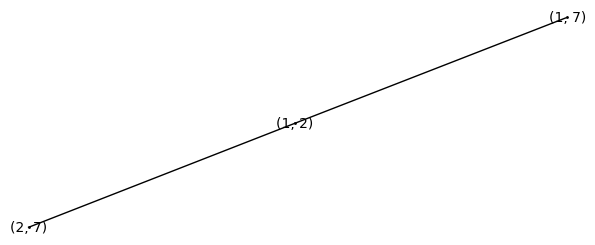

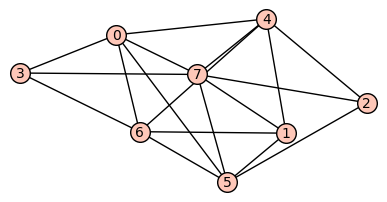

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


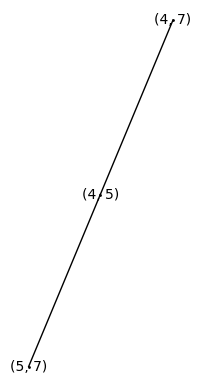

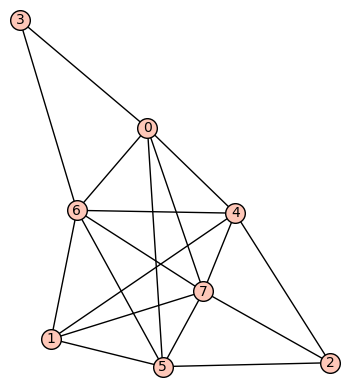

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


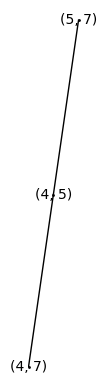

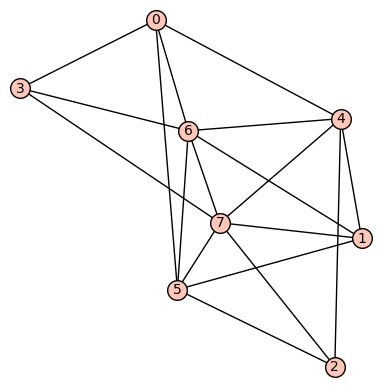

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


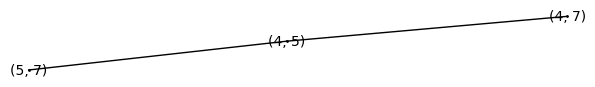

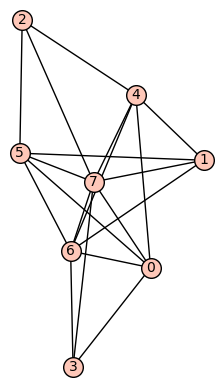

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


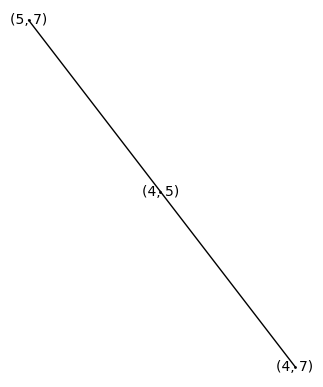

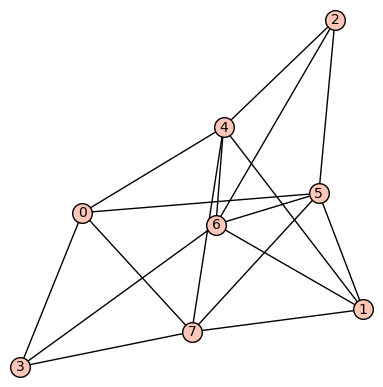

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


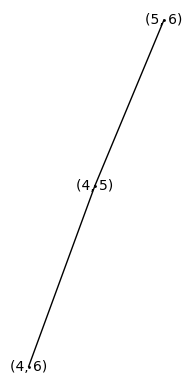

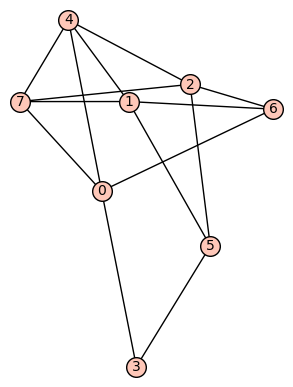

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (4, 7, None)]


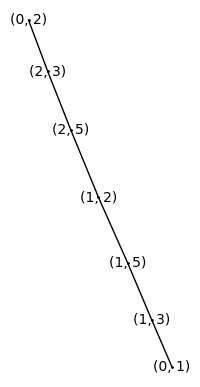

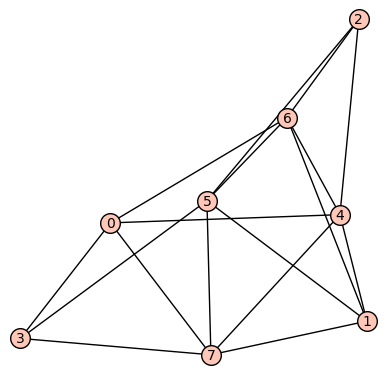

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


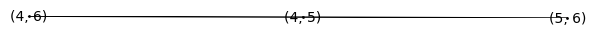

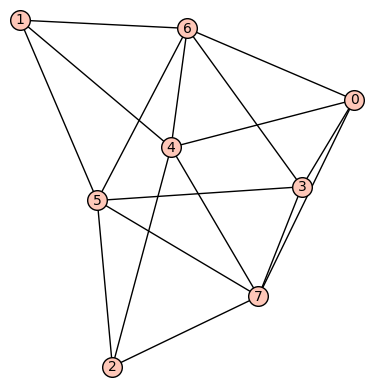

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


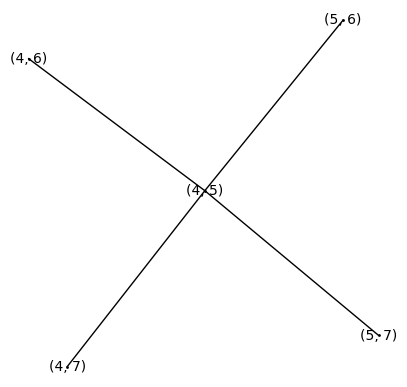

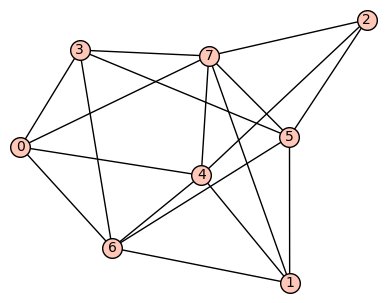

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


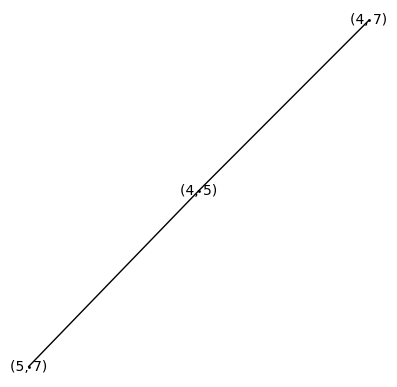

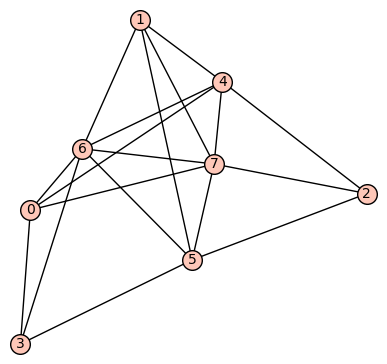

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


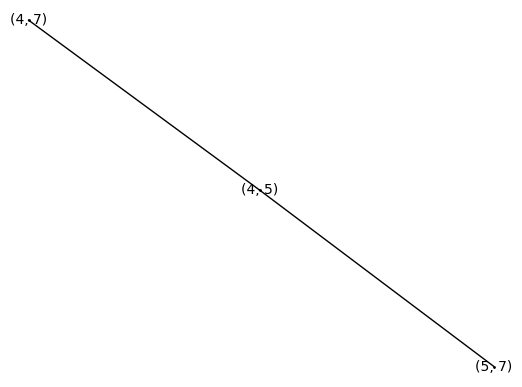

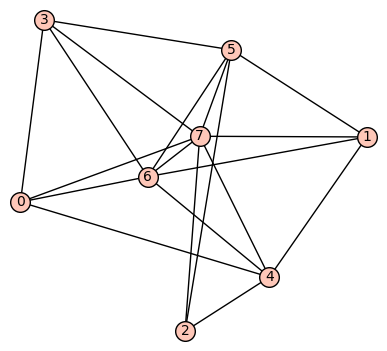

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


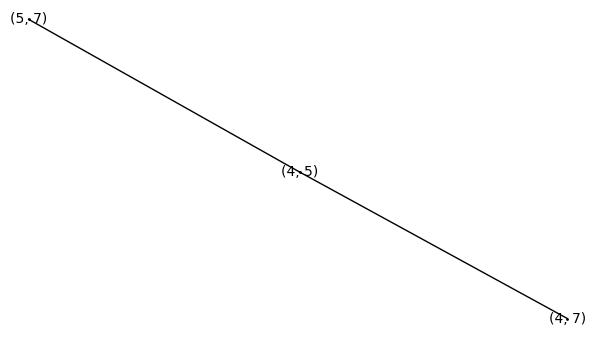

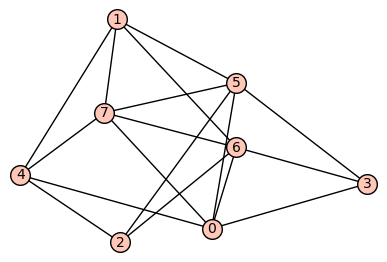

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


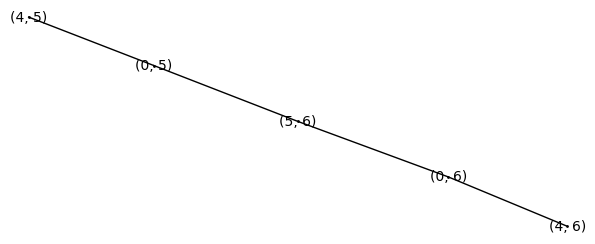

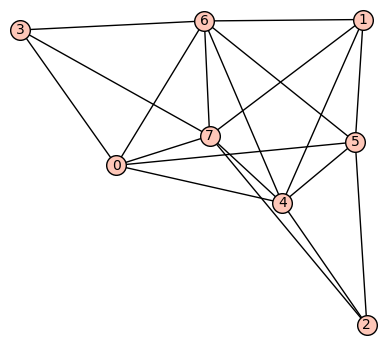

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


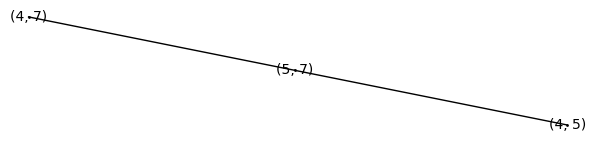

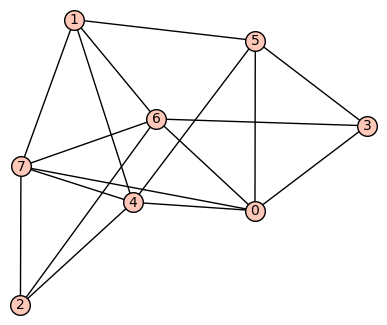

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (6, 7, None)]


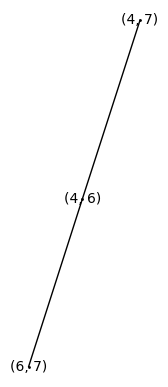

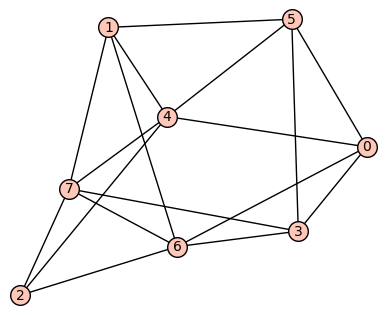

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


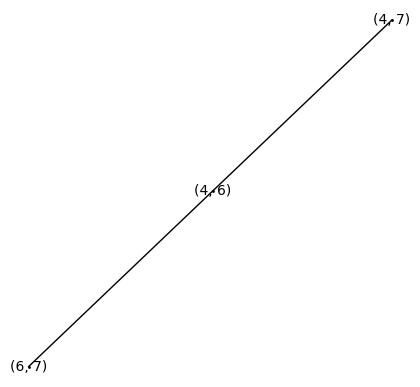

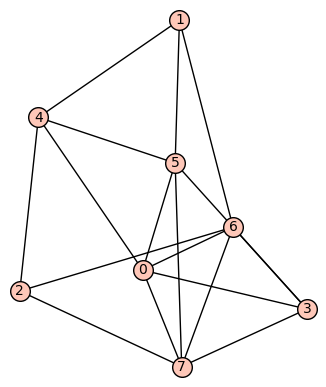

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (5, 7, None), (6, 7, None)]


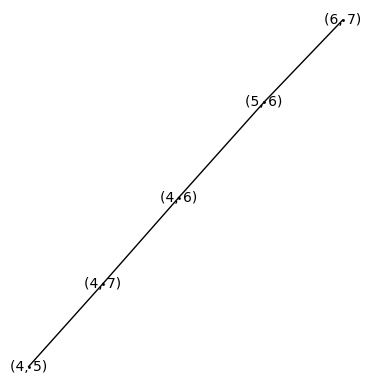

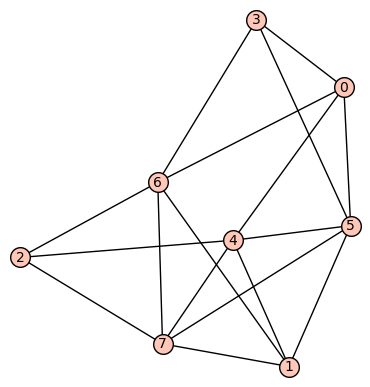

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


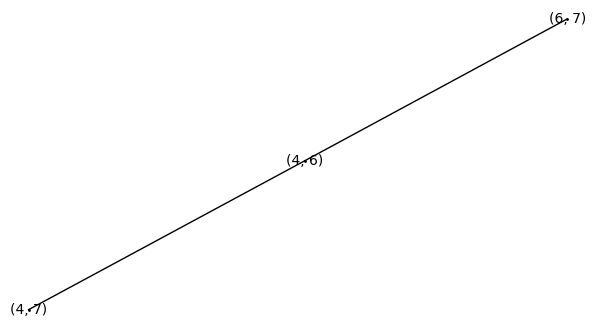

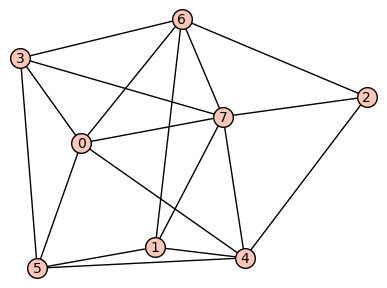

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


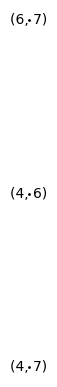

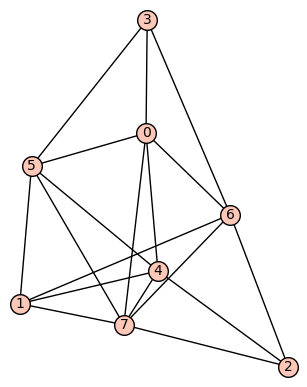

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


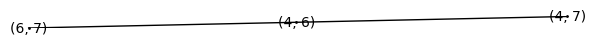

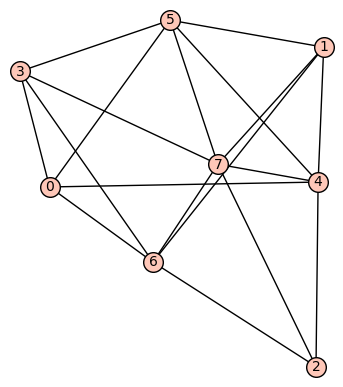

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


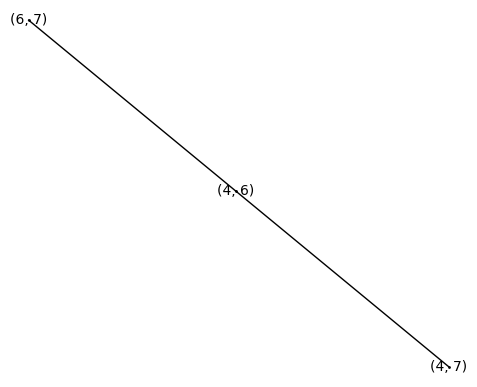

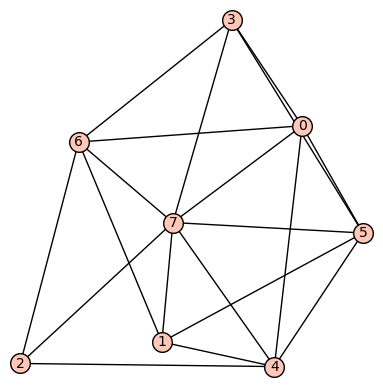

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


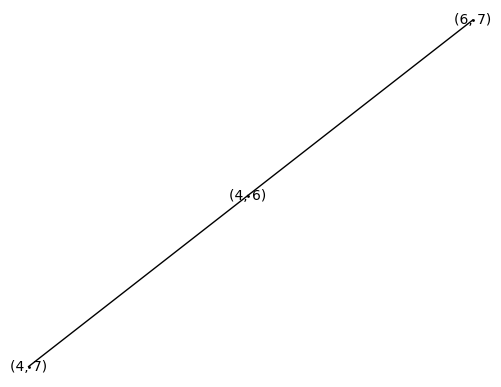

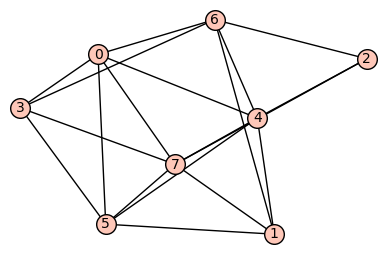

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None)]


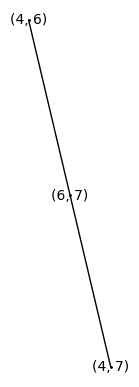

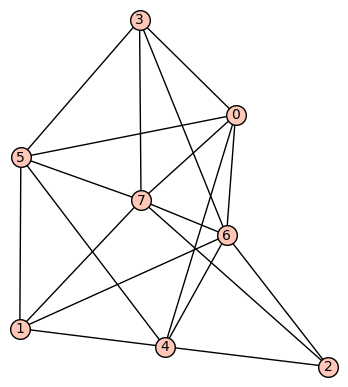

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


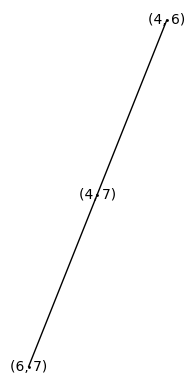

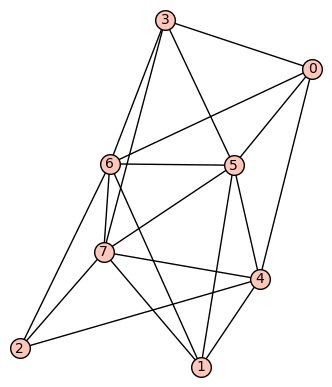

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


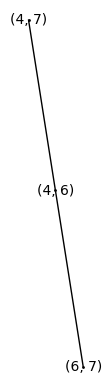

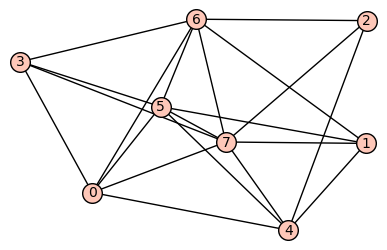

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


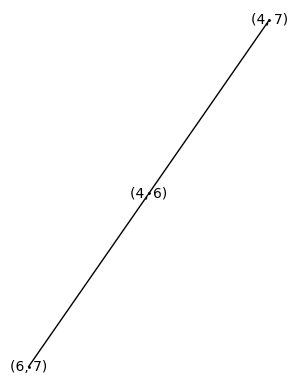

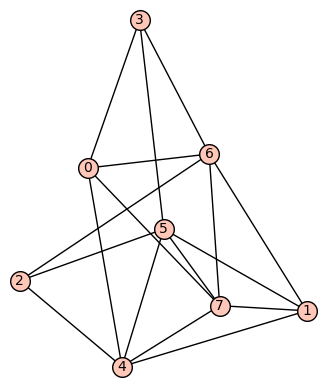

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


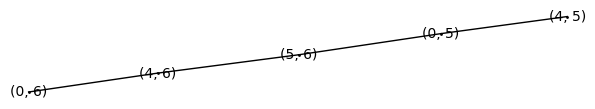

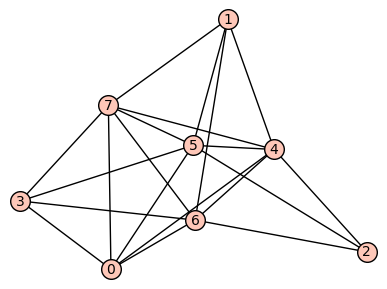

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


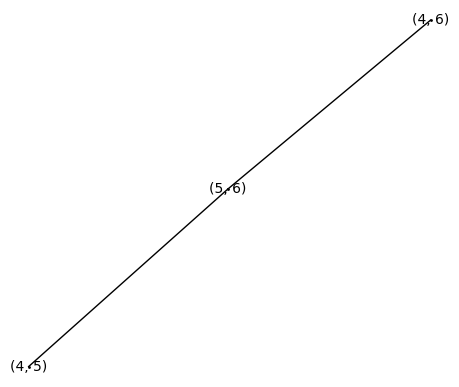

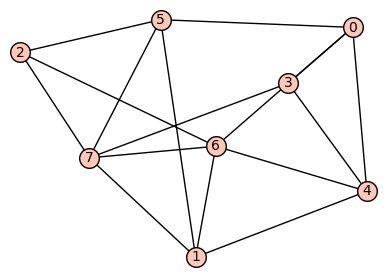

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


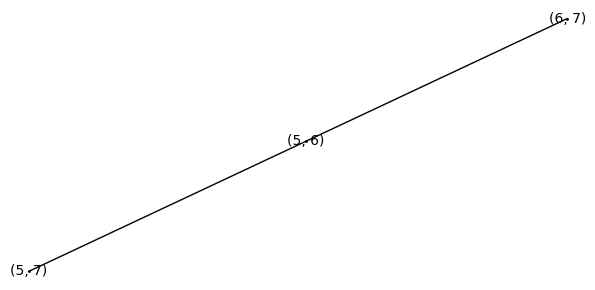

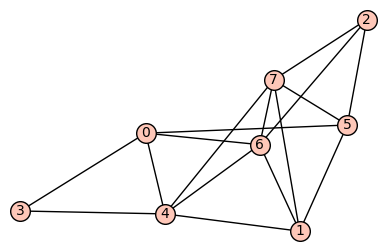

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


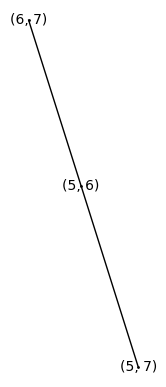

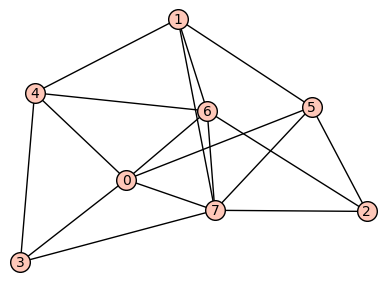

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


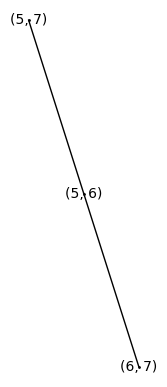

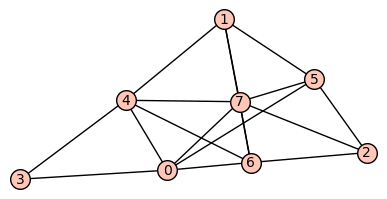

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


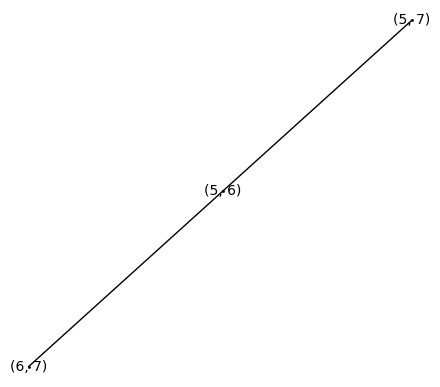

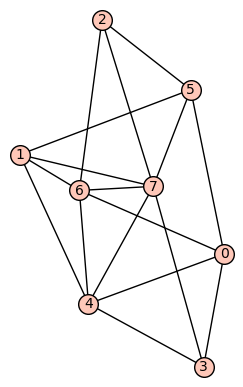

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


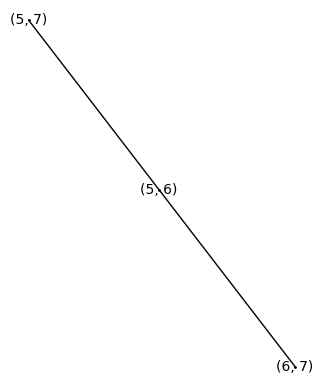

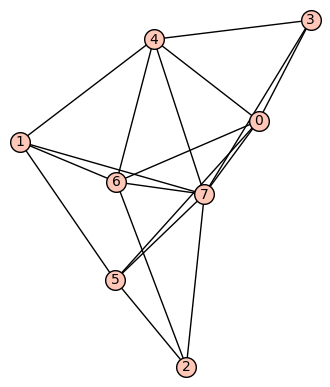

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


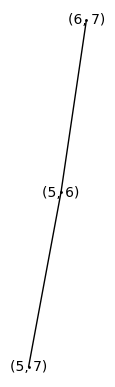

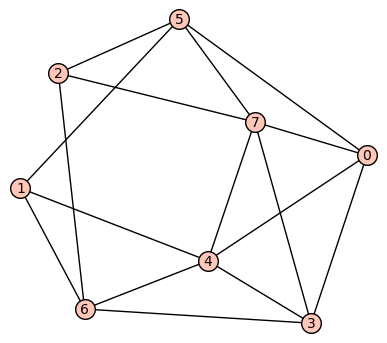

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


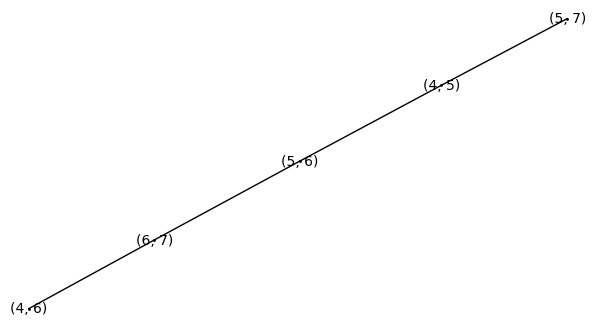

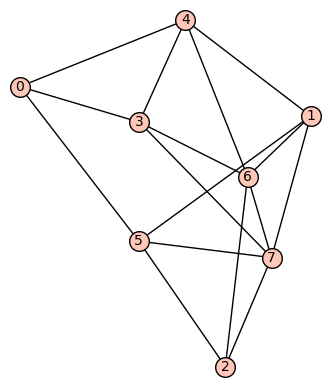

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


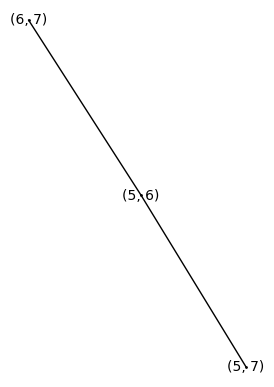

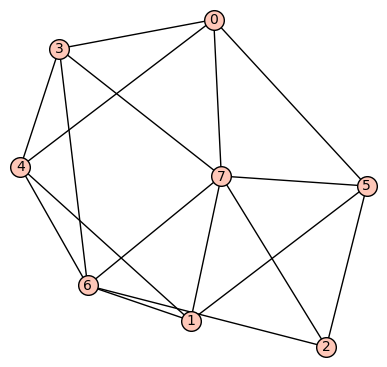

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


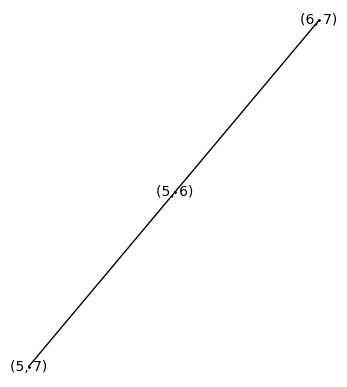

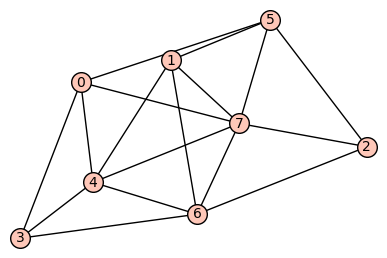

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


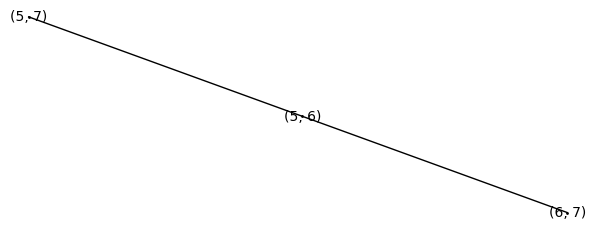

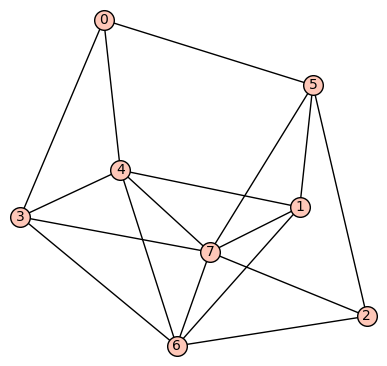

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


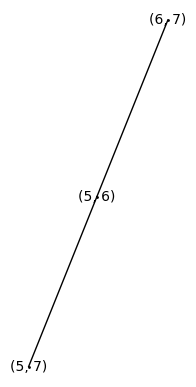

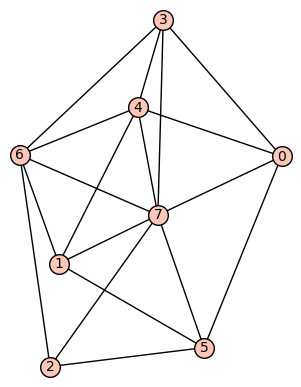

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


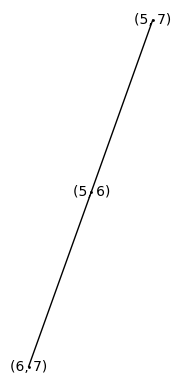

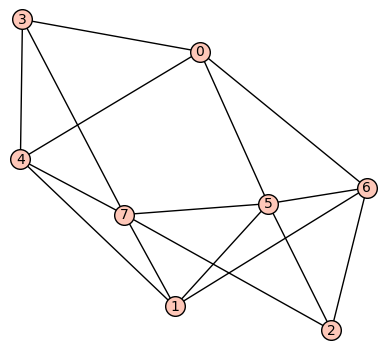

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


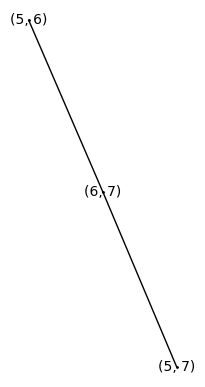

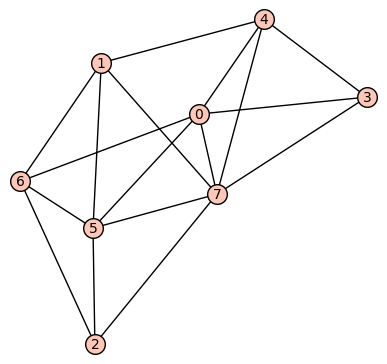

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


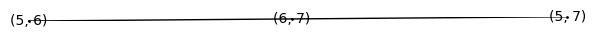

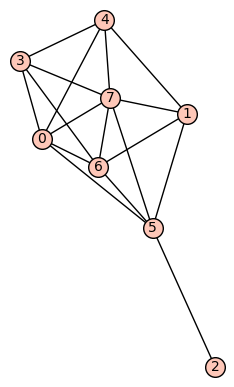

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


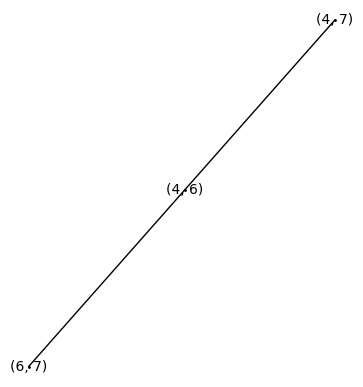

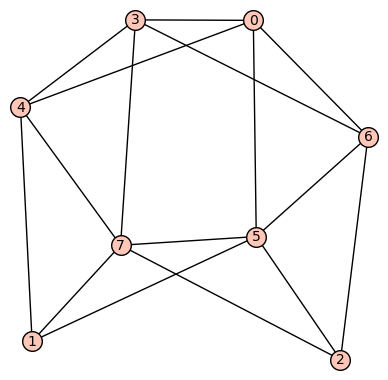

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


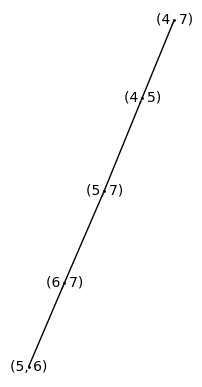

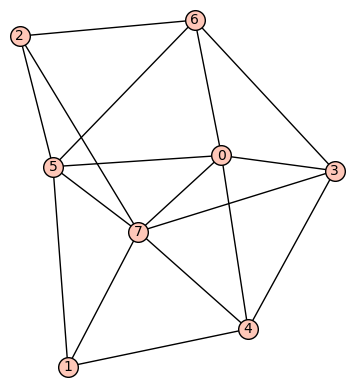

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


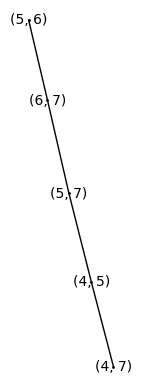

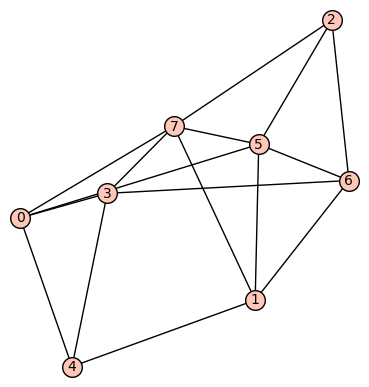

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (5, 6, None), (5, 7, None)]


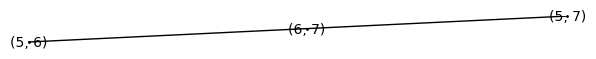

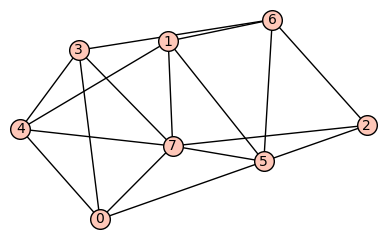

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


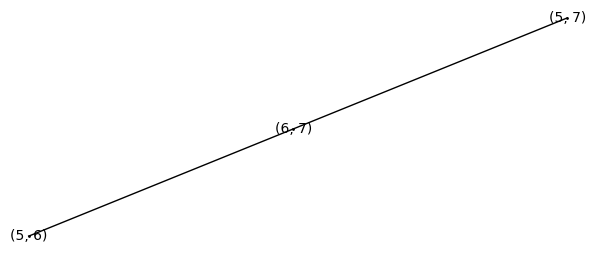

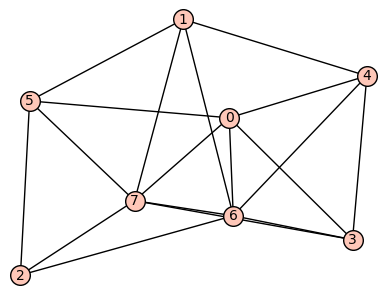

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


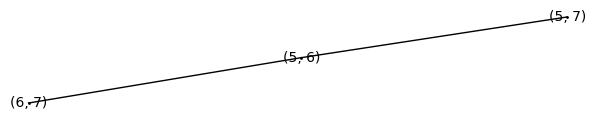

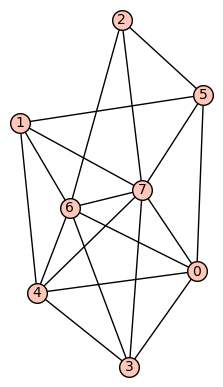

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


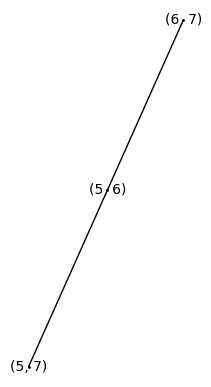

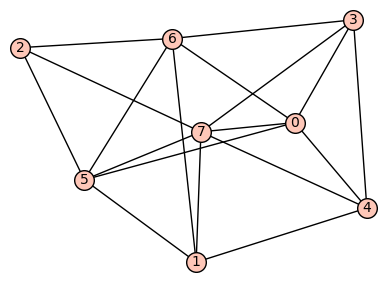

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


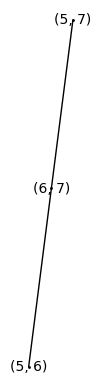

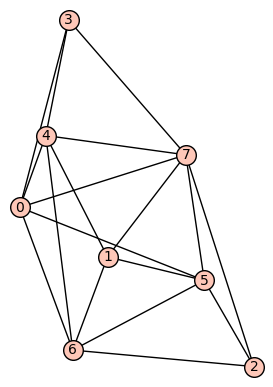

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


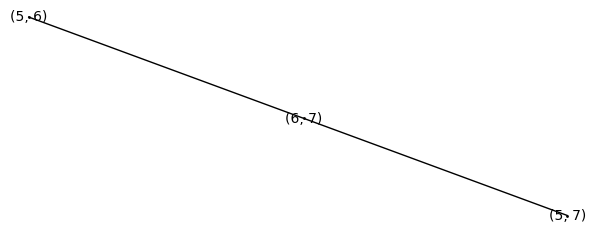

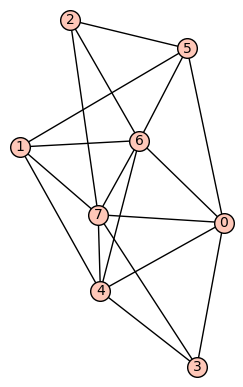

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


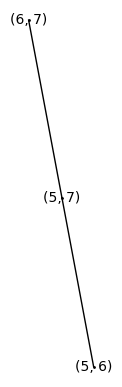

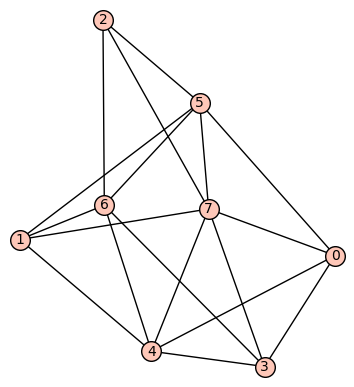

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


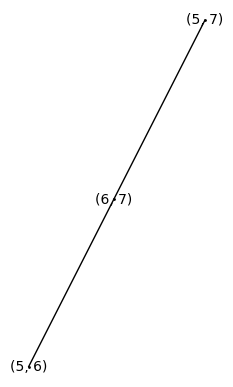

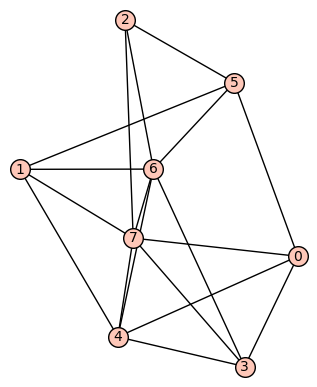

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


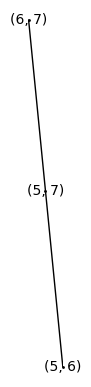

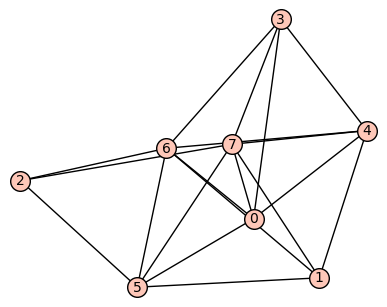

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


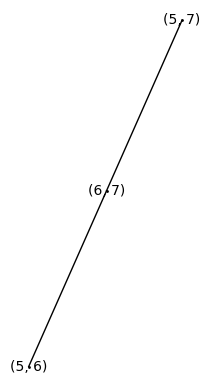

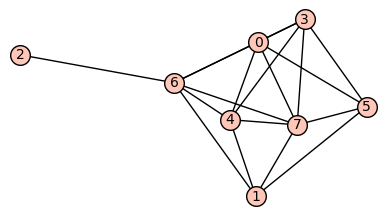

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


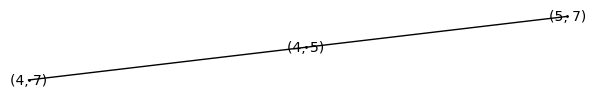

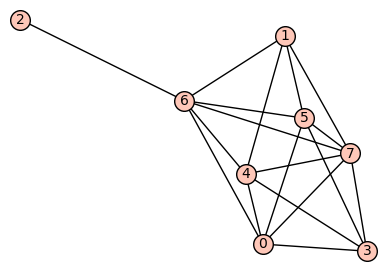

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (3, 4, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


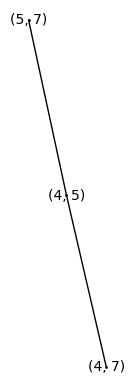

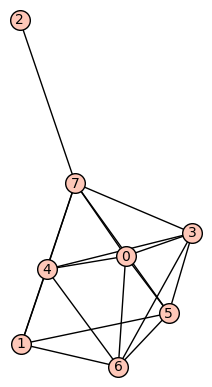

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


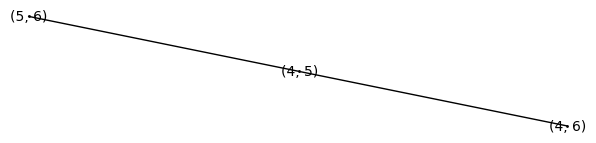

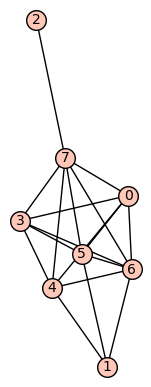

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


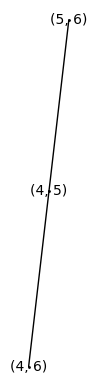

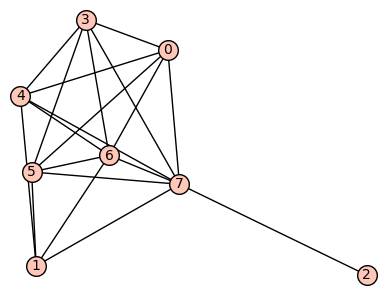

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


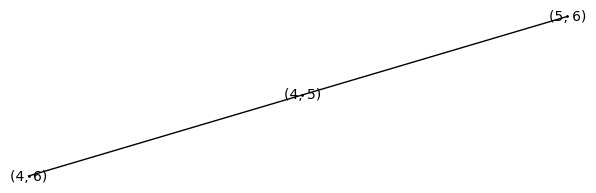

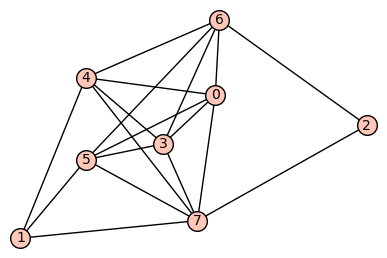

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 7, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


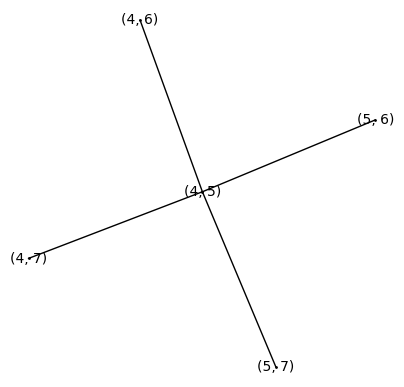

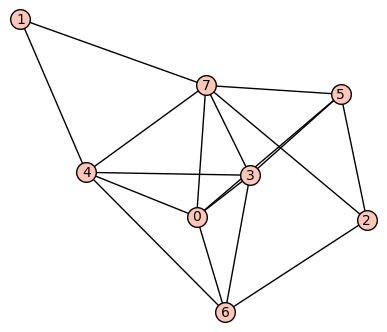

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None)]


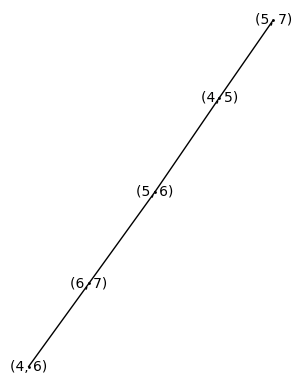

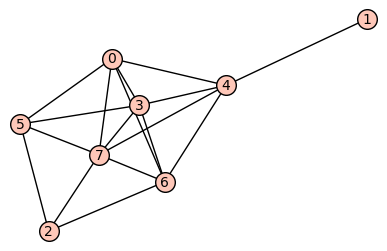

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


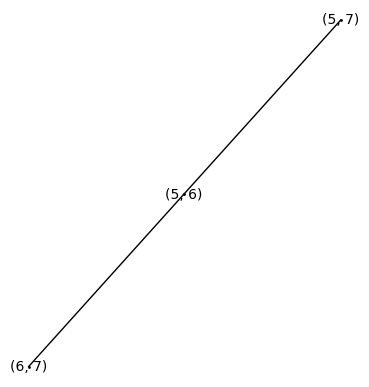

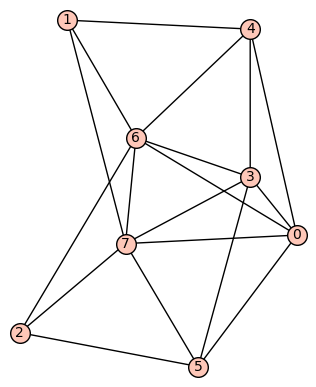

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


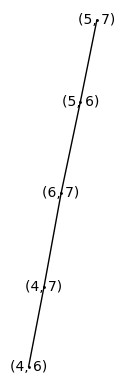

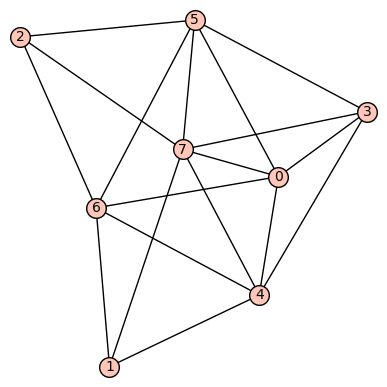

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


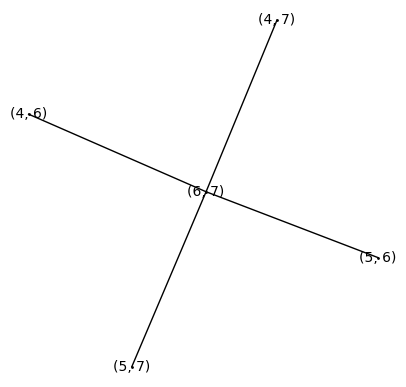

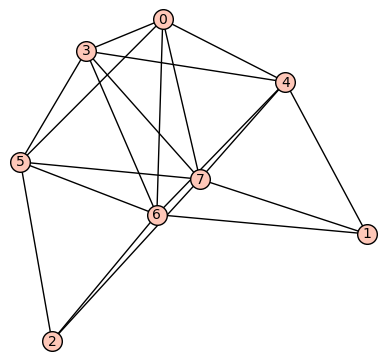

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (5, 7, None)]


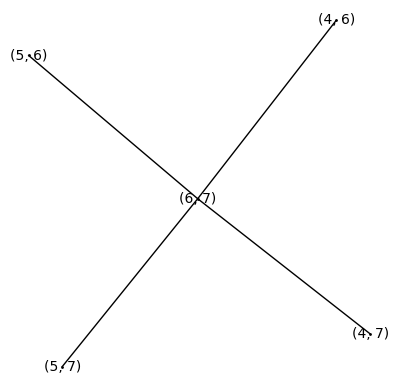

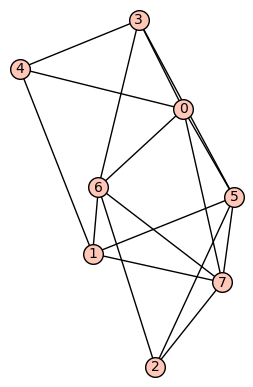

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (5, 7, None), (6, 7, None)]


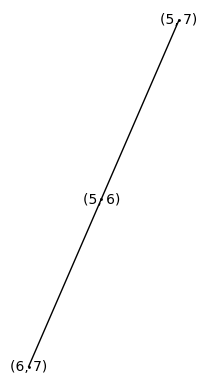

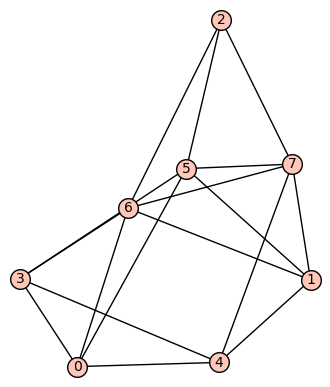

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


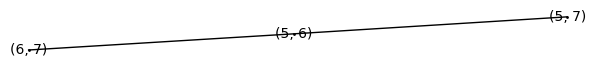

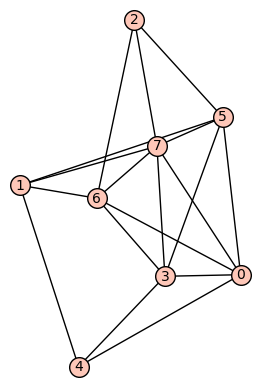

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (5, 7, None), (6, 7, None)]


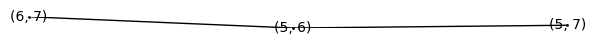

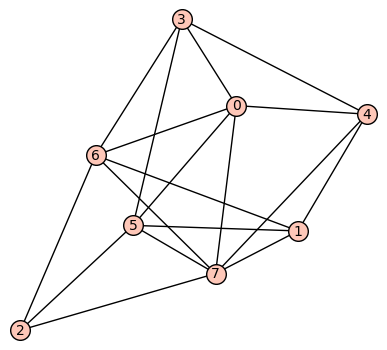

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


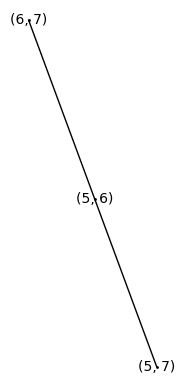

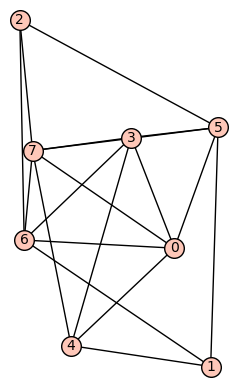

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


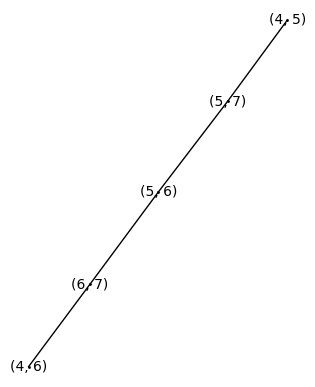

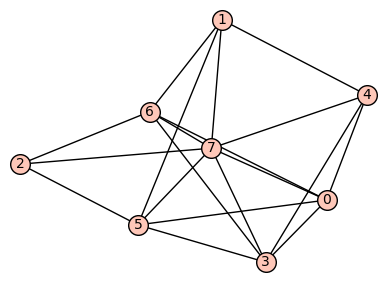

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


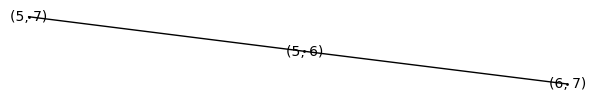

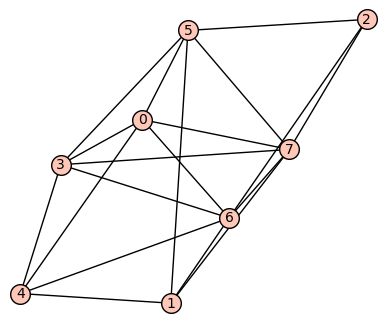

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (5, 7, None), (6, 7, None)]


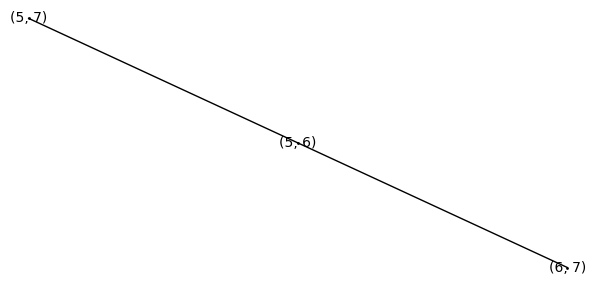

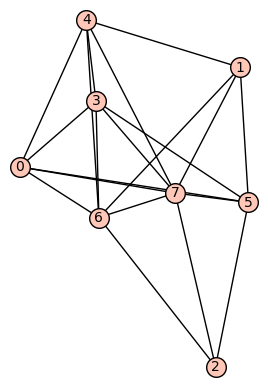

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


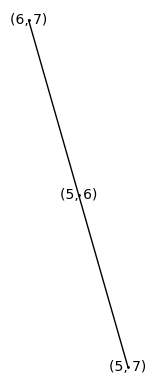

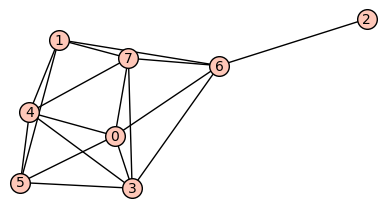

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 7, None), (6, 7, None)]


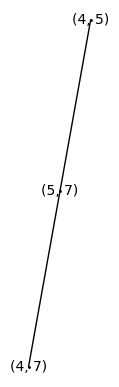

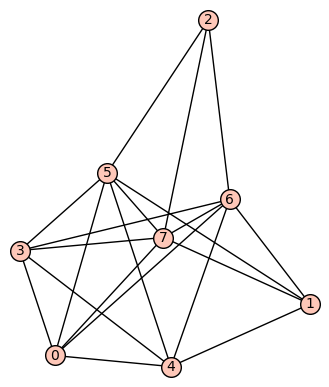

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (5, 7, None), (6, 7, None)]


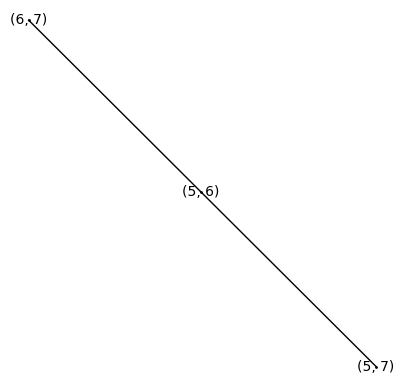

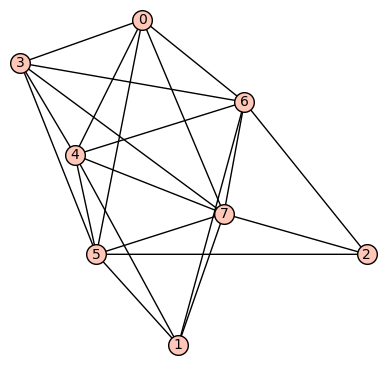

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 4, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


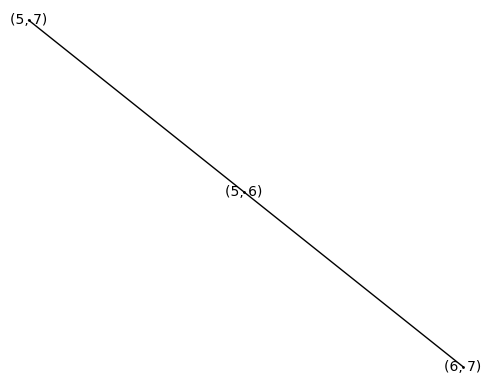

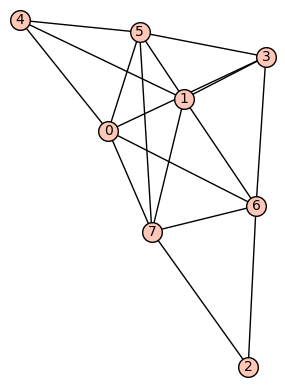

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (4, 5, None), (5, 7, None), (6, 7, None)]


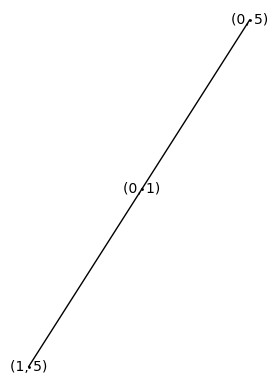

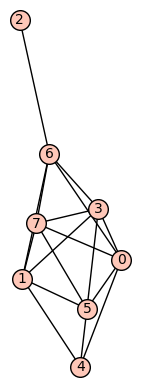

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (5, 7, None), (6, 7, None)]


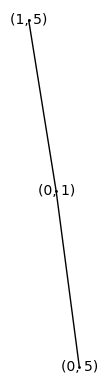

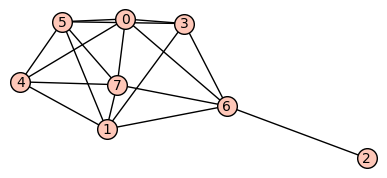

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 6, None), (3, 5, None), (3, 6, None), (4, 5, None), (4, 7, None), (5, 7, None), (6, 7, None)]


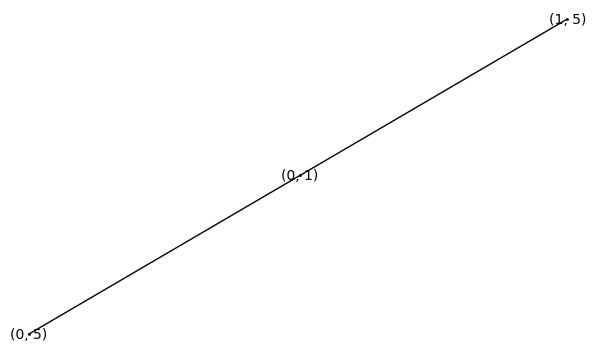

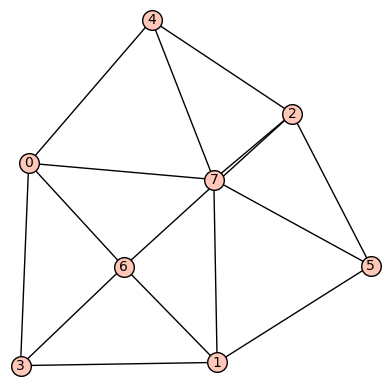

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None)]


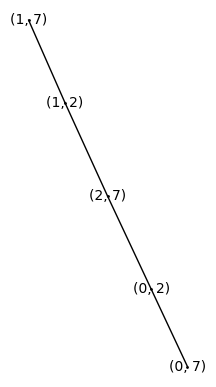

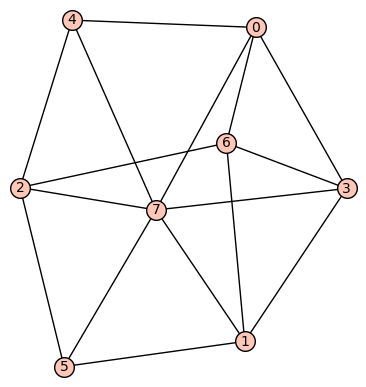

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


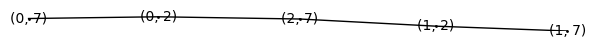

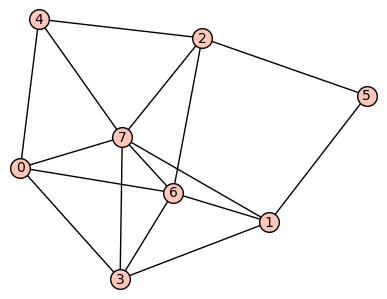

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (6, 7, None)]


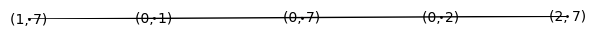

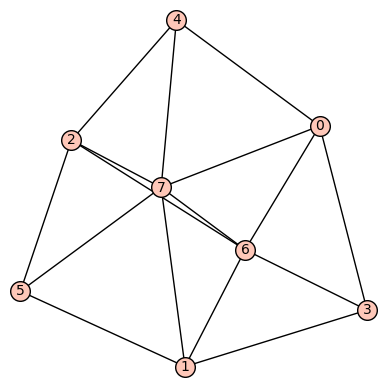

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


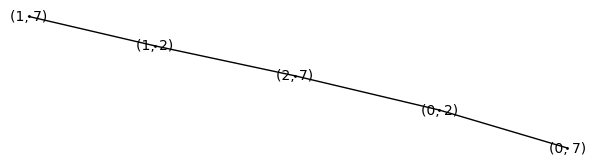

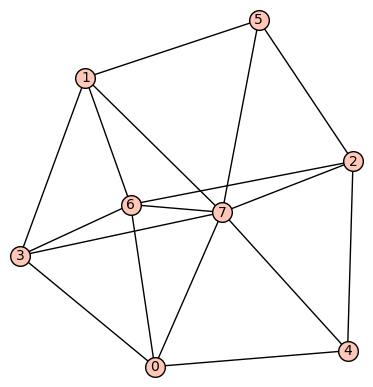

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


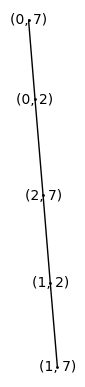

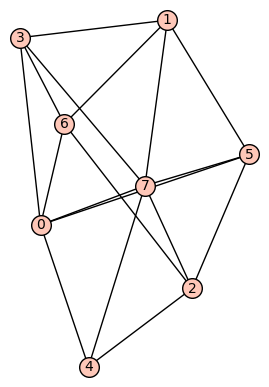

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None)]


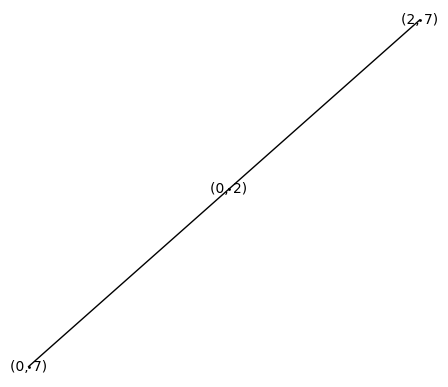

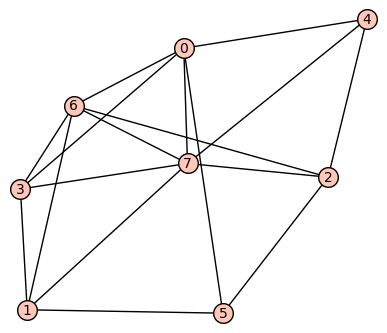

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (6, 7, None)]


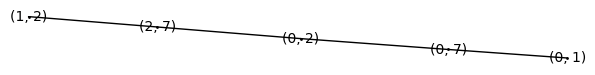

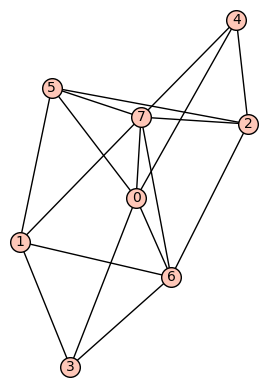

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


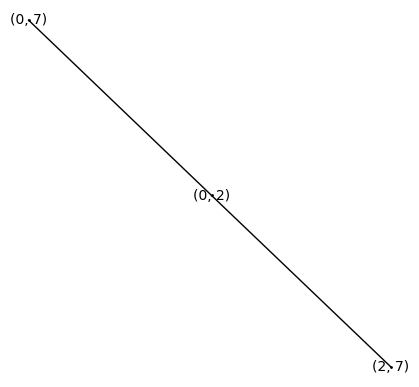

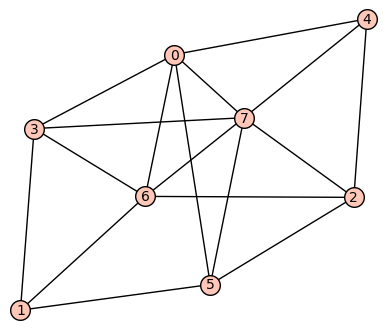

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


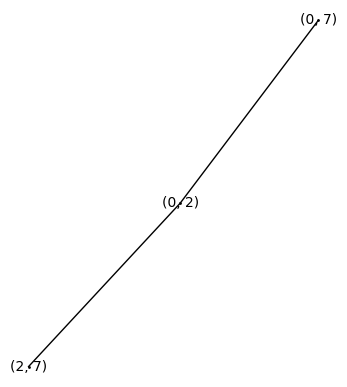

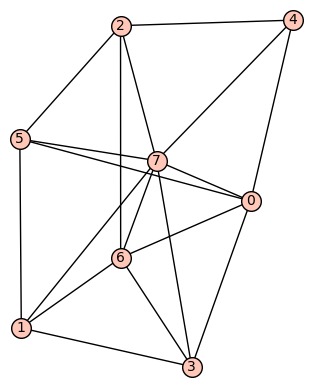

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


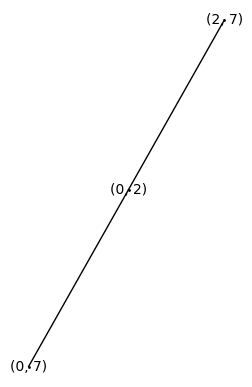

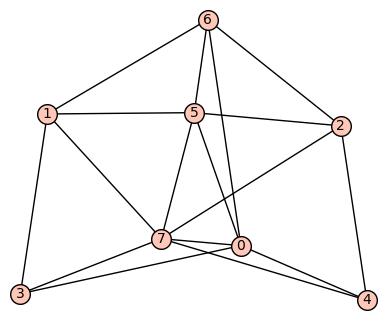

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None)]


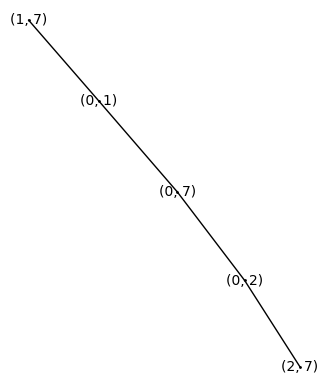

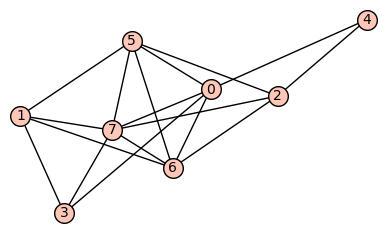

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


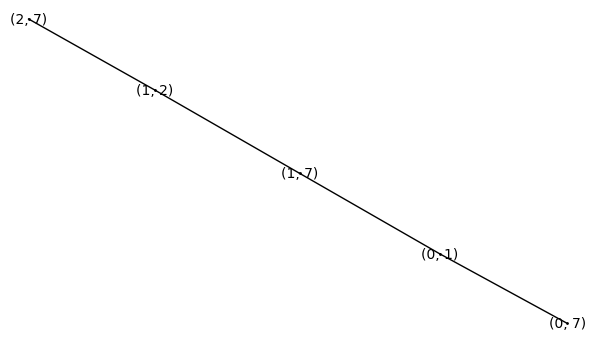

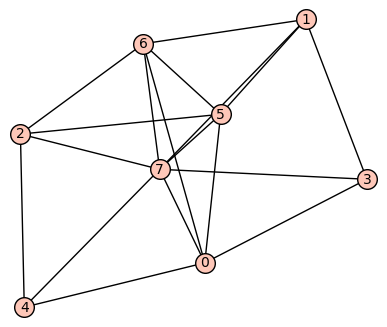

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 7, None), (4, 7, None), (5, 6, None), (5, 7, None), (6, 7, None)]


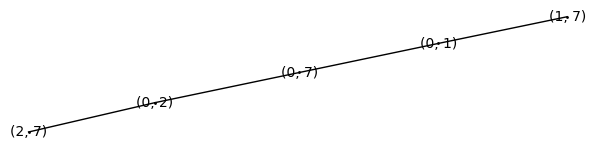

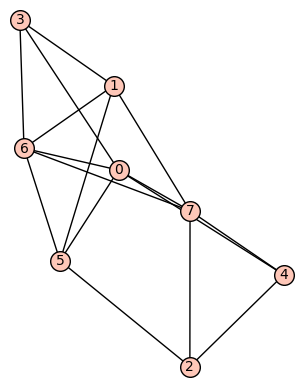

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


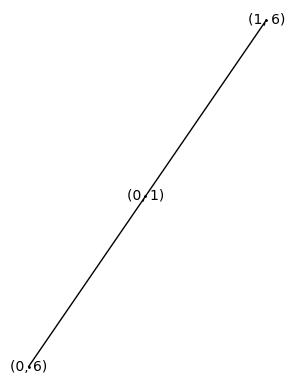

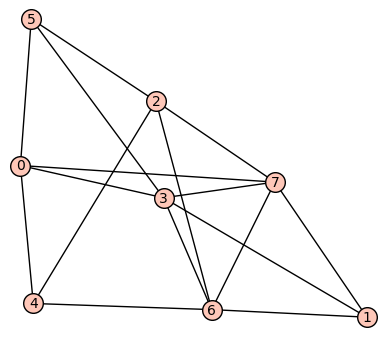

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 3, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (6, 7, None)]


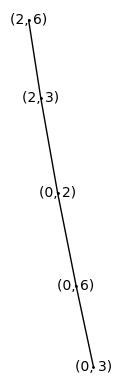

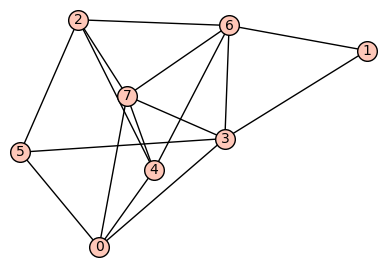

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 3, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (6, 7, None)]


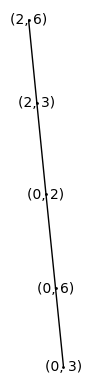

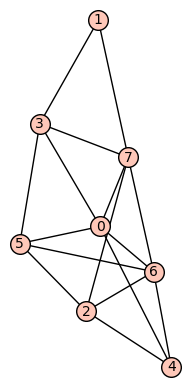

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (5, 6, None), (6, 7, None)]


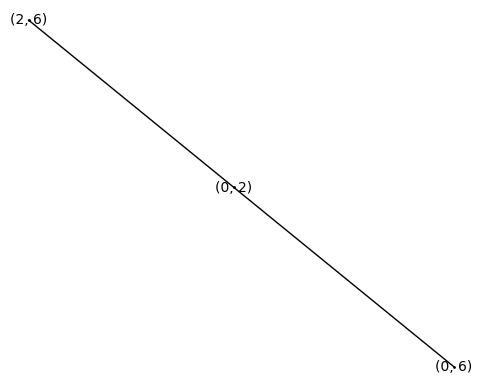

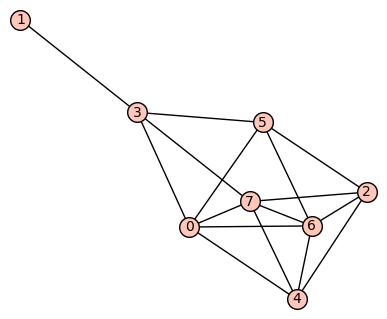

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 6, None), (6, 7, None)]


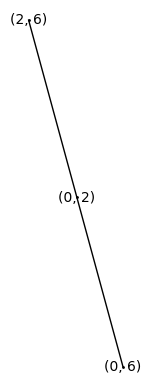

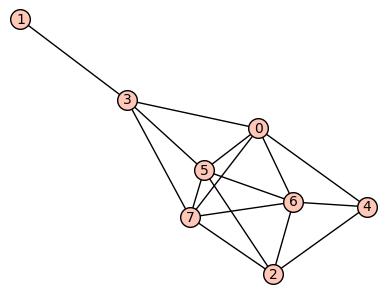

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 6, None), (5, 6, None), (5, 7, None), (6, 7, None)]


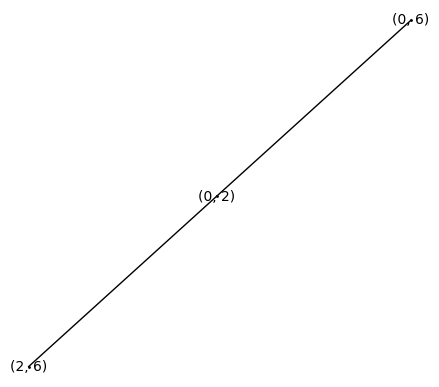

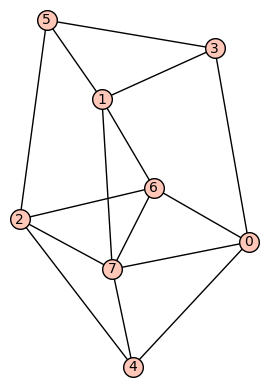

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (4, 7, None), (6, 7, None)]


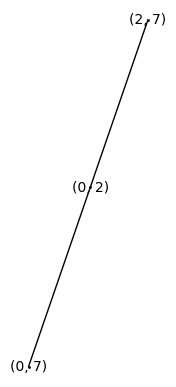

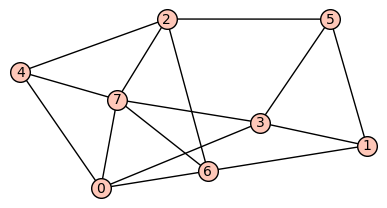

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (6, 7, None)]


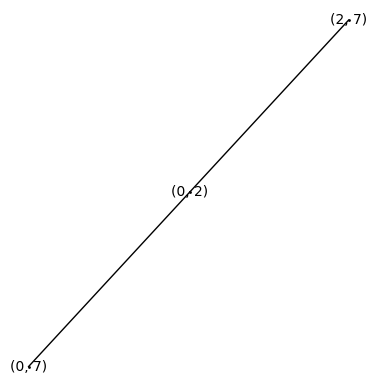

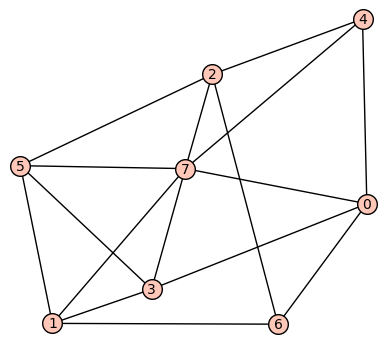

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 7, None)]


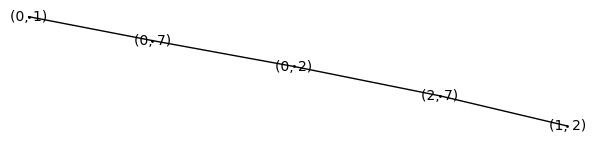

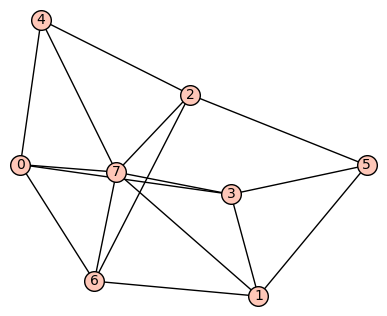

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (6, 7, None)]


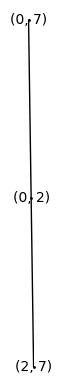

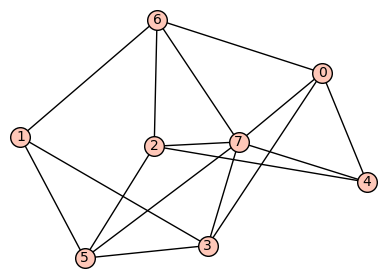

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


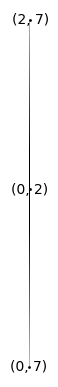

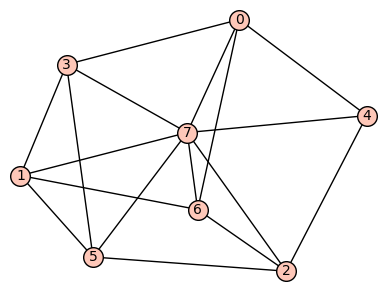

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 7, None), (5, 7, None), (6, 7, None)]


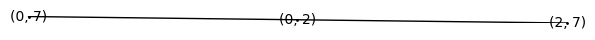

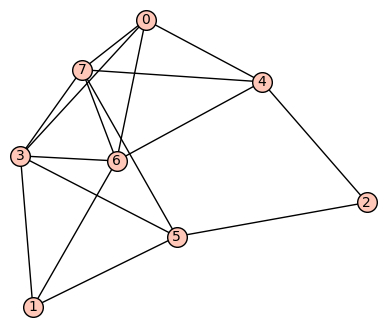

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


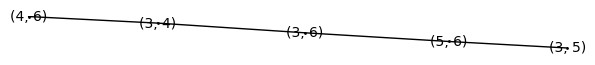

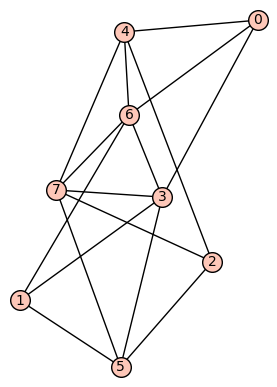

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 6, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 7, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


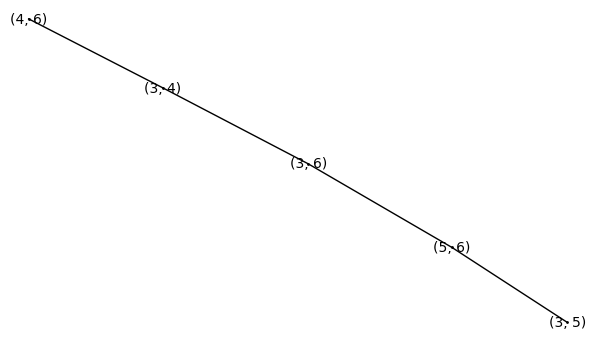

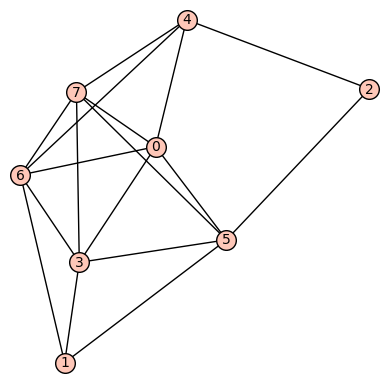

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


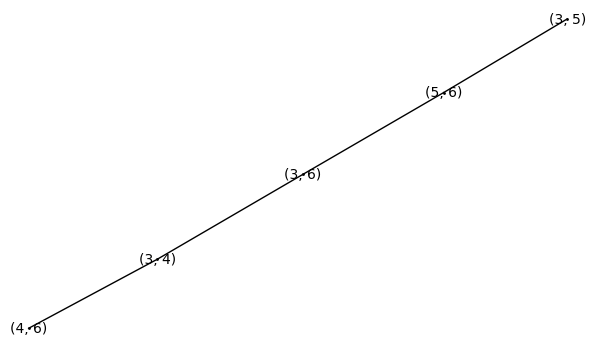

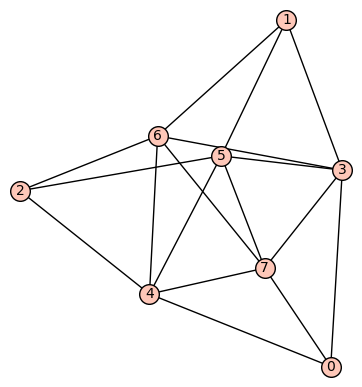

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


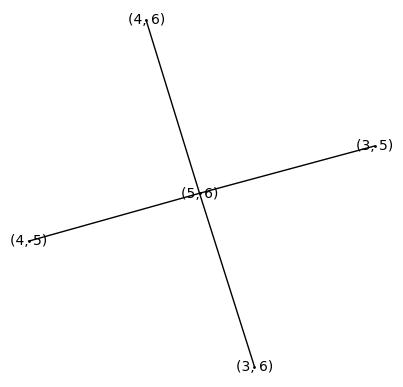

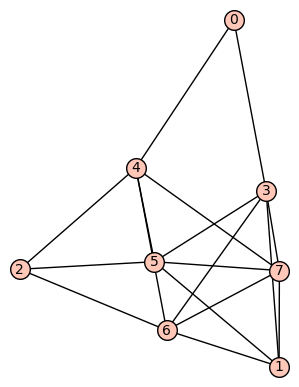

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 5, None), (3, 6, None), (3, 7, None), (4, 5, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


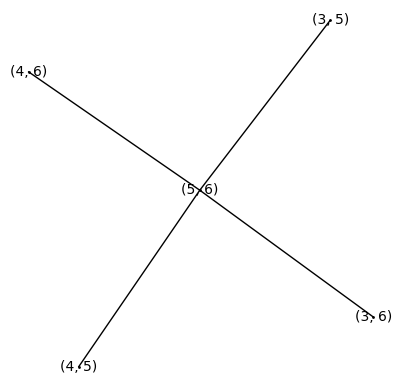

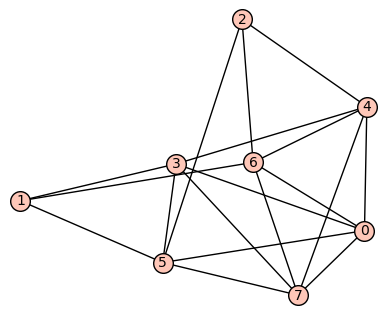

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 3, None), (0, 4, None), (0, 5, None), (0, 6, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (2, 4, None), (2, 5, None), (2, 6, None), (3, 4, None), (3, 5, None), (3, 7, None), (4, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


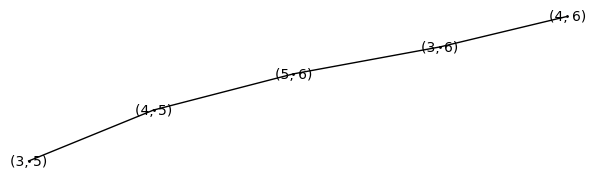

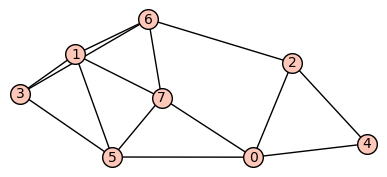

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 2, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None), (5, 7, None), (6, 7, None)]


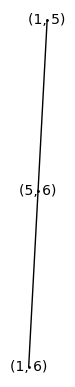

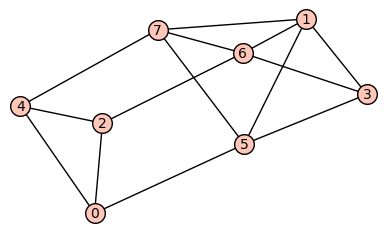

[0, 1, 2, 3, 4, 5, 6, 7] [(0, 2, None), (0, 4, None), (0, 5, None), (1, 3, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 4, None), (2, 6, None), (3, 5, None), (3, 6, None), (4, 7, None), (5, 7, None), (6, 7, None)]


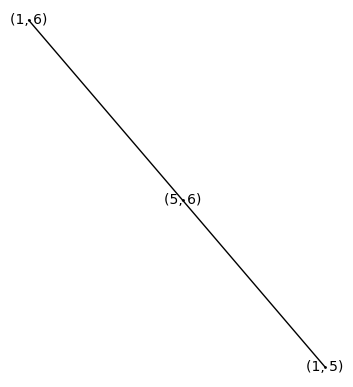

In [38]:
n=8
for g in graphs(n):
    if (ptsk_TSgraph(g,Zskew(g)).is_tree()==True and g.is_connected()==True):
        if (len(ptsk_TSgraph(g,Zskew(g)).vertices())>1):
            g.show()
            print g.vertices(), g.edges()
            ptsk_TSgraph(g,Zskew(g)).plot(vertex_size=1,layout="spring").show()

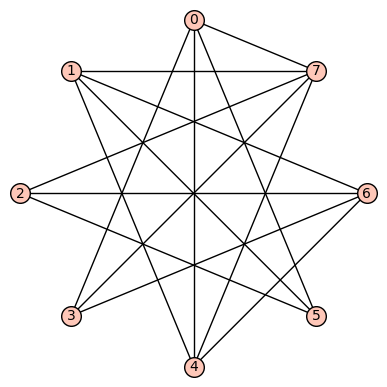

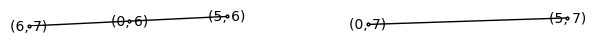

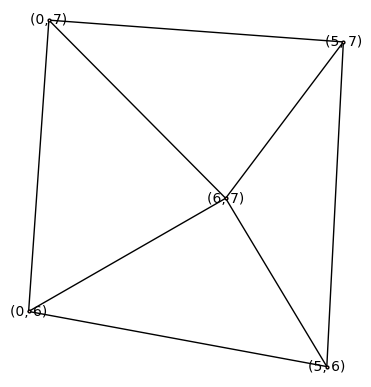

In [37]:
G=Graph([[0, 1, 2, 3, 4, 5, 6, 7] ,[(0, 3, None), (0, 4, None), (0, 5, None), (0, 7, None), (1, 4, None), (1, 5, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 6, None), (3, 7, None), (4, 6, None), (4, 7, None)]])
G.plot(layout='circular').show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=4,layout="spring").show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=4,layout="spring").show()

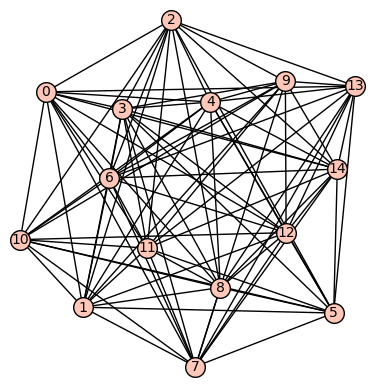

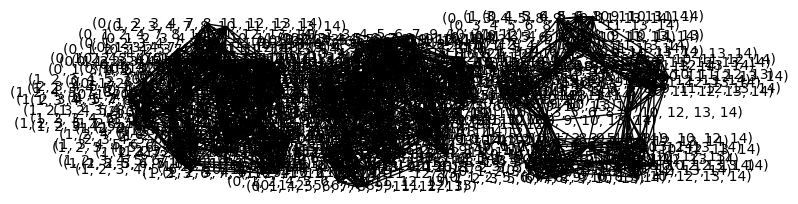

In [31]:
G=graphs.PathGraph(5)
G2=graphs.CycleGraph(5)
H=G.join(G2).join(G)
H.relabel()
H.show()
ptsk_TEgraph(H,Zskew(H)).plot(vertex_size=1).show()

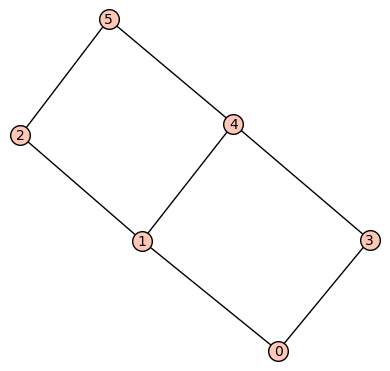

9


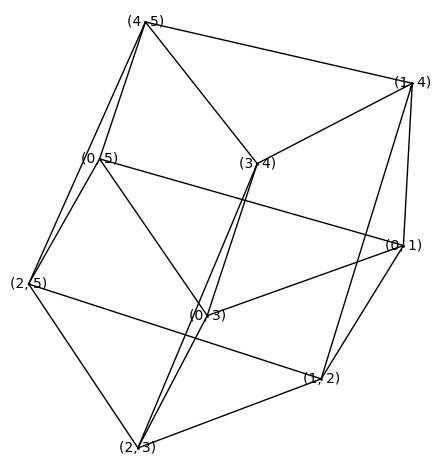

False

In [11]:
g=Graph({0:[1,3],1:[2,4],2:[5],3:[4],4:[5]})
g.show()
ptsk_TEgraph(g,Zskew(g)).plot(vertex_size=1).show()
g.is_tree()

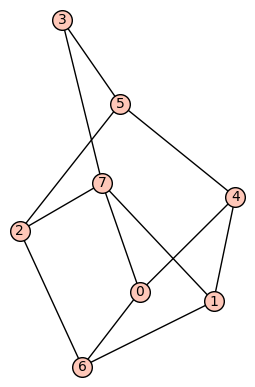

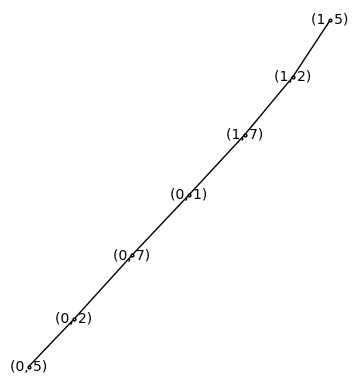

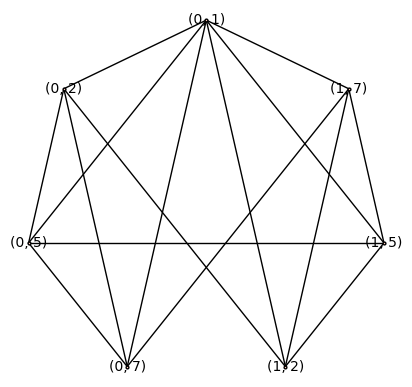

In [41]:
G=Graph([[0, 1, 2, 3, 4, 5, 6, 7], [(0, 4, None), (0, 6, None), (0, 7, None), (1, 4, None), (1, 6, None), (1, 7, None), (2, 5, None), (2, 6, None), (2, 7, None), (3, 5, None), (3, 7, None), (4, 5, None)]])
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=4,layout="spring").show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=4,layout="circular").show()

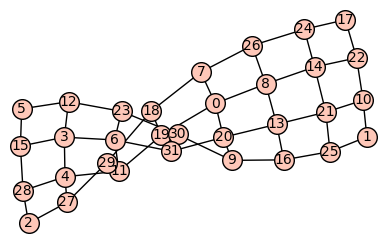

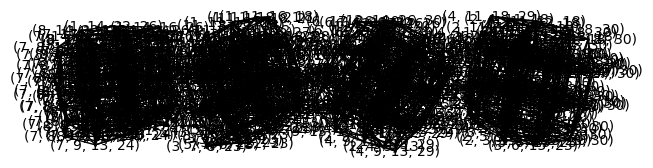

In [29]:
G=graphs.PathGraph(4).cartesian_product(graphs.PathGraph(8))
G.relabel()
G.show()
ptsk_TEgraph(G,Zskew(G)).plot(vertex_size=1,layout="spring").show()

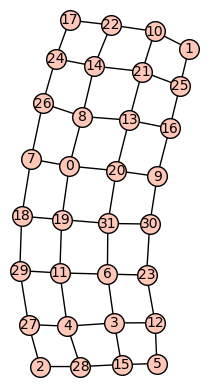

[[(1, 9, 10, 16),
  (1, 9, 10, 21),
  (1, 9, 10, 22),
  (1, 9, 10, 24),
  (1, 9, 13, 16),
  (1, 9, 13, 21),
  (1, 9, 13, 22),
  (1, 9, 13, 24),
  (1, 9, 16, 25),
  (1, 9, 21, 25),
  (1, 9, 22, 25),
  (1, 9, 24, 25),
  (1, 10, 13, 16),
  (1, 10, 13, 21),
  (1, 10, 13, 22),
  (1, 10, 13, 24),
  (1, 10, 14, 16),
  (1, 10, 14, 21),
  (1, 10, 14, 22),
  (1, 10, 14, 24),
  (1, 10, 16, 17),
  (1, 10, 17, 21),
  (1, 10, 17, 22),
  (1, 10, 17, 24),
  (1, 13, 16, 25),
  (1, 13, 21, 25),
  (1, 13, 22, 25),
  (1, 13, 24, 25),
  (1, 14, 16, 17),
  (1, 14, 16, 25),
  (1, 14, 16, 26),
  (1, 14, 17, 21),
  (1, 14, 17, 22),
  (1, 14, 17, 24),
  (1, 14, 21, 25),
  (1, 14, 21, 26),
  (1, 14, 22, 25),
  (1, 14, 22, 26),
  (1, 14, 24, 25),
  (1, 14, 24, 26),
  (1, 16, 17, 25),
  (1, 16, 17, 26),
  (1, 17, 21, 25),
  (1, 17, 21, 26),
  (1, 17, 22, 25),
  (1, 17, 22, 26),
  (1, 17, 24, 25),
  (1, 17, 24, 26),
  (7, 8, 9, 10),
  (7, 8, 9, 13),
  (7, 8, 9, 25),
  (7, 8, 10, 13),
  (7, 8, 10, 14),
  (7, 8, 10, 

In [35]:
G=graphs.PathGraph(4).cartesian_product(graphs.PathGraph(8))
G.relabel()
G.show()
connected_components(ptsk_TEgraph(G,Zskew(G)))

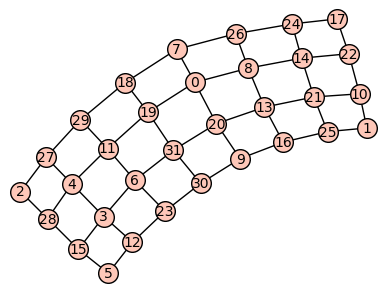

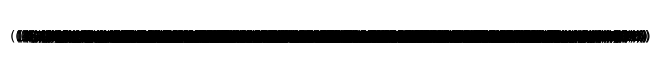

In [26]:
G=graphs.PathGraph(4).cartesian_product(graphs.PathGraph(8))
G.relabel()
G.show()
ptsk_TSgraph(G,Zskew(G)).plot(vertex_size=1,layout="spring").show()

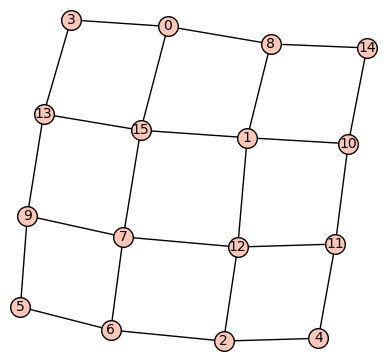

[[(0, 1, 4, 8)],
 [(3, 7, 11, 15)],
 [(5, 7, 8, 12)],
 [(1, 6, 11, 12)],
 [(10, 13, 14, 15)],
 [(5, 7, 8, 15)],
 [(0, 3, 14, 15)],
 [(0, 1, 9, 12)],
 [(7, 9, 13, 15)],
 [(1, 3, 6, 14)],
 [(1, 9, 12, 14)],
 [(0, 1, 9, 15)],
 [(5, 7, 10, 15)],
 [(3, 11, 14, 15)],
 [(1, 4, 8, 11)],
 [(5, 9, 11, 15)],
 [(0, 3, 7, 9)],
 [(5, 6, 13, 15)],
 [(1, 9, 11, 15)],
 [(2, 5, 10, 12)],
 [(1, 3, 11, 15)],
 [(1, 4, 8, 13)],
 [(0, 4, 5, 8)],
 [(4, 5, 7, 10)],
 [(0, 5, 6, 15)],
 [(4, 5, 7, 9)],
 [(0, 3, 5, 8)],
 [(4, 6, 7, 13)],
 [(0, 5, 6, 12)],
 [(1, 9, 12, 13)],
 [(4, 5, 7, 8)],
 [(3, 7, 9, 11)],
 [(2, 7, 10, 12)],
 [(1, 8, 14, 15)],
 [(0, 7, 10, 12)],
 [(4, 5, 10, 13)],
 [(4, 5, 11, 12)],
 [(0, 1, 8, 15)],
 [(2, 6, 7, 15)],
 [(4, 7, 10, 11)],
 [(0, 10, 12, 14)],
 [(0, 4, 9, 14)],
 [(2, 10, 12, 14)],
 [(1, 10, 11, 15)],
 [(0, 6, 12, 14)],
 [(0, 1, 10, 12)],
 [(9, 12, 13, 14)],
 [(2, 4, 8, 14)],
 [(4, 5, 12, 13)],
 [(2, 7, 8, 12)],
 [(4, 5, 6, 11)],
 [(3, 5, 11, 15)],
 [(1, 9, 14, 15)],
 [(1, 3, 14, 15)

In [32]:
G=graphs.PathGraph(4).cartesian_product(graphs.PathGraph(4))
G.relabel()
G.show()
connected_components(ptsk_TSgraph(G,Zskew(G)))